<a href="https://colab.research.google.com/github/kenichinakanishi/houseplant_classifier/blob/master/Part_3_Targeting_and_Removing_Bad_Training_Data.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Imports

In [1]:
# Run once per session
!pip install fastai==2.1.2 -q
!pip install fastcore==1.3.1 -q
!pip install torch==1.7.0 -q
from fastai.basics import *
from fastai.vision.all import *
from fastai.callback.all import *
from fastai.callback.cutmix import *
from fastai.distributed import *
from fastprogress import fastprogress
from torchvision.models import *
from fastai.vision.models.xresnet import *
from fastcore.script import *
fastprogress.MAX_COLS = 80

In [2]:
! nvidia-smi #NVIDIA-SMI 455.32.00 Driver Version: 418.67 CUDA Version: 10.1 Tesla V100-SXM2

Thu Nov 12 07:46:22 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 418.67       Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   51C    P0    40W / 250W |     10MiB / 16280MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----------------------------------------------------------------------------+
| Processes:                                                       GPU Memory |
|  GPU  

In [3]:
torch.cuda.is_available()

True

In [4]:
# memory footprint support libraries/code
!ln -sf /opt/bin/nvidia-smi /usr/bin/nvidia-smi
!pip install gputil
!pip install psutil
!pip install humanize
import psutil
import humanize
import os
import GPUtil as GPU
GPUs = GPU.getGPUs()
# XXX: only one GPU on Colab and isn’t guaranteed
gpu = GPUs[0]
def printm():
 process = psutil.Process(os.getpid())
 print("Gen RAM Free: " + humanize.naturalsize( psutil.virtual_memory().available ), " | Proc size: " + humanize.naturalsize( process.memory_info().rss))
 print("GPU RAM Free: {0:.0f}MB | Used: {1:.0f}MB | Util {2:3.0f}% | Total {3:.0f}MB".format(gpu.memoryFree, gpu.memoryUsed, gpu.memoryUtil*100, gpu.memoryTotal))

# Download and Unzip the File

The use of images directly from a google drive is very slow.
This is because even though the drive appears to be direcly attached to our colab instance, in actuality we are dynamically downloading and accessing each image one by one - leading to extremely long training times. 

At this point, I've gone to the directory the image files were downloaded to, zipped them up and placed that master zip file into my google drive for importing and processing. 

In [6]:
# If your zip file is on your google drive - download it into the current kernel
#!cp '/content/drive/My Drive/Houseplant Classifier/plant_images_deepest_cleaned' 'test' -r

In [7]:
# If your zip file is on your google drive - download it into the current kernel
!cp '/content/drive/My Drive/Houseplant Classifier/plant_images_database_manualcleanedlosses10.zip' 'plant_images_database_manualcleanedlosses10.zip'
# This code snippet unzips a zip file to a specified destination
!unzip "/content/plant_images_database_manualcleanedlosses10.zip" -d "/content";

Archive:  /content/plant_images_database_manualcleanedlosses10.zip
replace /content/plant_images_database_manualcleanedlosses10/Abronia fragrans/00000000.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: 

In [8]:
# If your zip file is on your google drive - download it into the current kernel
!cp '/content/drive/My Drive/Houseplant Classifier/plant_images_database.zip' 'plant_images_database.zip'
# This code snippet unzips a zip file to a specified destination
!unzip "/content/plant_images_database.zip" -d "/content";

^C
Archive:  /content/plant_images_database.zip
  End-of-central-directory signature not found.  Either this file is not
  a zipfile, or it constitutes one disk of a multi-part archive.  In the
  latter case the central directory and zipfile comment will be found on
  the last disk(s) of this archive.
unzip:  cannot find zipfile directory in one of /content/plant_images_database.zip or
        /content/plant_images_database.zip.zip, and cannot find /content/plant_images_database.zip.ZIP, period.


# Model Setup

In [5]:
def random_seed(seed_value, use_cuda):
  '''
  Sets the random seed for numpy, pytorch, python.random and pytorch GPU vars.
  '''
  np.random.seed(seed_value) # Numpy vars
  torch.manual_seed(seed_value) # PyTorch vars
  random.seed(seed_value) # Python
  if use_cuda: # GPU vars
      torch.cuda.manual_seed(seed_value)
      torch.cuda.manual_seed_all(seed_value) 
      torch.backends.cudnn.deterministic = True 
      torch.backends.cudnn.benchmark = False
  print(f'Random state set:{seed_value}, cuda used: {use_cuda}')

In [6]:
@call_parse
def create_path_df(
      path: Param("Path of images to use", str), 
      pct_images: Param("Fraction of images to use", float)=1,
      shuffle: Param("Shuffle prior to splitting", bool)=False,
      ):
  '''
  Creates a dataframe with respective classes and path to images.
  Can return a subset of those images based on the pct_images.
  By default will return the earliest files in the path.

  Returns:
  ----------
  DataFrame
    Returns a dataframe with Class and Path columns. 
  '''
  from sklearn.utils import shuffle as shuff
  data = []
  for folder in sorted(os.listdir(path)):
      num_files = len(sorted(os.listdir(path+'/'+folder)))
      cut_point = int(num_files*pct_images)
      # Takes the first pct_images from each folder
      if shuffle == True:
        for file in shuff(os.listdir(path+'/'+folder))[:cut_point]:
          data.append((folder, path+folder+'/'+file))
      else:
        for file in sorted(os.listdir(path+'/'+folder))[:cut_point]:
          data.append((folder, path+folder+'/'+file))
  df = pd.DataFrame(data, columns=['Class', 'Path'])
  print(f'Creating path:label dataframe from {path}, using {pct_images*100:.2f}% of the images ({len(df)} images.) Shuffle = {shuffle}.')
  return df

In [7]:
@call_parse
def stratified_split(
      dataframe: Param("DataFrame created from create_path_df, containing Class and Path columns."), 
      n_splits: Param("Number of folds in split", int)=5,
      shuffle: Param("Shuffle prior to splitting", bool)=True,
      fold: Param("Which fold to use", int)=0,
      random_state: Param("Fix randomness if shuffle==True", int)=101,
      ):
  ''' 
  Prepares a stratified k-fold split from a dataframe with 'Class' and 'Path' by adding an 'is_valid' column.

  Returns:
  ----------
  DataFrame
    Returns the requested stratified k-fold split by adding an 'is_valid' column. 
  '''
  from sklearn.model_selection import StratifiedKFold
  # Create stratified split using sklearn
  print(f'Preparing stratified {n_splits} fold split, random state is {random_state}. Returning fold {fold}.')
  kf = StratifiedKFold(n_splits=n_splits, shuffle=shuffle, random_state = random_state)
  X, y = dataframe['Path'], dataframe['Class']
  splits = list(kf.split(X, y))
  # Prepare the selected fold
  fold = fold
  train_df = dataframe.loc[splits[fold][0]]
  val_df = dataframe.loc[splits[fold][1]]
  train_df['is_valid'] = False
  val_df['is_valid'] = True
  df_cnn = train_df.append(val_df)
  # Return the selected fold
  return df_cnn

In [8]:
@call_parse
def get_dataloader(
      img_path: Param("Path of images to use", str),
      split_path: Param("Path of images to use to pre-define split", str)=None,
      img_size:  Param("Size in pixels", int)=224,
      pct_images: Param("Fraction of images to use", float)=1,
      bs: Param("Batch size", int)=64,
      deterministic: Param("Deterministic learner", bool)=True,
      randomerasing: Param("Random Erasing", str)=None,
      n_splits: Param("Number of folds in split", int)=5,
      shuffle: Param("Shuffle prior to splitting", bool)=True,
      fold: Param("Which fold to use", int)=0,
      ):
  """ 
  Takes in image path and creates a dataloader. 
  If a split_path is defined, uses the entirety of that path to generate a master split, onto which the img_path is joined to defined a pseudo split.  
      
  Returns:
  ----------
  Dataloader
    dls = data.dataloaders(df_cnn_mini, bs=bs)
  """

  # Get file path and labels from the dataframe we set up.
  get_x = lambda x: x['Path']
  get_y = lambda y: y['Class']
  # Define splitting function that reads from a dataframe column.
  def stratifiedsplitter(df):      
      train = df.index[~df['is_valid']].tolist()
      valid = df.index[df['is_valid']].tolist()
      return train,valid   
  # Prepare transforms
    # Image is larger initially (512 px) for later augmentations.
  item_tfms=[RandomResizedCrop(512, min_scale = 0.7)]
    # Batch transformations include a random resized crop to img_size px. 
  batch_tfms=[*aug_transforms(size=img_size), Normalize.from_stats(*imagenet_stats)]
  # Add in randomerasing if necessary.
  if randomerasing != None:
    batch_tfms=[*aug_transforms(size=img_size), Normalize.from_stats(*imagenet_stats), randomerasing]
  # Prepare DataBlock
  data = DataBlock(blocks=(ImageBlock, CategoryBlock),
                    splitter=stratifiedsplitter,            # Stratified train/validation split
                    get_x=get_x,                            # Get the image path from dataframe
                    get_y=get_y,                            # Label from dataframe
                    item_tfms=item_tfms,                    # Crop images to a square
                    batch_tfms=batch_tfms)                  # Normalize the images based on the imagenet stats
  if split_path != None:
    print('Split Path defined, preparing pseudo stratified split.')
    # Create split_df - a dataframe that defines a master split, based on split_path
    df = create_path_df(split_path, pct_images=1)
    split_df = stratified_split(df, n_splits = 5, shuffle = True, random_state = 101, fold = 0)
    split_df['Path']= split_df['Path'].apply(lambda x:img_path+'/'.join(x.split('/')[-2:]))
    # Inner join this reduced dataframe to the previous splits to maintain the same training images
    df_mini = create_path_df(img_path, pct_images=pct_images)
    df_cnn_mini= df_mini.merge(split_df, how = 'inner', on = ['Class','Path'])
  else: 
    # Create a dataframe based on main image path with a (possibly) reduced number of images
    df = create_path_df(img_path, pct_images=pct_images)
    df_cnn_mini = stratified_split(df, n_splits = 5, shuffle = True, random_state = 101, fold = 0)
  # Print some information for a sanity check
  dls = data.dataloaders(df_cnn_mini, bs=bs)
  print(f'We have {dls.c} classes, with a training set of size {len(dls.train_ds)}, and a validation set of size {len(dls.valid_ds)}')
  if split_path != None:
    print(f"The main split has {split_df['is_valid'].describe()['freq']/len(split_df['is_valid'])*100:.2f}% training data with {len(split_df.groupby('Class').count())} classes, the reduced split has {df_cnn_mini['is_valid'].describe()['freq']/len(df_cnn_mini['is_valid'])*100:.2f} % training data, with {len(df_cnn_mini.groupby('Class').count())} classes.")
  return dls

In [9]:
@call_parse
def create_simple_cnn_learner(
        size:  Param("Size", int)=224,
        bs:    Param("Batch size", int)=64,
        arch:  Param("Architecture", str)='resnet34',
        fp16:  Param("Use mixed precision training", int)=0,
        deterministic: Param("Deterministic learner", bool)=True,
        pretrained: Param("Pretrained architecture", bool)=True,
        pct_images: Param("Percent of images to sue", float)=1,
        img_path: Param("Path of images to use", str)='/content/plant_images_database_manualcleanedlosses10/',
        split_path: Param("Path of images to use to pre-define split", str)=None,
        model_dir: Param("Path to save model", str)='/content/drive/My Drive/Houseplant Classifier/Models/',
        log_name: Param("Name of csv training log", str)='history.csv',
        splitter: Param("Custom splitter", str)=None,
        ):
    # Select optimization function
    opt_func = partial(Adam, mom=0.9, sqr_mom=0.99, eps=1e-05, wd=0.01, decouple_wd=True)
    # Set Random Seed
    if deterministic == True:
      random_seed(101,True)
    # Get Dataloader
    dls = get_dataloader(img_size = size, bs = bs, img_path=img_path, split_path=split_path, pct_images=pct_images)
    # Setup activation function and pooling
    model = globals()[arch] 
    # Setup callbacks
    callbacks = [CSVLogger(fname=log_name, append=True), ShowGraphCallback()]
    # Setup Learner
    learn = cnn_learner(dls, 
                        model, 
                        splitter=splitter,
                        pretrained=pretrained,
                        opt_func=opt_func,
                        metrics=[accuracy,top_k_accuracy], 
                        model_dir = model_dir,
                        cbs=callbacks,
                        )
    if fp16: learn = learn.to_fp16()

    return learn

In [10]:
# Import source of efficientnet models and weights
!pip install geffnet -q
from geffnet import *

@call_parse
def create_cnn_learner(
        size:  Param("Size", int)=224,
        bs:    Param("Batch size", int)=64,
        opt:   Param("Optimizer (adam,rms,sgd,ranger)", str)='adam',
        arch:  Param("Architecture", str)='resnet34',
        fp16:  Param("Use mixed precision training", int)=0,
        deterministic: Param("Deterministic learner", bool)=True,
        pretrained: Param("Pretrained architecture", bool)=True,
        pct_images: Param("Percent of images to sue", float)=1,
        img_path: Param("Path of images to use", str)='/content/plant_images_database_manualcleanedlosses10/',
        split_path: Param("Path of images to use to pre-define split", str)=None,
        model_dir: Param("Path to save model", str)='/content/drive/My Drive/Houseplant Classifier/Models/',
        log_name: Param("Name of csv training log", str)='history.csv',
        splitter: Param("Custom splitter", str)=None,
        sa: Param("Self Attention for XResNet", bool)=False,
        act_cls: Param("Activation class to use", str)='ReLU',
        loss_func: Param("Learner loss function", str)=None,
        mixup: Param("Mixup", str)=None,
        cutmix: Param("Cutmix", str)=None,
        randomerasing: Param("Random Erasing", str)=None,
        ):
    # Select optimization function
    if   opt=='adam'  : opt_func = partial(Adam, mom=0.9, sqr_mom=0.99, eps=1e-05, wd=0.01, decouple_wd=True)
    elif opt=='rms'   : opt_func = partial(RMSprop, sqr_mom=0.99, mom=0.0, wd=0.0, decouple_wd=True)
    elif opt=='sgd'   : opt_func = partial(SGD, mom=0.0, wd=0.0, decouple_wd=True)
    elif opt=='ranger': opt_func = partial(ranger, mom=0.95, wd=0.01, eps=1e-06, sqr_mom=0.99, beta=0.0, decouple_wd=True)
    # Get DataLoader
    if deterministic == True:
      random_seed(101,True)
    # Implement RandomErasing
    if randomerasing != None:
      dls = get_dataloader(img_size = size, bs = bs, img_path=img_path, split_path=split_path, pct_images=pct_images, randomerasing=randomerasing)
    else: 
      dls = get_dataloader(img_size = size, bs = bs, img_path=img_path, split_path=split_path, pct_images=pct_images)
    # Setup activation function and pooling
    model = globals()[arch] 
    if ('xresnet' in arch) and act_cls != 'ReLU':
      model = partial(model, act_cls=act_cls, sa=sa, n_out=dls.c)
    elif 'xresnet' in arch:
      model = partial(model, sa=sa, n_out=dls.c)
    elif ('tf_efficientnet' in arch) and act_cls == 'Mish':
      # Change all SwishJit() to Mish() and return an nn.Sequential()
      def effmish(model=model, pretrained=pretrained):
        model = model(pretrained=pretrained)
        model.act1 = Mish()
        model.act2 = Mish()
        for i in range(len(model.blocks)):
          for j in range(len(model.blocks[i])):
            if str(model.blocks[i][j].act1) == 'SwishJit()':
              model.blocks[i][j].act1 = Mish()
            if str(model.blocks[i][j].act2) == 'SwishJit()':
              model.blocks[i][j].act2 = Mish()
            if str(model.blocks[i][j].se.act1) == 'SwishJit()':
              model.blocks[i][j].se.act1 = Mish()
        return nn.Sequential(*model.children())
      model = effmish
    # Setup callbacks
    callbacks = [CSVLogger(fname=log_name, append=True), ShowGraphCallback()]
    if mixup != None:
      mixup = mixup
      callbacks = [CSVLogger(fname=log_name, append=True), ShowGraphCallback(), mixup]
    elif cutmix != None:
      cutmix = cutmix
      callbacks = [CSVLogger(fname=log_name, append=True), ShowGraphCallback(), cutmix]
    # Setup Learner
    learn = cnn_learner(dls, 
                        model, 
                        splitter=splitter,
                        pretrained=pretrained,
                        opt_func=opt_func,
                        metrics=[accuracy,top_k_accuracy], 
                        model_dir = model_dir,
                        loss_func = loss_func,
                        cbs=callbacks,
                        )
    if fp16: learn = learn.to_fp16()

    return learn

In [11]:
def enumerate_params(learner):
  '''
  Enumerates the unfrozen and frozen parameters for a given learner when called.
  '''
  total_params = sum(p.numel() for p in learner.model.parameters())
  print(f'{total_params:,} total parameters.')
  total_trainable_params = sum(
  p.numel() for p in learner.model.parameters() if p.requires_grad)
  print(f'{total_trainable_params:,} training parameters.')

# Interpretation - 150 Images

Let's re-create the learner and load in the results of training. 

In [ ]:
learn = create_simple_cnn_learner(pct_images=1, 
                           deterministic=True, 
                           size=224, 
                           img_path ='/content/plant_image_database/',
                           split_path = '/content/plant_image_database/',
                           log_name = '150baseline.csv')

Random state set:101, cuda used: True
Split Path defined, preparing pseudo stratified split.
Creating path:label dataframe from /content/plant_image_database/, using 100.00% of the images (77700 images.) Shuffle = False.
Preparing stratified 5 fold split, random state is 101. Returning fold 0.
Creating path:label dataframe from /content/plant_image_database/, using 100.00% of the images (77700 images.) Shuffle = False.
We have 518 classes, with a training set of size 62160, and a validation set of size 15540
The main split has 80.00% training data with 518 classes, the reduced split has 80.00 % training data, with 518 classes.


In [ ]:
learn.load('/content/drive/My Drive/Houseplant Classifier/Models/stage-2-150images');

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)

In [ ]:
# This will crash the kernel
#interp.plot_confusion_matrix()

In [ ]:
# This will often crash the kernel
# What classes were confused with each other most frequently, min_val is the minimum number of times confused
# If the model fails to predict a class, this method will throw an error.
  # This can happen if you create a dataloader with insufficient data, or if significant class confusion (e.g. due to mislabelling)
interp.most_confused(min_val = 20)

A confusion matrix is of limited use with so many categories. Indeed, we will crash the kernel trying to plot out such a dense confusion matrix. Luckily, fast.ai has a useful plot_top_losses method that shows us some of the images that suprised the model the most (leading to the largest losses). 

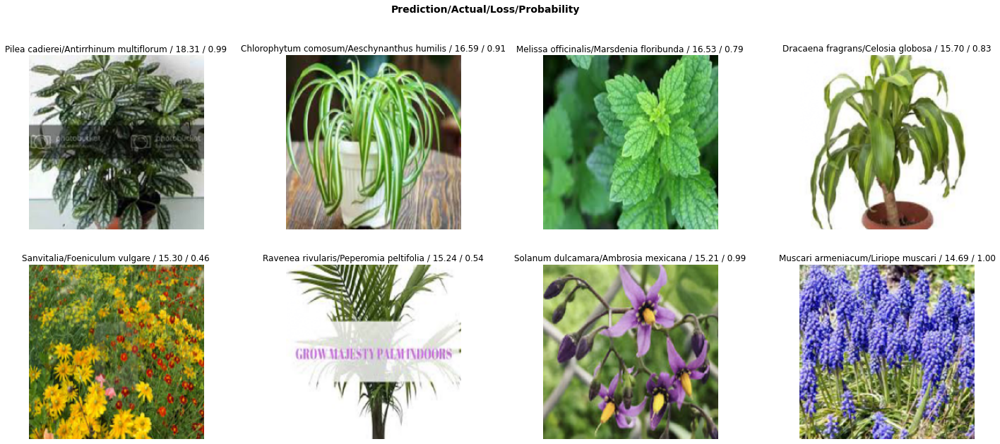

In [ ]:
interp.plot_top_losses(8, figsize=(25,10))

We can see that many of these image labels are simply incorrect. 
A classification report detailing the F1 score for each class can help us identify classes that the model is struggling with. As fastai will print out the classification report, we should intercept this with a Jupyter magic command, and read that input back into a dataframe for interpretation.

In [ ]:
# Use a jupyter magic command to capture the print output from the classification report
%%capture cap_out --no-stderr
interp.print_classification_report()

In [ ]:
classification_report = cap_out.stdout

from itertools import groupby
class_report = pd.DataFrame([])
def split_text(s):
    for k, g in groupby(s, str.isnumeric):
        yield ''.join(g)

report = []
for item in classification_report.split('\n'):
  report.append(split_text(item))

report = pd.DataFrame(report).copy()
class_report = pd.DataFrame([])
class_report['Class'] = pd.DataFrame(report).iloc[2:learn.dl.c+2,0]
class_report['Precision'] = pd.DataFrame(report).iloc[2:learn.dl.c+2,3].apply(lambda x:int(x)/100)
class_report['Recall'] = pd.DataFrame(report).iloc[2:learn.dl.c+2,7].apply(lambda x:int(x)/100)
class_report['F1 Score'] = pd.DataFrame(report).iloc[2:learn.dl.c+2,11].apply(lambda x:int(x)/100)
class_report['Support'] = pd.DataFrame(report).iloc[2:learn.dl.c+2,13]

In [ ]:
class_report.sort_values('F1 Score')

,Class,Precision,Recall,F1 Score,Support
190,Dracaena,0.00,0.00,0.00,30
376,Peperomia peltifolia,0.17,0.03,0.06,30
505,Tripogandra multiflora,0.20,0.03,0.06,30
363,Origanum vulgare subsp. hirtum,0.10,0.07,0.08,30
429,Rajania hastata,0.08,0.27,0.12,30
...,...,...,...,...,...
275,Hydrangea arborescens,0.87,0.90,0.89,30
146,Crossandra,0.87,0.90,0.89,30
67,Caesalpinia gilliesii,0.90,0.90,0.90,30
287,Iris domestica,0.93,0.90,0.92,30


With this, we can see at a glance which classes have the most problems being identified, and have a closer look at the images in their folders.

There are 8 classes with F1 scores below 0.20


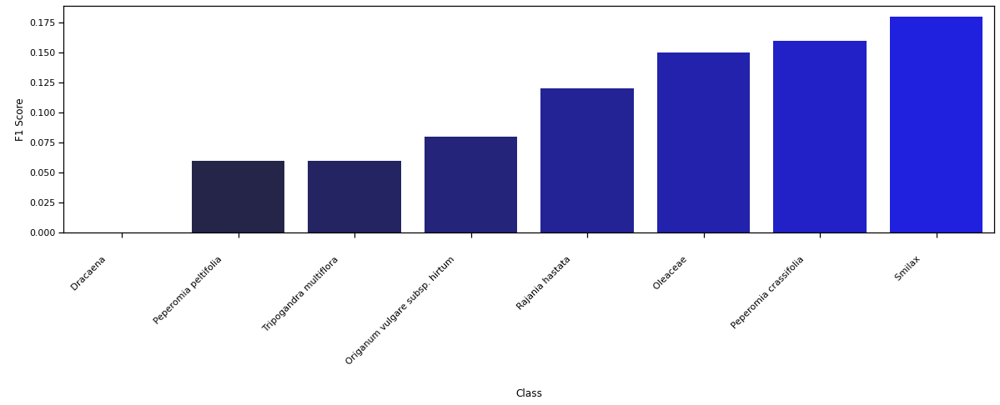

In [ ]:
import seaborn as sns
sns.set_context("notebook")
ordered_fscore = class_report[class_report['F1 Score']<0.2].sort_values('F1 Score')
fig, ax = plt.subplots(figsize=(20,5))
sequential_colors = sns.dark_palette('blue', len(ordered_fscore))
chart = sns.barplot(ax=ax, x=ordered_fscore['Class'], y=ordered_fscore['F1 Score'], palette = sequential_colors);
chart.set_xticklabels(chart.get_xticklabels(), rotation=45, horizontalalignment='right');
print(f'There are {len(ordered_fscore)} classes with F1 scores below 0.20')


There are 67 classes with F1 scores more than 0.80


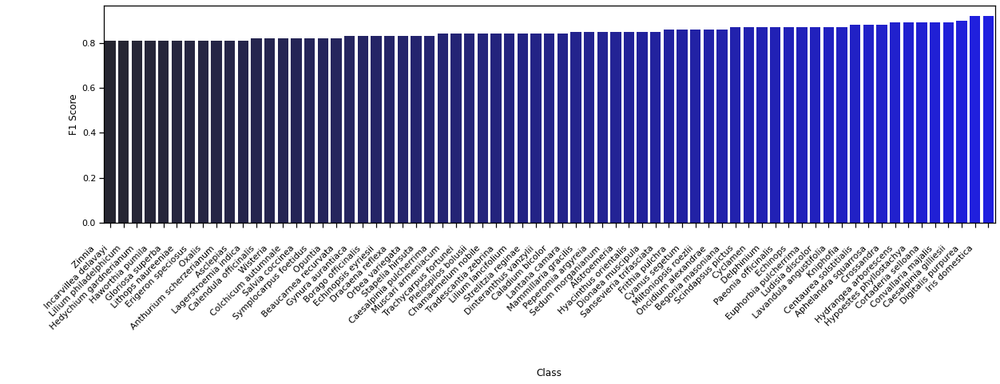

In [ ]:
import seaborn as sns
ordered_fscore = class_report[class_report['F1 Score']>0.8].sort_values('F1 Score')
fig, ax = plt.subplots(figsize=(20,5))
sequential_colors = sns.dark_palette('blue', len(ordered_fscore))
chart = sns.barplot(ax=ax, x=ordered_fscore['Class'], y=ordered_fscore['F1 Score'], palette = sequential_colors);
chart.set_xticklabels(chart.get_xticklabels(), rotation=45, horizontalalignment='right');
print(f'There are {len(ordered_fscore)} classes with F1 scores more than 0.80')

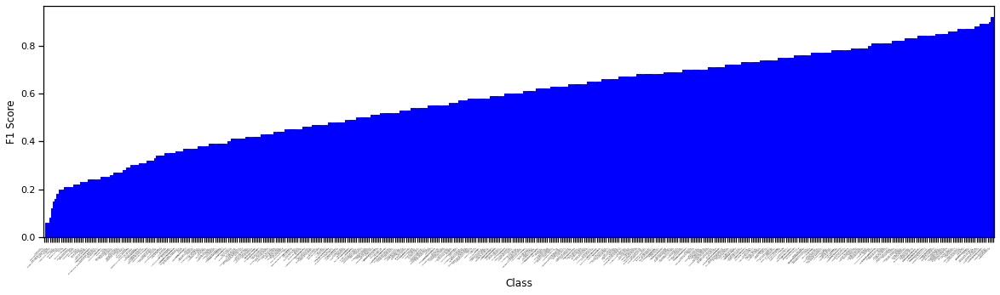

In [ ]:
import seaborn as sns
sns.set_palette("dark")
ordered_fscore = class_report[class_report['F1 Score']>=0].sort_values('F1 Score')
fig, ax = plt.subplots(figsize=(20,5))
sequential_colors = sns.dark_palette('blue', len(ordered_fscore))
chart = sns.barplot(ax=ax, x=ordered_fscore['Class'], y=ordered_fscore['F1 Score']);
chart.set_xticklabels(chart.get_xticklabels(), rotation=45, horizontalalignment='right', fontsize=2);
for i, bar in enumerate(ax.patches):
    bar.set_color("blue")
    
plt.savefig('all.png', dpi=1200)

# Plot to examine images with artificial components

In [3]:
# Lets look in a folder and grab a file
local_path = Path('/content/plant_image_database')
img_folder = local_path/'Peperomia peltifolia'
img_list = list(sorted(img_folder.ls()))
img_folder.ls()

(#150) [Path('/content/plant_image_database/Peperomia peltifolia/00000027.jpg'),Path('/content/plant_image_database/Peperomia peltifolia/00000113.jpg'),Path('/content/plant_image_database/Peperomia peltifolia/00000270.jpg'),Path('/content/plant_image_database/Peperomia peltifolia/00000109.jpg'),Path('/content/plant_image_database/Peperomia peltifolia/00000035.jpg'),Path('/content/plant_image_database/Peperomia peltifolia/00000269.jpg'),Path('/content/plant_image_database/Peperomia peltifolia/00000267.jpg'),Path('/content/plant_image_database/Peperomia peltifolia/00000245.jpg'),Path('/content/plant_image_database/Peperomia peltifolia/00000424.jpg'),Path('/content/plant_image_database/Peperomia peltifolia/00000263.jpg')...]

As expected, the folder contains 150 images. Let's take a look at an early search result vs. a later one.


In [4]:
def plot_images(img1,
                img2=None,
                img3=None,
                img4=None):
  """ Plots raw images of interest, along with file name.

  Parameters
  ----------
  img: Path or str
    Image to show.
    
  Returns:
  ----------
  Plot of images.
  """
  # prepare images
  raw_image1 = Image.open(img1)
  fig = plt.figure(figsize=(12,5))
  fig.set_facecolor("white")
  ax = plt.subplot2grid((2,8), (0,0), colspan=2, rowspan=2)
  ax.imshow(raw_image1)  
  ax.title.set_text(f'Raw Image: {img1.name}')
  if img2 is not None:
    raw_image2 = Image.open(img2)
    ax2 = plt.subplot2grid((2,8), (0,2), colspan=2, rowspan=2)
    ax2.imshow(raw_image2)  
    ax2.title.set_text(f'Raw Image: {img2.name}')
  if img3 is not None:
    raw_image3 = Image.open(img3)
    ax3 = plt.subplot2grid((2,8), (0,4), colspan=2, rowspan=2)
    ax3.imshow(raw_image3)  
    ax3.title.set_text(f'Raw Image: {img3.name}')
  if img4 is not None:
    raw_image4 = Image.open(img4)
    ax4 = plt.subplot2grid((2,8), (0,6), colspan=2, rowspan=2)
    ax4.imshow(raw_image4)  
    ax4.title.set_text(f'Raw Image: {img4.name}')
  plt.tight_layout()
  plt.show()

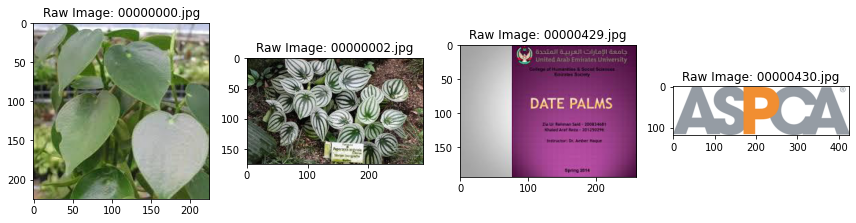

In [5]:
plot_images(img_list[0],img_list[2],img_list[145],img_list[146])

Interesting. Later search results are less relevant to the key search terms we put in, and can result in things like drawings, graphs and fact sheets - which are all bad at training our model to do what we want it to do (classify a plant based on a natural photo.)

We'd like to do some cleaning up of these images without having to manually examine each of the files in the 500+ folders. 

# Cleaning Stage 1 - Text recognition

The first filtering step we will try is to use optical character recognition (OCR) to try to find text in each of our documents. Tesseract is open-source software available for OCR that is simple to implement. We can use this to look for text, and try to crop out the text if it is along the edges, preventing data leakage or simply remove the image (removing bad training examples).

In [6]:
!sudo apt install tesseract-ocr -q
!pip install pytesseract -q

Reading package lists...
Building dependency tree...
Reading state information...
The following additional packages will be installed:
  tesseract-ocr-eng tesseract-ocr-osd
The following NEW packages will be installed:
  tesseract-ocr tesseract-ocr-eng tesseract-ocr-osd
0 upgraded, 3 newly installed, 0 to remove and 12 not upgraded.
Need to get 4,795 kB of archives.
After this operation, 15.8 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 tesseract-ocr-eng all 4.00~git24-0e00fe6-1.2 [1,588 kB]
Get:2 http://archive.ubuntu.com/ubuntu bionic/universe amd64 tesseract-ocr-osd all 4.00~git24-0e00fe6-1.2 [2,989 kB]
Get:3 http://archive.ubuntu.com/ubuntu bionic/universe amd64 tesseract-ocr amd64 4.00~git2288-10f4998a-2 [218 kB]
Fetched 4,795 kB in 3s (1,729 kB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debconf/Fron

In [7]:
!sudo apt install tesseract-ocr -q
!pip install pytesseract -q
import pytesseract

def optical_character_recognition(file, path = True):
  """ Simple OCR of text from images.

  Parameters
  ----------
  file: Path or str
    Image to examine.
  path: bool
    Indicates whether the file passed in is a path to a file, or an already opened Pillow Image.
    
  Returns:
  ----------
  str
    Text that was detected.
  """
  if path == True:
    # Use Pillow's Image class to open the image
    img = Image.open(file)
    new_size = tuple(2*x for x in img.size)
    img = img.resize(new_size, Image.ANTIALIAS)
    img = img.convert('L')
    text = pytesseract.image_to_string(img, lang='eng', config='-c tessedit_char_whitelist=01234567890ABCDEFGHIJKLMNOPQRSTUVWXYZabcdefghijklmnopqrstuvwxyz --psm 3 --oem 3')
    # Remove '\n\x0c' whiich is found in every image
    text = text[:-3]
  else: 
    # Already opened with Pillow
    new_size = tuple(2*x for x in file.size)
    img = file.resize(new_size, Image.ANTIALIAS)
    img = img.convert('L')
    text = pytesseract.image_to_string(file, lang='eng', config='-c tessedit_char_whitelist=01234567890ABCDEFGHIJKLMNOPQRSTUVWXYZabcdefghijklmnopqrstuvwxyz --psm 3 --oem 3')
    # Remove '\n\x0c' whiich is found in every image
    text = text[:-3]

  return text

Reading package lists...
Building dependency tree...
Reading state information...
tesseract-ocr is already the newest version (4.00~git2288-10f4998a-2).
0 upgraded, 0 newly installed, 0 to remove and 12 not upgraded.


### Cropping to preserve images with border text

Some images have text around the edges, which should be removed to prevent possible data leakage. 

In [8]:
def crop_image(img_path, crop_pct = 0.1):
  """ Crops an image by a certain percent of the image size along the top and bottom of the image.

  Parameters
  ----------
  img_folder: Path or str
    Fold with images to examine.
  crop_pct: float (0<crop_pct<1)
    Percentage of the total height of the image to crop off top and bottom.
    
  Returns:
  ----------
  Cropped image (opened in PIL).
  """
  from PIL import Image
  img_file = Image.open(img_path).convert('RGB')
  [xs,ys] = img_file.size
  crop_x = crop_pct*xs
  crop_y = crop_pct*ys
  box = (0, crop_y, xs, ys-crop_y)
  cropped_image = img_file.crop(box)
  return cropped_image

In [9]:
def find_artificial_text(img_folder, edge_removal = True, verbose = False):
  """ Searches for artificial text in each image in a image folder using pytesseract.

  Parameters
  ----------
  img_folder: Path or str
    Folder with images to examine.
  edge_removal: bool
    Should the function attempt to crop the edges of the to remove detected text.
    If no text is found, the cropped image is saved.
  verbose: bool
    Should the function print out which images are cropped, and which images have been found to have text.  
    
  Returns:
  ----------
  DataFrame containing images marked as possessing artifical text. 
  """
  from tqdm.notebook import tqdm
  # Initialize DataFrame
  column_names = ['Artificial Images', 'Text Found']
  df_mt = pd.DataFrame(columns = column_names)
  for image_path in tqdm(sorted(img_folder.ls())):
    im = Image.open(image_path).convert('RGB')
    if edge_removal == True:
      # if the image has text
      if len(optical_character_recognition(im, path = False))>0:
        if verbose == True:print(f'Text detected in image {image_path.name}');
        # if the text is along the top or bottom edge, overwrite the old image else make note of it in a dataframe
        if len(optical_character_recognition((crop_image(image_path)).convert('RGB'), path = False)) == 0:
          if verbose == True:print(f'Cropping removed text in image {image_path.name}');
          crop_image(image_path).save(image_path)
        else:
          df_mt = df_mt.append({'Artificial Images':image_path,'Text Found':optical_character_recognition(image_path)}, ignore_index=True)
    # No cropping      
    else:
      if len(optical_character_recognition(im, path=False))>0:
        if verbose==True:print(f'Text detected in image {image_path.name}');
        df_mt = df_mt.append({'Artificial Images':image_path,'Text Found':optical_character_recognition(image_path)}, ignore_index=True)

  # Create dataframe containing images with artificial text towards the center
  if verbose == True:print(f'{len(df_mt)} images with text found in folder {img_folder}.');
  return df_mt

## Test OCR Clean

### Lilium longiflorum




In [10]:
# Lets look in a folder and grab a file
local_path = Path('/content/plant_image_database')
img_folder = local_path/'Lilium longiflorum'
df_artificial = find_artificial_text(img_folder, edge_removal = False, verbose = True)

Text detected in image 00000016.jpg
Text detected in image 00000031.jpg
Text detected in image 00000119.jpg
Text detected in image 00000129.jpg
Text detected in image 00000137.jpg
Text detected in image 00000256.jpg
Text detected in image 00000265.jpg
Text detected in image 00000271.jpg
Text detected in image 00000279.jpg
Text detected in image 00000280.jpg
Text detected in image 00000283.jpg
Text detected in image 00000430.jpg

12 images with text found in folder /content/plant_image_database/Lilium longiflorum.


In [11]:
df_artificial

,Artificial Images,Text Found
0,/content/plant_image_database/Lilium longiflorum/00000016.jpg,"\n\n| a\neames\n7) , 0 l"
1,/content/plant_image_database/Lilium longiflorum/00000031.jpg,ae 3\n\n
2,/content/plant_image_database/Lilium longiflorum/00000119.jpg,
3,/content/plant_image_database/Lilium longiflorum/00000129.jpg,
4,/content/plant_image_database/Lilium longiflorum/00000137.jpg,
5,/content/plant_image_database/Lilium longiflorum/00000256.jpg,
6,/content/plant_image_database/Lilium longiflorum/00000265.jpg,\n\n \n\nBI alamy stock phot
7,/content/plant_image_database/Lilium longiflorum/00000271.jpg,\n\n. 5 BULBS\n\nLILIUM LONGIFLORUM\n\nWHITE HEAVE
8,/content/plant_image_database/Lilium longiflorum/00000279.jpg,
9,/content/plant_image_database/Lilium longiflorum/00000280.jpg,


Next we prepare a way to plot texts and images next to each other for a quick visual assessment.

In [12]:
def plot_images_text(dataframe, show_n = 5):
  """ Takes in the output DataFrame from find_artificial_text and shows the associated image and text.

  Parameters
  ----------
  dataframe: DataFrame
    DataFrame with Artificial Images and Text Found columns, indicating which images were found to contain what text.
  show_n: int
    How many images (and the detected text) to show.

  Returns:
  ----------
  Plots of raw images and detected text
  """
  n_images = len(dataframe)
  height = n_images//5*2+2
  fig = plt.figure(figsize=(30,height*3))
  fig.set_facecolor("white")
  for i in range(show_n):
    a = i%5
    b = i//5
    # prepare images
    img = dataframe.iloc[i]['Artificial Images']
    txt = dataframe.iloc[i]['Text Found']
    # plot images
    ax = plt.subplot2grid((height,15), (b*2,a*3), colspan=2, rowspan=2)
    ax.imshow(Image.open(img))  
    ax.title.set_text(f'Image File: {repr(img.name)} \n Text Found: {repr(txt)}')

  plt.tight_layout()
  plt.show()

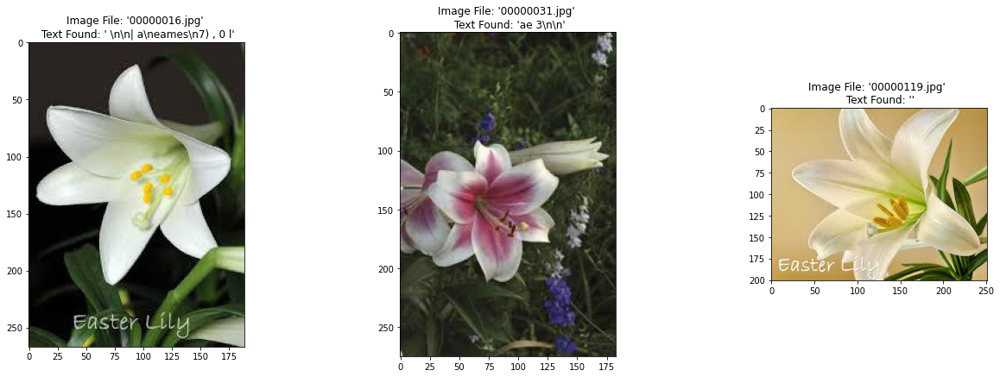

In [13]:
# We can visualize some of these images with artificial components
plot_images_text(df_artificial, show_n = 3)

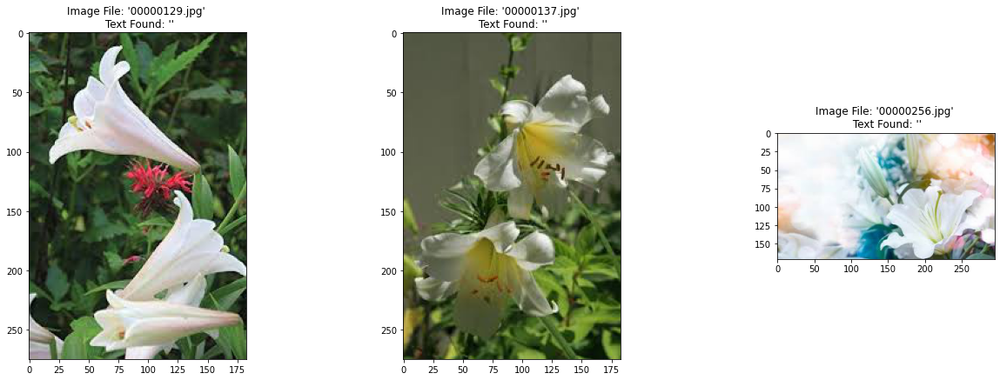

In [14]:
# We can visualize some of these images with artificial components
plot_images_text(df_artificial[3:], show_n = 3)

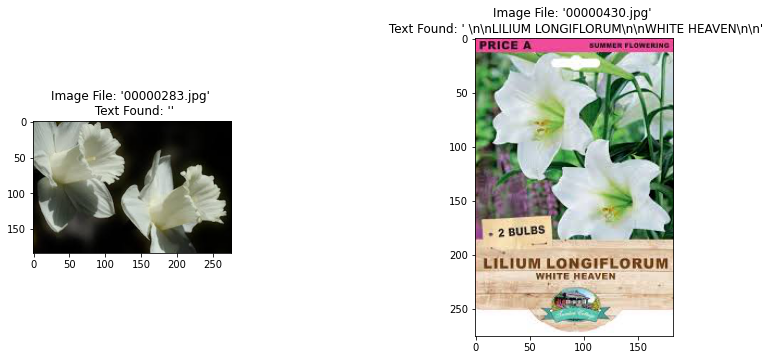

In [15]:
# We can visualize some of these images with artificial components
plot_images_text(df_artificial[10:], show_n = 2)

However, many false positives will exist - so further filtering is necessary.

### Peperomia peltifolia

In [16]:
# Lets look in a folder and grab a file
local_path = Path('/content/plant_image_database')
img_folder = local_path/'Peperomia peltifolia'
df_artificial = find_artificial_text(img_folder, edge_removal = True, verbose = True)

Text detected in image 00000026.jpg
Text detected in image 00000048.jpg
Cropping removed text in image 00000048.jpg
Text detected in image 00000110.jpg
Text detected in image 00000133.jpg
Text detected in image 00000142.jpg
Text detected in image 00000146.jpg
Text detected in image 00000252.jpg
Text detected in image 00000253.jpg
Text detected in image 00000262.jpg
Text detected in image 00000272.jpg
Text detected in image 00000282.jpg
Text detected in image 00000420.jpg
Cropping removed text in image 00000420.jpg
Text detected in image 00000429.jpg

11 images with text found in folder /content/plant_image_database/Peperomia peltifolia.


In [17]:
df_artificial

,Artificial Images,Text Found
0,/content/plant_image_database/Peperomia peltifolia/00000026.jpg,"\n\nwil Tivcbke Wiebe I STIS\na eecaceg\n\n \n\nPeperomia Peltfolia\n\n \n\nScientific Name: Peperomia peltifolia\n\n \n\nraceac\n\nFamily:\n\n \n\nToxicity: Non-Toxic to Dogs,\nto Cats, Non-Toxic to Horses\n\n \n\nToxic Principles: Non-toxi"
1,/content/plant_image_database/Peperomia peltifolia/00000110.jpg,Are your\nhouseplants\npet-safe?\n\n \n\nChen the lal dd Kd\n\n
2,/content/plant_image_database/Peperomia peltifolia/00000133.jpg,"\n\nGROW MAJESTY PALMINDOORS”\n\n/ Vy oT"" y"
3,/content/plant_image_database/Peperomia peltifolia/00000142.jpg,ShopSucculents\n\nLargest Selection of Succulents\nand Planters Online\n\nSia) sa Of\n\n~
4,/content/plant_image_database/Peperomia peltifolia/00000146.jpg,&\nWhite € ‘Haven\n-eRek ee\nVETERINARY HOSPITA
5,/content/plant_image_database/Peperomia peltifolia/00000252.jpg,botanical\n\nINTERES T'S.\n\na HIGH-QUALITY SEED\n\n
6,/content/plant_image_database/Peperomia peltifolia/00000253.jpg,DAK It euseplonts\n\nEartht\nHOW TO CARE\n\nFOR\nHOUSEPLANTS\n\n
7,/content/plant_image_database/Peperomia peltifolia/00000262.jpg,
8,/content/plant_image_database/Peperomia peltifolia/00000272.jpg,ANIMAL POISON\nCONTROL CENTER | ASIPCA\n\n888-426-4435. Where knowledge is your lifelin
9,/content/plant_image_database/Peperomia peltifolia/00000282.jpg,


Next we prepare a way to plot texts and images next to each other for a quick visual assessment.

In [18]:
def plot_images_text(dataframe, show_n = 5):
  """ Takes in the output DataFrame from find_artificial_text and shows the associated image and text.

  Parameters
  ----------
  dataframe: DataFrame
    DataFrame with Artificial Images and Text Found columns, indicating which images were found to contain what text.
  show_n: int
    How many images (and the detected text) to show.

  Returns:
  ----------
  Plots of raw images and detected text
  """
  n_images = len(dataframe)
  height = n_images//5*2+2
  fig = plt.figure(figsize=(30,height*3))
  fig.set_facecolor("white")
  for i in range(show_n):
    a = i%5
    b = i//5
    # prepare images
    img = dataframe.iloc[i]['Artificial Images']
    txt = dataframe.iloc[i]['Text Found']
    # plot images
    ax = plt.subplot2grid((height,15), (b*2,a*3), colspan=2, rowspan=2)
    ax.imshow(Image.open(img))  
    ax.title.set_text(f'Image File: {repr(img.name)} \n Text Found: {str(txt)}')

  plt.tight_layout()
  plt.show()

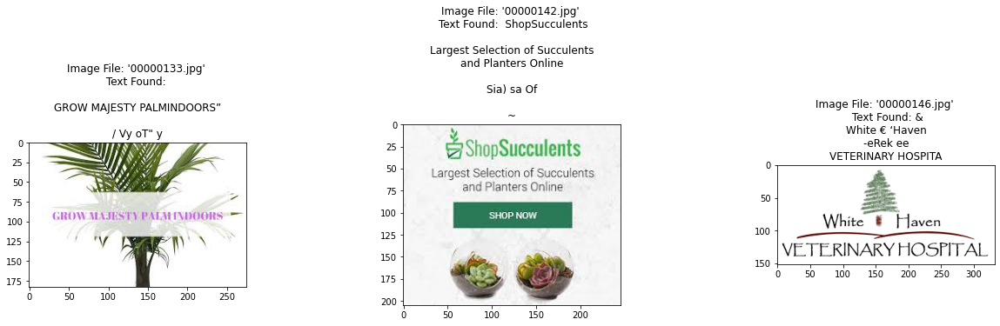

In [19]:
# We can visualize some of these images with artificial components
plot_images_text(df_artificial[2:], show_n = 3)

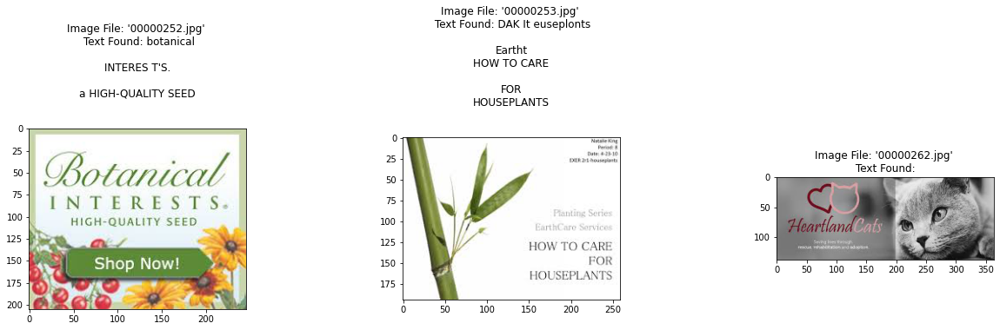

In [20]:
# We can visualize some of these images with artificial components
plot_images_text(df_artificial[5:], show_n = 3)

However, many false positives will exist - so further filtering is necessary.

# Cleaning Stage 2 - Tonal Distribution

In [21]:
# Convert PIL image into a tensor
img_test = tensor(Image.open(img_folder/'00000000.jpg'))
img_test.shape

torch.Size([225, 225, 3])

The PIL image tensor has three channels - red, blue and green, stored in that order. We can isolate a single channel and have a closer look 

In [22]:
red_channel = img_test[:,:,0][50:70,50:70]
df = pd.DataFrame(red_channel)
df.style.set_properties(**{'font-size':'6pt'}).background_gradient('Reds')

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
0,131,132,132,133,133,133,133,133,133,133,133,133,133,133,133,131,126,124,129,137
1,131,132,132,133,133,133,133,133,133,133,133,133,133,133,131,132,125,119,133,154
2,131,132,132,133,133,133,133,133,133,133,133,133,133,133,129,121,127,144,145,134
3,131,132,132,133,133,133,133,133,133,133,133,133,133,133,128,126,130,140,146,136
4,131,132,132,133,133,133,133,133,133,133,133,133,133,133,129,134,131,128,136,139
5,131,132,132,133,133,133,133,133,133,133,133,133,133,133,131,127,133,143,134,102
6,133,133,133,133,133,133,137,132,128,130,135,138,134,130,141,129,128,129,107,68
7,133,133,133,133,133,133,132,131,130,132,133,132,127,123,125,138,131,99,69,61
8,133,133,133,133,133,133,129,131,133,133,130,126,122,120,125,134,114,72,50,59
9,133,133,133,133,133,133,130,132,133,131,127,125,126,127,135,108,77,64,62,62


With this kind of approach, we can identify images that have large blocks of color with very little variation, as is typically seen in text/drawing images.  

In [23]:
def image_histogram(img_path, 
                     plot=True, 
                     plot_raw = True, 
                     max_intensity = 1000000, 
                     print_threshold_diagnostics = False, 
                     color_width = 1000, 
                     return_proportion = False):
  """ Takes in an image, and plots a histogram of color population against (hue,lightness) pairs. 
  If an image has a population of n (n = color_width) pixels with a specific 
  (hue,lightness) pair that make up more than pct_threshold of an image, we tag that image as artificial. 

  Parameters
  ----------
  img_folder: Path or str
    Fold with images to examine.
  plot: bool
    Plot histogram or not.
  plot_raw: bool
    Plot raw images or not.
  max_intensity: int
    Ceiling value for the hue:lightness pair populations. This value will affect the pixel proportion if too low. 
  print_threshold_diagnostics: bool
    Prints diagnositic information (number of hue/lightness pairs, how many are accounted for in calculating the proportion of the final image.)
  color_width: int
    How many of the most populous hue:lightness pairs to sum together to determine the proportion of the final image they occupy. 
  return_proportion: bool
    Should the function return the color proportion coverage value. 

  Returns:
  ----------
  Color proportion coverage value (if return_proportion=True)
    Histogram (if plot=True)
    Raw Image (if plot_raw=True)
  """
  import numpy as np
  import matplotlib.pyplot as plt
  from mpl_toolkits.mplot3d import Axes3D
  import colorsys
  from PIL import Image

  # Open image and get dimensions
  img_file = Image.open(img_path).convert('RGB')
  img = img_file.load()
  [xs,ys] = img_file.size
  max_intensity = max_intensity
  hues = {}

  # For each pixel in the image file
  for x in range(0, xs):
    for y in range(0, ys):
      # Get the RGB color of the pixel
      [r, g, b] = img[x, y]
      # Normalize pixel color values
      r /= 255.0
      g /= 255.0
      b /= 255.0
      # Convert RGB color to HSL
      [h, l, s] = colorsys.rgb_to_hls(r, g, b)
      # Count how many pixels have matching (h, l)
      if h not in hues:
        hues[h] = {}
      if l not in hues[h]:
        hues[h][l] = 1
      else:
        if hues[h][l] < max_intensity:
          hues[h][l] += 1

  # Decompose the hues object into a set of one dimensional arrays
  h_ = []
  l_ = []
  i = []
  colours = []

  for h in hues:
    for l in hues[h]:
      h_.append(h)
      l_.append(l)
      i.append(hues[h][l])
      [r, g, b] = colorsys.hls_to_rgb(h, l, 1)
      colours.append([r, g, b])

  # Plot if wanted
  raw_image = Image.open(img_path)
  raw_image = np.asarray(raw_image)
  if plot==True:
    fig = plt.figure(figsize=(12,5))
    fig.set_facecolor("white")
    ax = plt.subplot2grid((2,6), (0,0), colspan=4, rowspan=2, projection='3d')
    ax.scatter(h_, l_, i, s=30, c=colours, lw=0.5, edgecolors='black')
    ax.set_xlabel('Hue')
    ax.set_ylabel('Lightness')
    ax.set_zlabel('Population')
    # Plot raw image if wanted
    if plot_raw == True:
      ax2 = plt.subplot2grid((2,6), (0,4), colspan=2, rowspan=2)
      ax2.imshow(raw_image)  
      ax2.title.set_text(f'Raw Image: {img_path.name}')
    plt.tight_layout()
    plt.show()
  
  # Determine if the image we're examining is artificially generated
  n_greatest = sum(sorted(i, reverse=True)[:color_width])
  picture_size = xs*ys
  if print_threshold_diagnostics == True:
    print(f'There are {len(i)} hue/lightness pairs in this image.')
    print(f'Population of {color_width} hue/lightness pairs with the largest populations = {n_greatest}')
    print(f'This represents {n_greatest/picture_size*100:.2f}% of the total pixels in the image.')

  if return_proportion == True:
    return n_greatest/picture_size

In general, we see that artificial documents (text or drawings etc.) tend to have a higher proportion of pixels that possess exactly the same color. These plots have taken the Hue and Lightness (from conversion to HLS) of each pixel in the image and plotted the z-axis as the population of pixels that exist for given (hue and lightness) pair. 

Hence - we can see at a glance which images possess artificially high color populations. Natural photographs would typically not have this feature, due to subtle jitter in the hue and lightness from pixel to pixel that is captured and encoded into the image. This leads to hue-lightness populations that are much flatter and well-distributed. On the other hand - computer generated images simply pick out a single hue-lightness pair when filling large areas with a color, leading to artificially high population densities for a given hue-lightness pair.

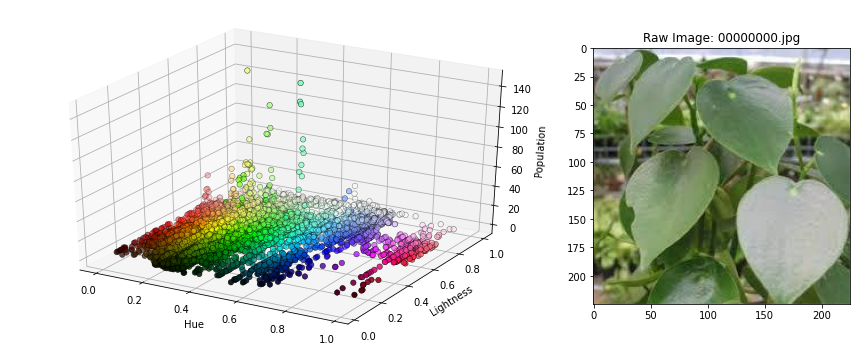

There are 27247 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 12288
This represents 24.27% of the total pixels in the image.


In [24]:
image_histogram(img_list[0], print_threshold_diagnostics = True)

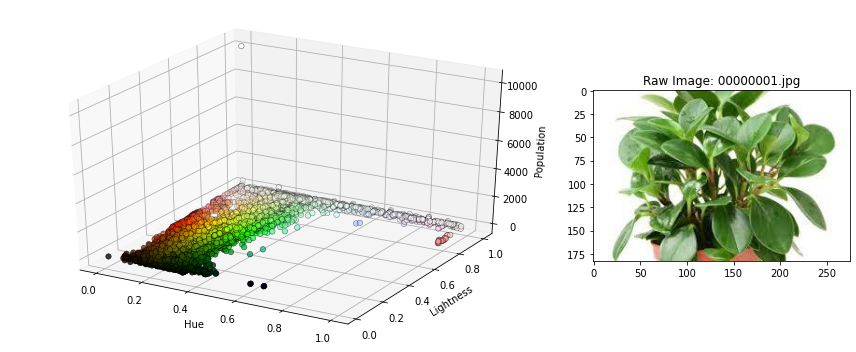

There are 26401 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 19365
This represents 38.48% of the total pixels in the image.


In [25]:
image_histogram(img_list[1], print_threshold_diagnostics = True)

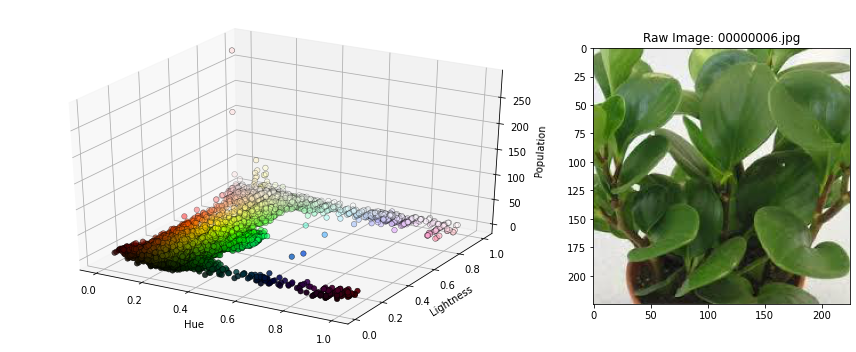

There are 24854 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 11977
This represents 23.66% of the total pixels in the image.


In [26]:
image_histogram(img_list[6], print_threshold_diagnostics = True)

Even though these images appear predominantly green, there are subtle color variations in a natural photo that prevent any particular shade of color from representing too large a proportion of pixels.
This is reflected in the number of hue/lightness pairings.

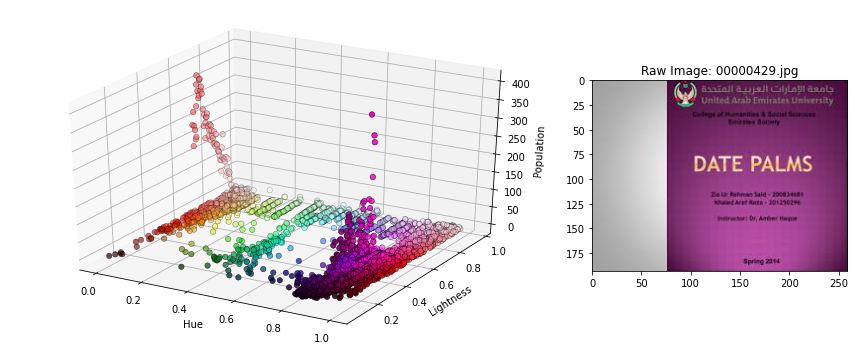

There are 10149 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 36406
This represents 72.46% of the total pixels in the image.


In [27]:
image_histogram(img_list[145], print_threshold_diagnostics = True)

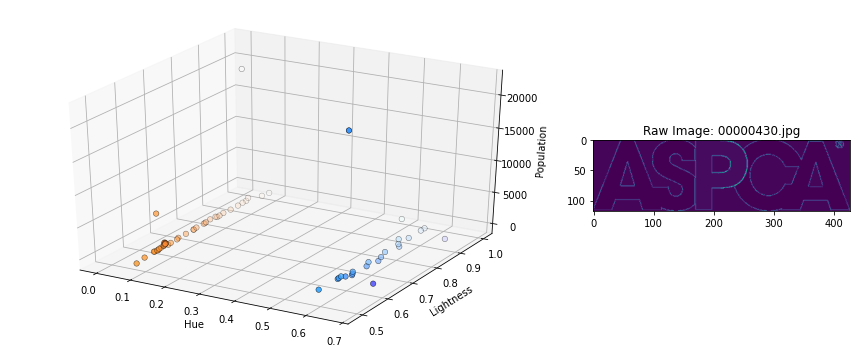

There are 66 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 50268
This represents 100.00% of the total pixels in the image.


In [28]:
image_histogram(img_list[146], print_threshold_diagnostics = True)

We can see that images that possess a hue/lightness pairing that are evenly spread tend to be natural images, whereas those with artifical components (text documents etc.) have large swathes of color that would be impossibly similar to be by accident. 

Additionally, natural images have on the order of 20 to 30 thousand hue/lightness pairings, compared to artificial images that may contain as few as 100. 

After processing a few folders, we're going to say that if 1000 hue:lightness pairs represent over 70% of the pixels in the image, that image is not a good training example and should be removed. 

In [29]:
def find_artificial_colors(img_folder, 
                           return_all = False, 
                           color_width = 1000,
                           threshold = 0.7):
  """ Finds images in an img_folder with excessively shallow color profiles that will be poor examples of a class. 

  Parameters
  ----------
  img_folder: Path or str
    Fold with images to examine.
  return_all: bool
    Determines if the function should return the entire dataset.
  color_width: int
    How many of the most populous hue:lightness pairs to sum together to determine the proportion of the final image they occupy. 
  threshold: float, 0 < threshold < 1 
    What percent of the image is acceptable for 1000 hue:lightness pairs to occupy, more than this is tagged for removal.

  Returns:
  ----------
  DataFrame
    DataFrame with image paths to remove, and reason (pixel proportion).
  """
  from tqdm.notebook import tqdm
  # Initialize DataFrame
  column_names = ['Artificial Images', 'Pixel Proportion']
  df_mt = pd.DataFrame(columns = column_names)
  # Loop over folder
  for image in tqdm(img_folder.ls()):
    proportion = image_histogram(image, plot = False, plot_raw = False, return_proportion=True, color_width=color_width)
    # Append to dataframe
    df_mt = df_mt.append({'Artificial Images':image,'Pixel Proportion':proportion}, ignore_index=True)

  if return_all == True:
    return df_mt
  else:
    df_mt = df_mt[df_mt['Pixel Proportion']>threshold]
    print (f'{len(df_mt)} artificial images found')
    return df_mt

In [30]:
df_artificial = find_artificial_colors(img_folder, threshold=0.7)


32 artificial images found


In [31]:
df_artificial

,Artificial Images,Pixel Proportion
12,/content/plant_image_database/Peperomia peltifolia/00000283.jpg,0.961991
13,/content/plant_image_database/Peperomia peltifolia/00000428.jpg,0.751543
14,/content/plant_image_database/Peperomia peltifolia/00000255.jpg,0.784416
15,/content/plant_image_database/Peperomia peltifolia/00000272.jpg,0.885131
16,/content/plant_image_database/Peperomia peltifolia/00000430.jpg,1.000000
19,/content/plant_image_database/Peperomia peltifolia/00000264.jpg,0.757549
35,/content/plant_image_database/Peperomia peltifolia/00000279.jpg,0.954374
37,/content/plant_image_database/Peperomia peltifolia/00000029.jpg,0.705385
52,/content/plant_image_database/Peperomia peltifolia/00000281.jpg,1.000000
53,/content/plant_image_database/Peperomia peltifolia/00000251.jpg,0.949876


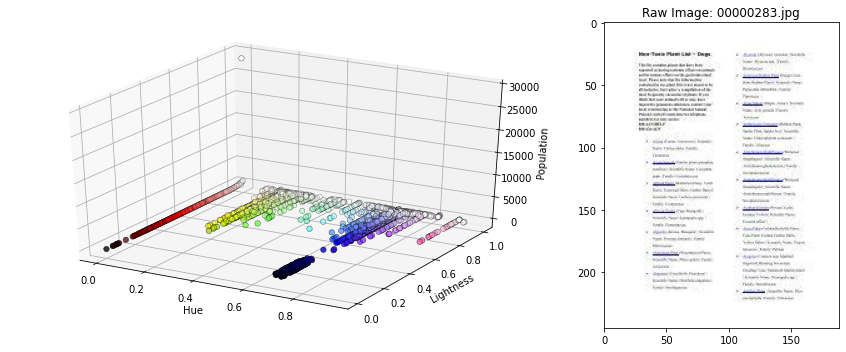

There are 2681 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 44545
This represents 96.20% of the total pixels in the image.


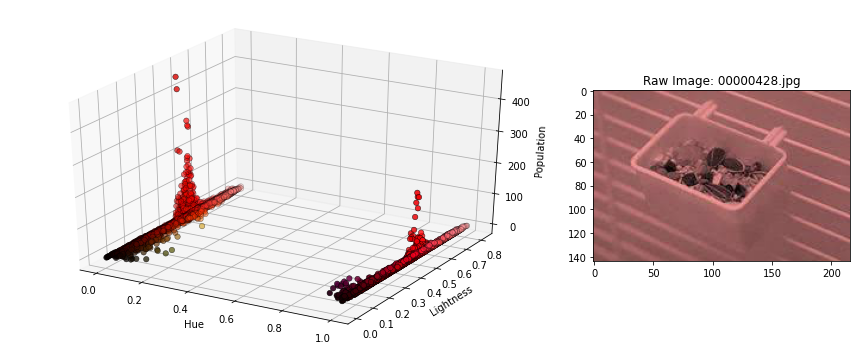

There are 6130 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 23376
This represents 75.15% of the total pixels in the image.


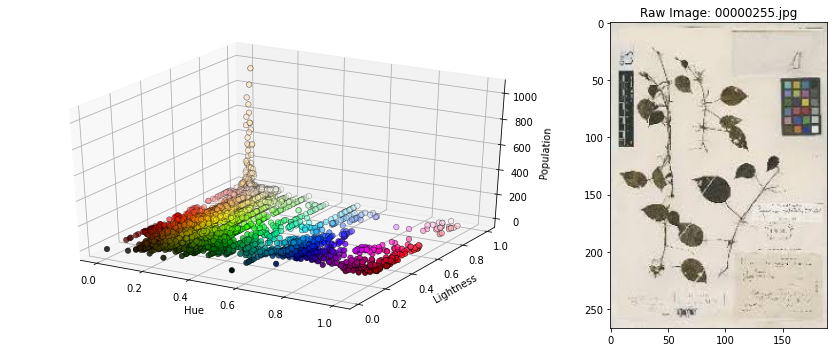

There are 7577 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 39584
This represents 78.44% of the total pixels in the image.


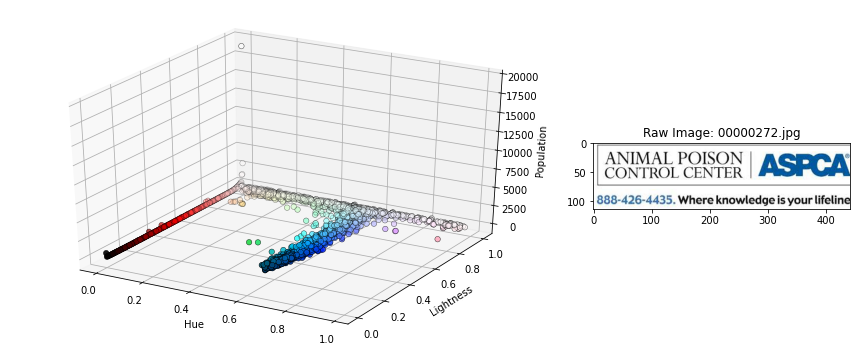

There are 6181 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 44600
This represents 88.51% of the total pixels in the image.


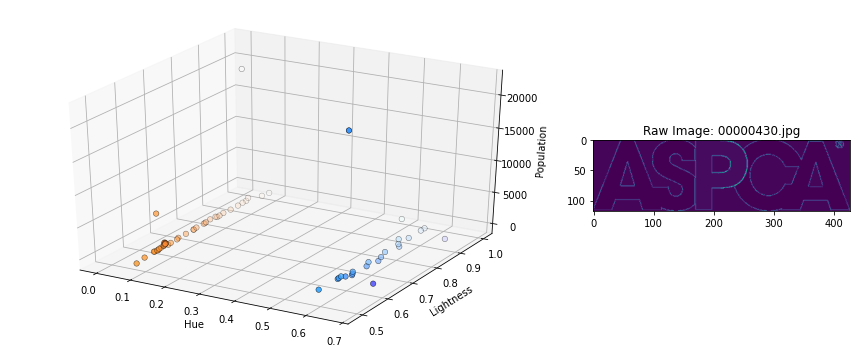

There are 66 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 50268
This represents 100.00% of the total pixels in the image.


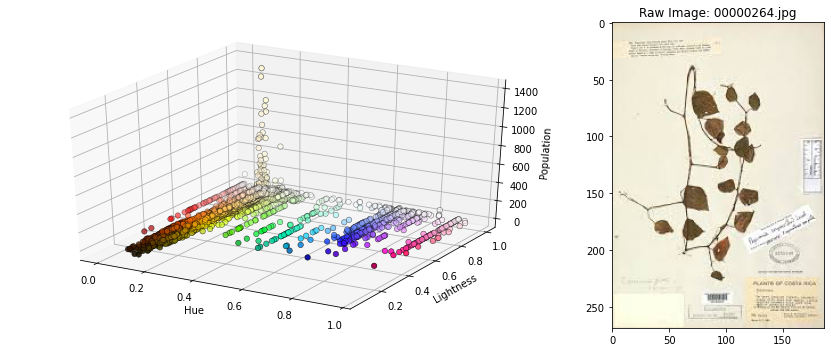

There are 8767 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 38107
This represents 75.75% of the total pixels in the image.


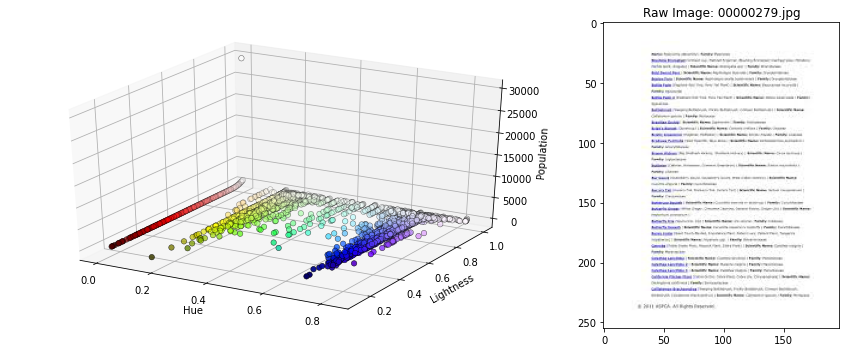

There are 3292 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 47943
This represents 95.44% of the total pixels in the image.


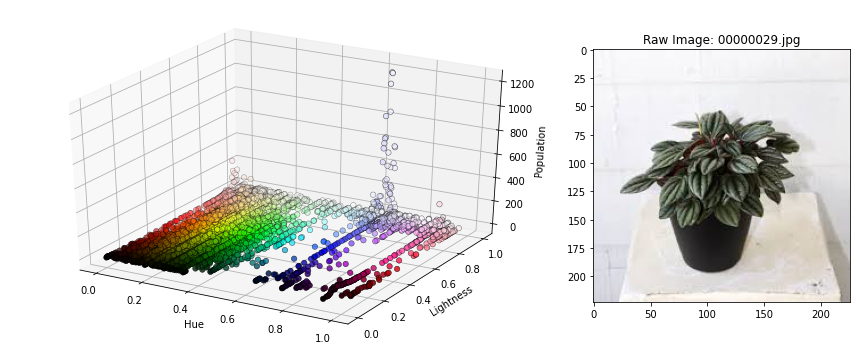

There are 9430 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 35550
This represents 70.54% of the total pixels in the image.


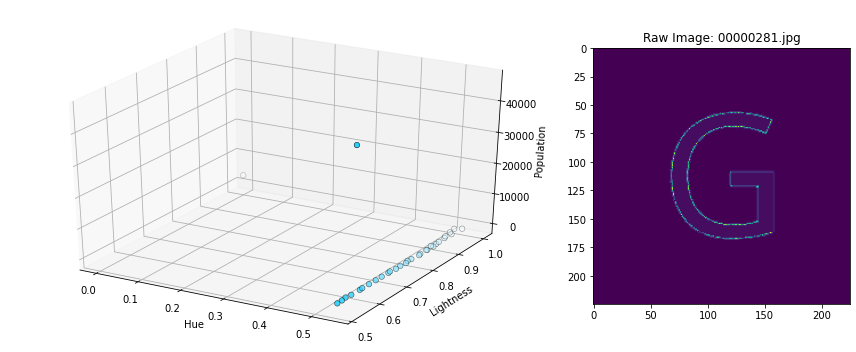

There are 32 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 50625
This represents 100.00% of the total pixels in the image.


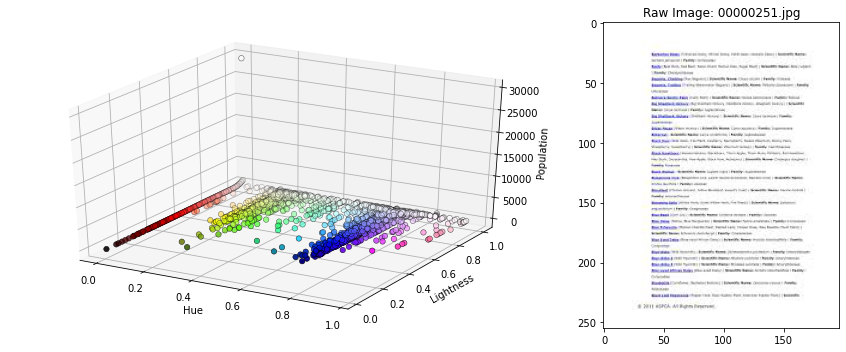

There are 3518 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 47717
This represents 94.99% of the total pixels in the image.


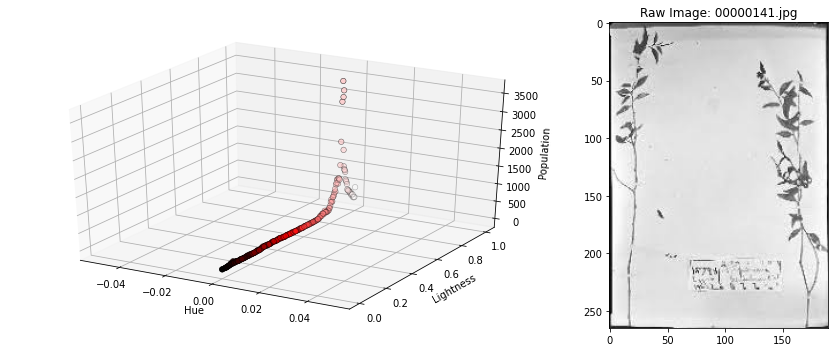

There are 253 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 50350
This represents 100.00% of the total pixels in the image.


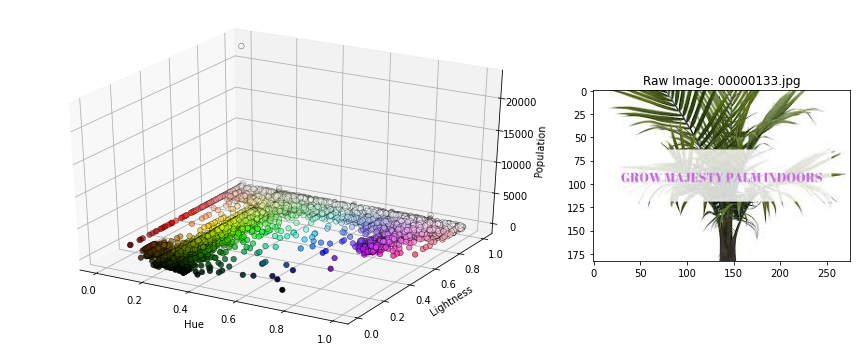

There are 12819 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 35635
This represents 70.81% of the total pixels in the image.


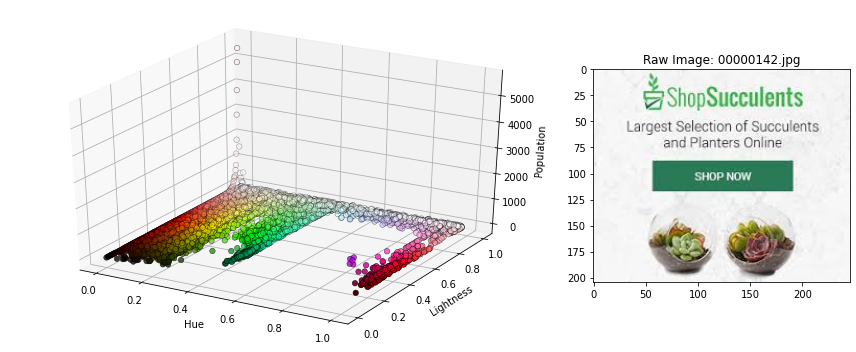

There are 10552 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 39902
This represents 79.12% of the total pixels in the image.


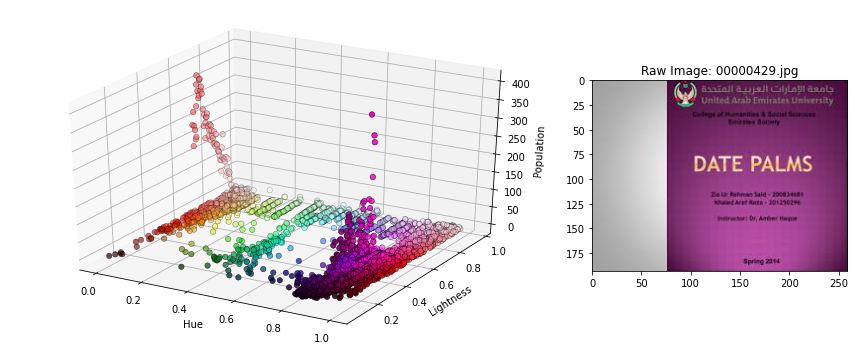

There are 10149 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 36406
This represents 72.46% of the total pixels in the image.


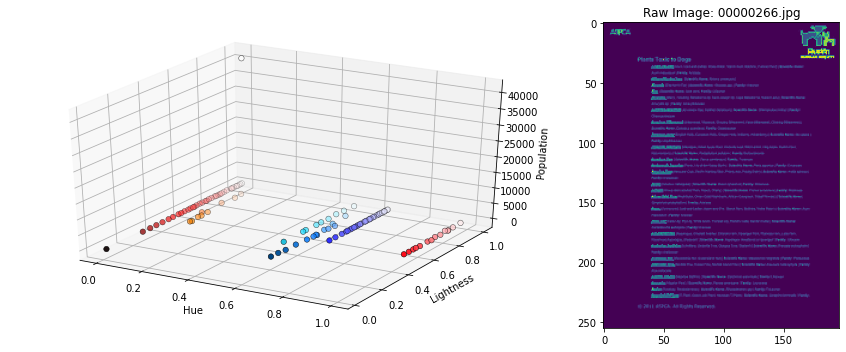

There are 113 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 50235
This represents 100.00% of the total pixels in the image.


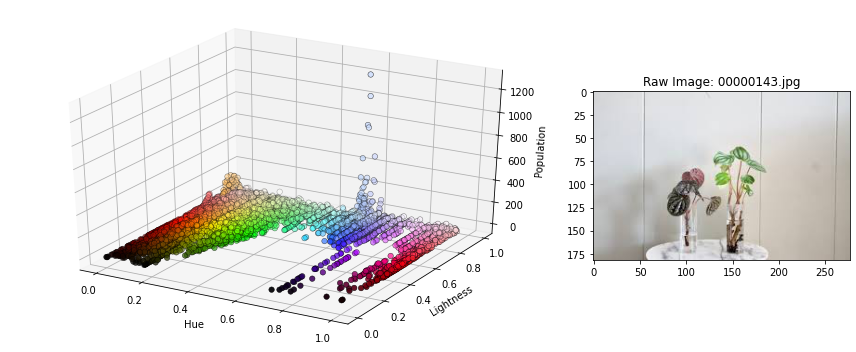

There are 8103 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 40343
This represents 80.02% of the total pixels in the image.


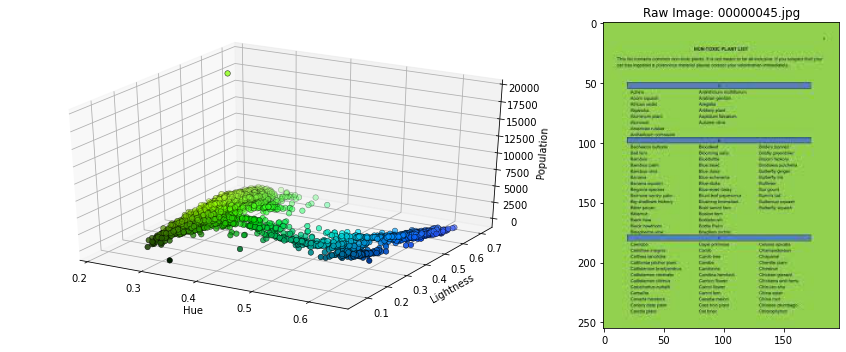

There are 10038 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 35952
This represents 71.57% of the total pixels in the image.


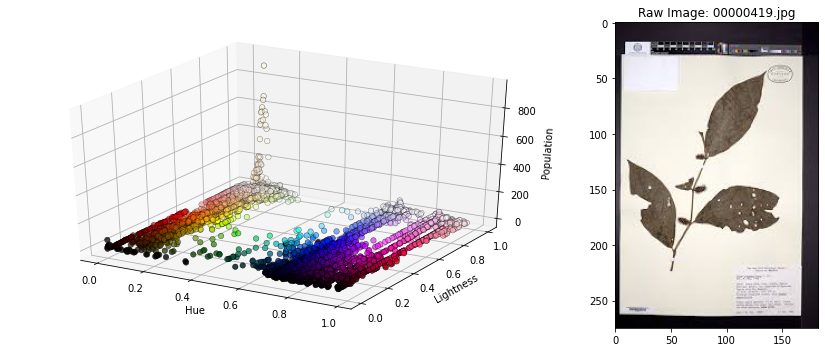

There are 7421 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 37987
This represents 75.48% of the total pixels in the image.


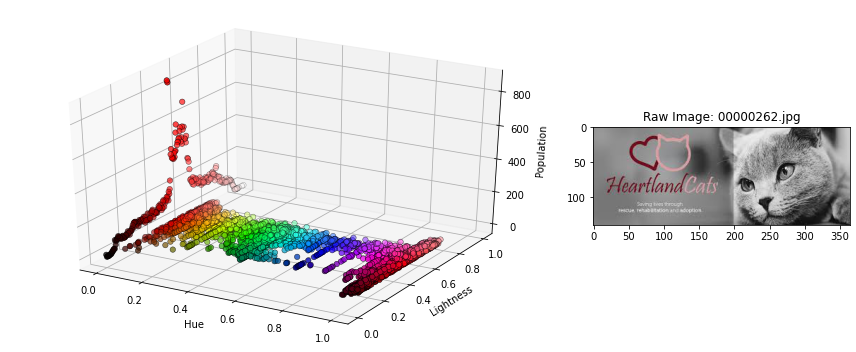

There are 6696 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 44191
This represents 87.34% of the total pixels in the image.


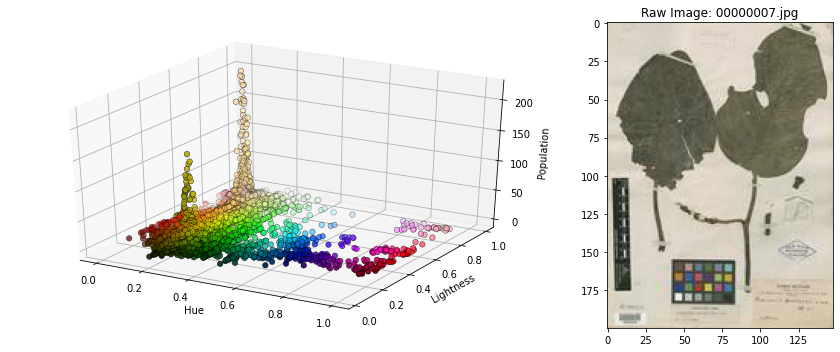

There are 5939 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 22274
This represents 75.25% of the total pixels in the image.


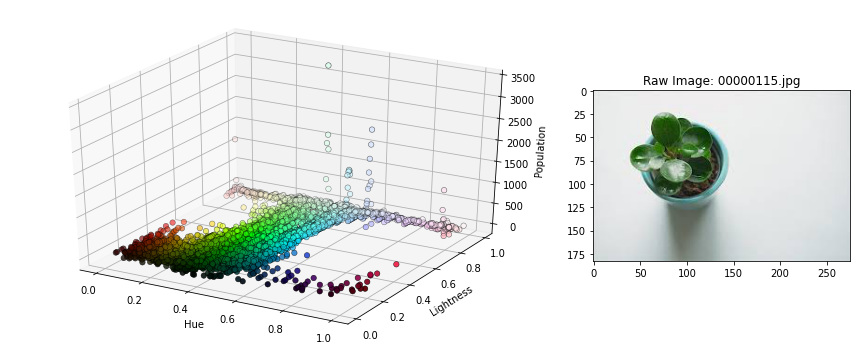

There are 8967 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 41537
This represents 82.54% of the total pixels in the image.


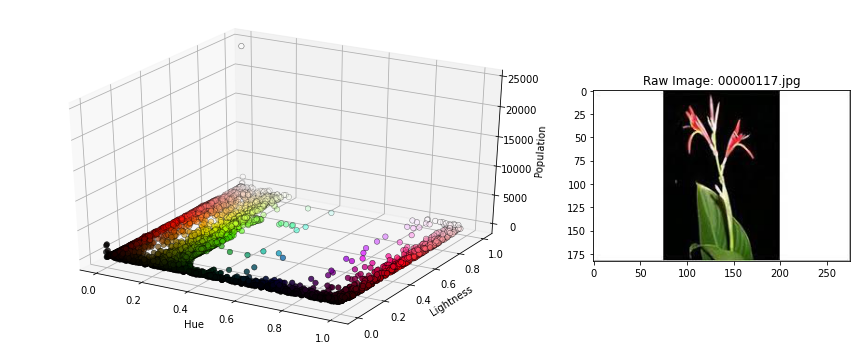

There are 6168 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 45151
This represents 89.72% of the total pixels in the image.


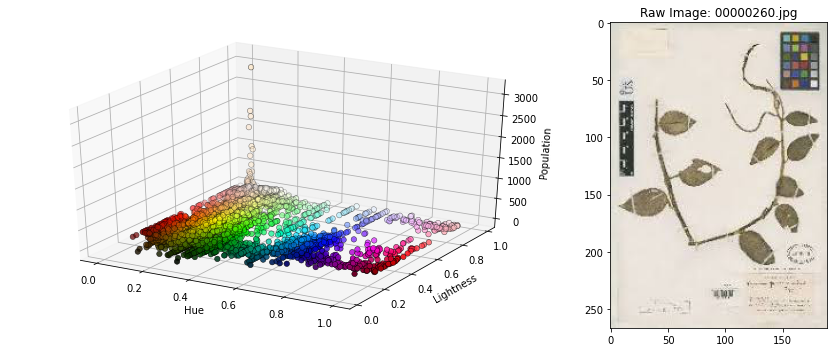

There are 8950 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 38777
This represents 76.84% of the total pixels in the image.


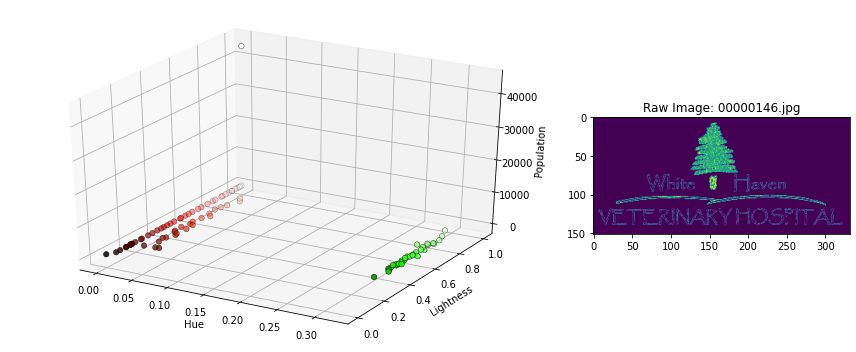

There are 98 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 50464
This represents 100.00% of the total pixels in the image.


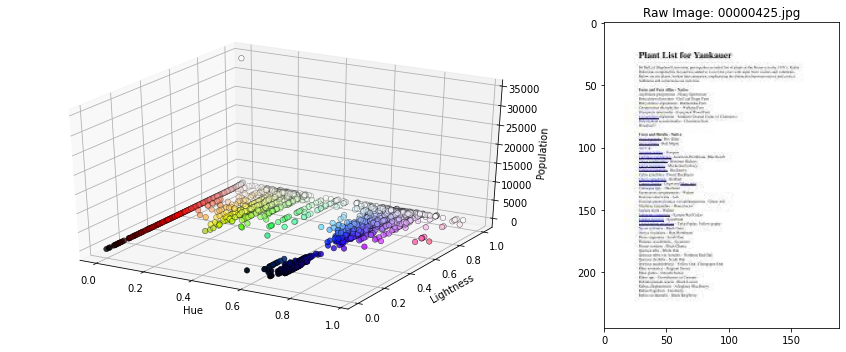

There are 2499 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 44806
This represents 96.76% of the total pixels in the image.


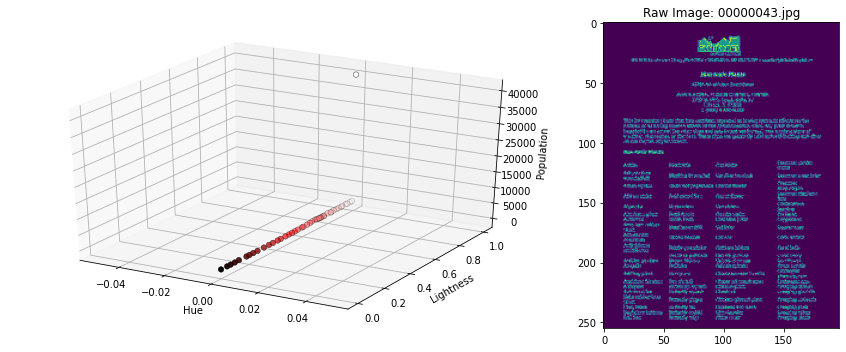

There are 46 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 50235
This represents 100.00% of the total pixels in the image.


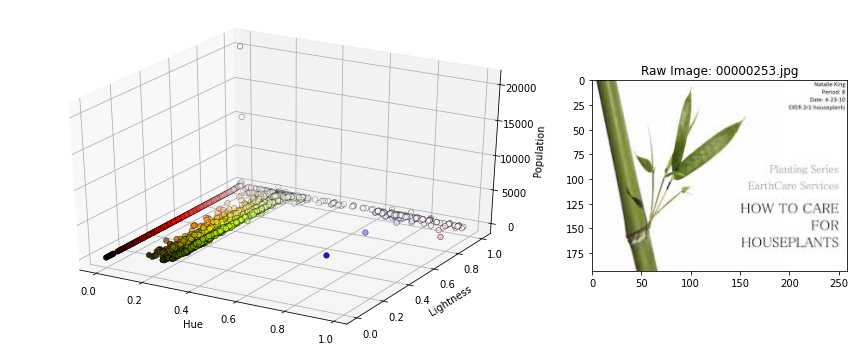

There are 5682 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 44690
This represents 88.94% of the total pixels in the image.


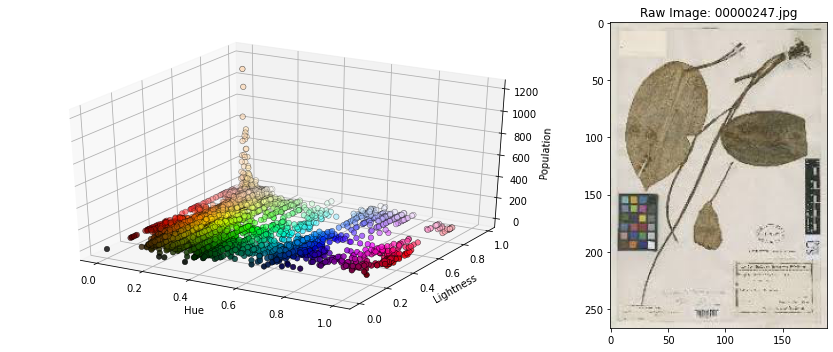

There are 9795 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 35702
This represents 70.75% of the total pixels in the image.


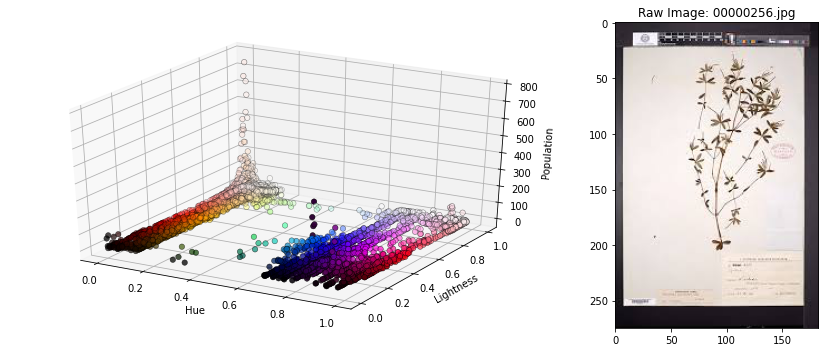

There are 7672 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 37601
This represents 74.72% of the total pixels in the image.


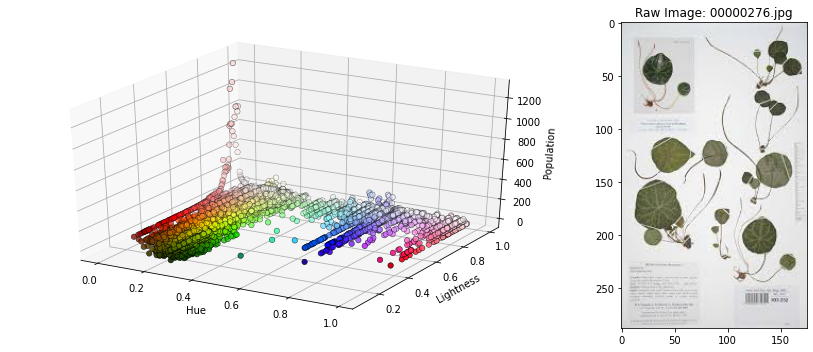

There are 8449 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 38722
This represents 76.83% of the total pixels in the image.


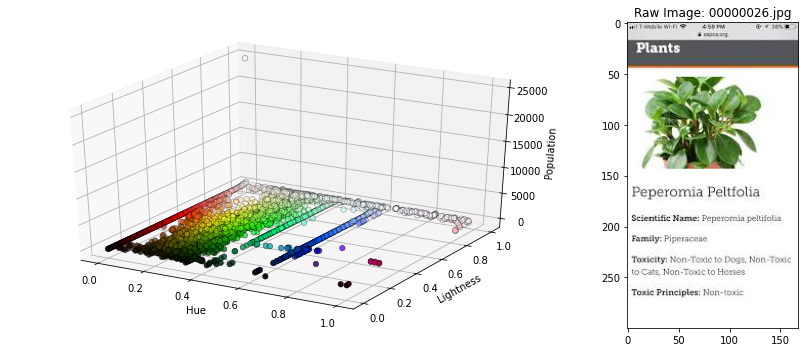

There are 8997 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 42108
This represents 83.55% of the total pixels in the image.


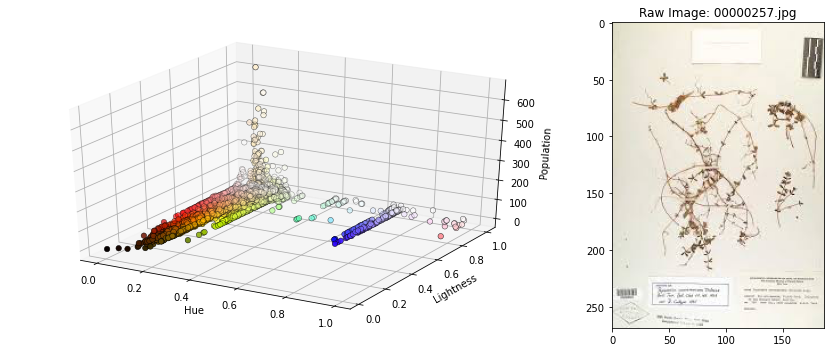

There are 7398 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 39911
This represents 79.34% of the total pixels in the image.


In [32]:
# We can visualize these images deemed to be clearly artificial
for i in range(len(df_artificial)):
  image_histogram(df_artificial.iloc[i,0], print_threshold_diagnostics = True, color_width = 1000, max_intensity=1000000)

# Putting text detection and colour histogram to detect artificial images

If we put these techniques together, we can remove the false text positives from the previous filtering - these images may appear to have text due to the arrangement of leaves or branches. If such images have a very even spread of colors (1000 H:L pairs representing less than 50% of the pixels), we will consider it to be a false positive.  

In [33]:
def find_artificial_images(img_folder, edge_removal = True, threshold = 0.7, text_threshold = 0.5, return_diagnostics = False):
  """ Examines each image in an img_folder for artificial images that will be poor examples of a class. 

  Parameters
  ----------
  img_folder: Path or str
    Fold with images to examine.
  edge_removal: bool
    Determines if the function should attempt to remove text by cropping 10% of the image at the top and bottom.
  threshold: float, 0 < threshold < 1 
    What percent of the image is acceptable for 1000 hue:lightness pairs to occupy, more than this is tagged for removal.
  text_threshold: float, 0 < text_threshold < 1 
    When text is detected, what threshold is also needed for removal.
  return_diagnostics: bool
    Return a diagnostic DataFrame instead.
  Returns:
  ----------
  DataFrame
    DataFrame with image paths to remove, and reason (text, pixel proportion).
  """
  df_colors = find_artificial_colors(img_folder, threshold=threshold, return_all = True)
  df_text = find_artificial_text(img_folder, edge_removal=edge_removal)
  # Inner merge to get color data
  df_text_colors = df_text.merge(df_colors, how='inner', on='Artificial Images')
  # Remove if text is supposedly present and 1000 hue:lightness pairs account for more than 50% of the image
    # Try to keep false positives
  df_text_remove = df_text_colors[df_text_colors['Pixel Proportion']>text_threshold]
  # Remove if 1000 hue:lightness pairs account for more than 70% of the image
  df_colors_remove = df_colors[df_colors['Pixel Proportion']>threshold]
  # Put together dataframe of images to remove
  df_remove = df_text_remove.merge(df_colors_remove, how='outer', on = ['Artificial Images', 'Pixel Proportion'])
  if return_diagnostics == True: return df_text_colors
  else: return df_remove

Now we can scan a folder for images with text, or an excessively shallow color profile, and mark them for deletion. 

Let's clean up our database!

### Zephyranthes drummondii

In [48]:
local_path = Path('/content/plant_image_database')
img_folder = local_path/'Zephyranthes drummondii'

In [58]:
text_color_df = find_artificial_images(img_folder, edge_removal=True, return_diagnostics=True)

In [59]:
text_color_df

,Artificial Images,Text Found,Pixel Proportion
0,/content/plant_image_database/Zephyranthes drummondii/00000110.jpg,,0.483358
1,/content/plant_image_database/Zephyranthes drummondii/00000116.jpg,T,0.385784
2,/content/plant_image_database/Zephyranthes drummondii/00000281.jpg,,0.313657
3,/content/plant_image_database/Zephyranthes drummondii/00000431.jpg,\n\nGenus Distribution Mop\n\n(9) Not Vouctered L7\nHEB Vouctnred\n\n \n\n,0.851496
4,/content/plant_image_database/Zephyranthes drummondii/00000433.jpg,,0.319032


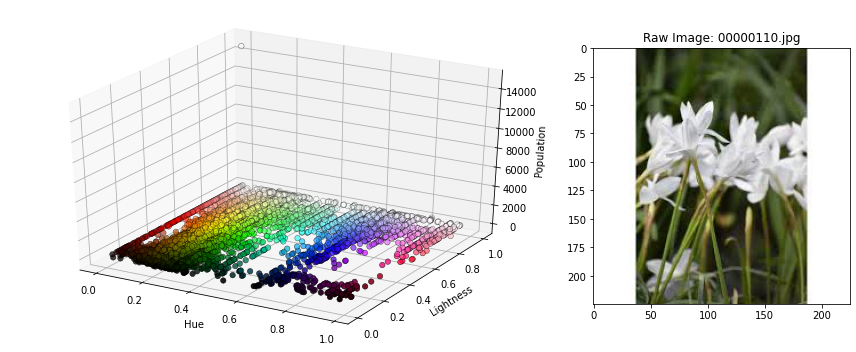

There are 18127 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 24470
This represents 48.34% of the total pixels in the image.


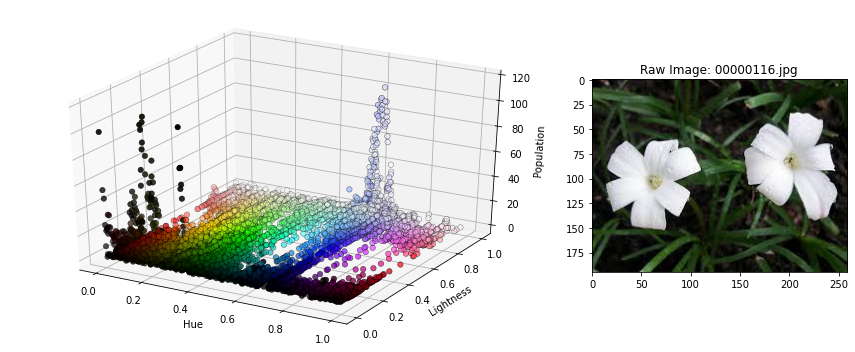

There are 16377 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 19484
This represents 38.58% of the total pixels in the image.


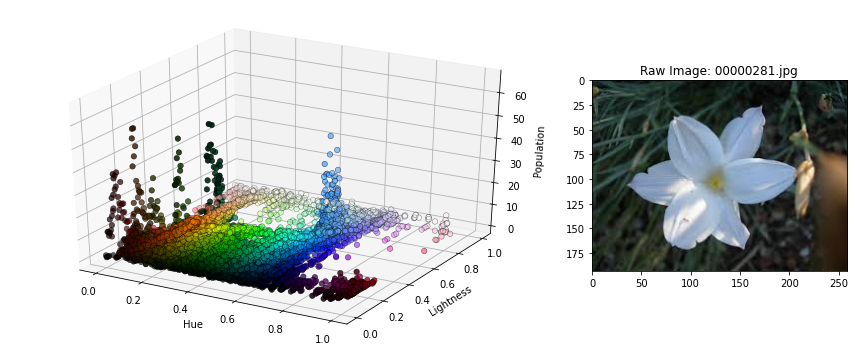

There are 18883 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 15760
This represents 31.37% of the total pixels in the image.


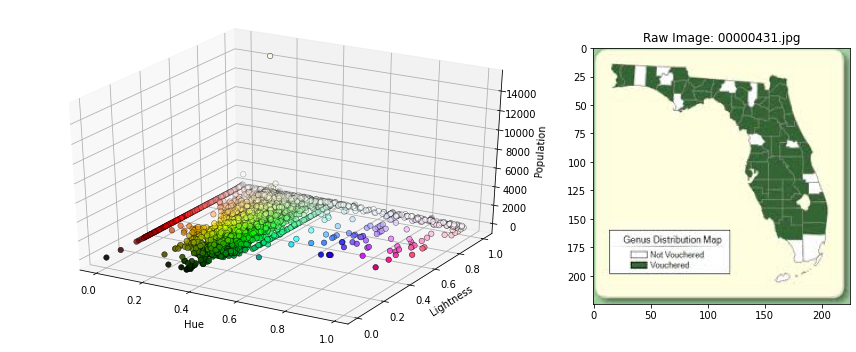

There are 6791 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 43107
This represents 85.15% of the total pixels in the image.


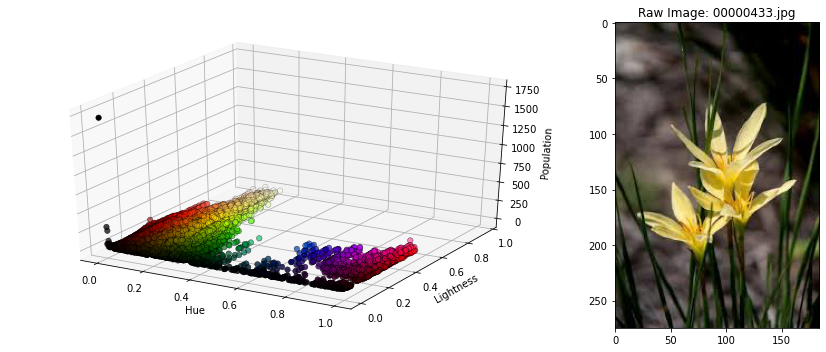

There are 22620 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 16143
This represents 31.90% of the total pixels in the image.


In [46]:
# We can visualize these images that have text detected.
for i in range(len(text_color_df)):
  image_histogram(text_color_df['Artificial Images'][i], print_threshold_diagnostics = True)

In [40]:
df_remove = find_artificial_images(img_folder)

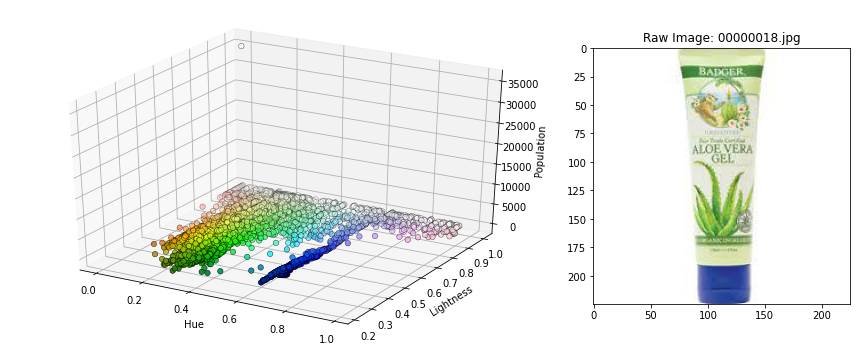

There are 9693 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 41050
This represents 81.09% of the total pixels in the image.


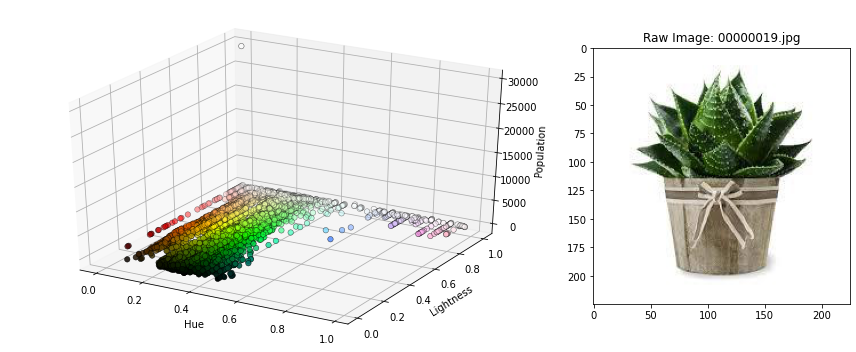

There are 11421 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 37427
This represents 73.93% of the total pixels in the image.


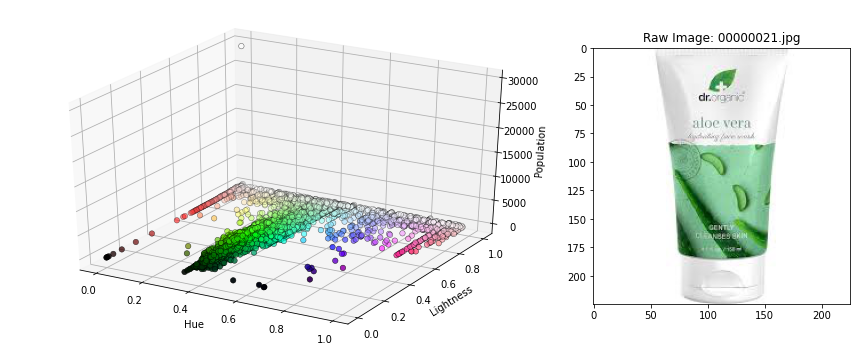

There are 8053 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 42874
This represents 84.69% of the total pixels in the image.


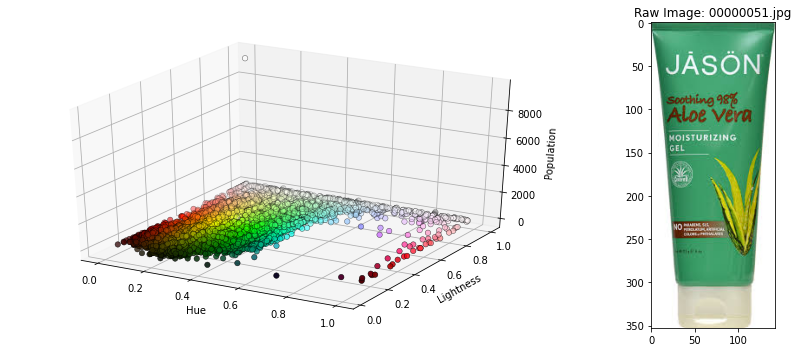

There are 17012 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 29457
This represents 58.35% of the total pixels in the image.


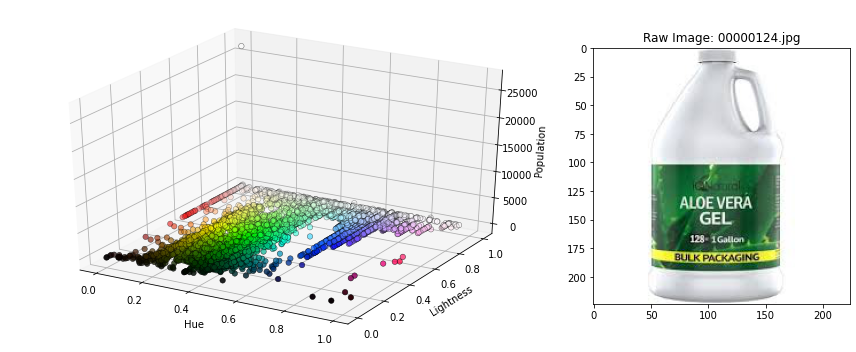

There are 10312 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 39151
This represents 78.03% of the total pixels in the image.


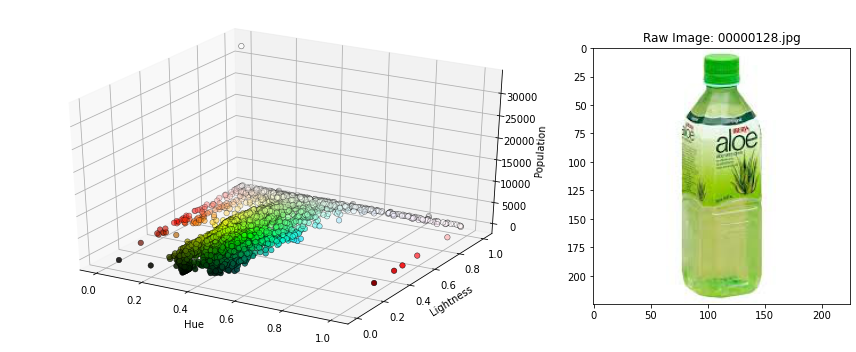

There are 10105 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 40869
This represents 80.73% of the total pixels in the image.


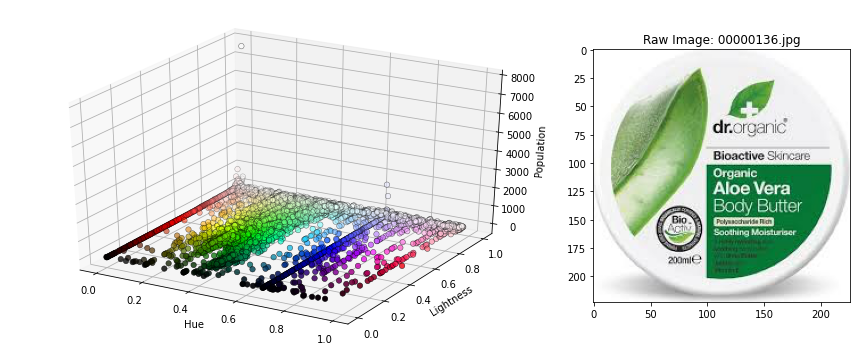

There are 15291 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 31942
This represents 63.38% of the total pixels in the image.


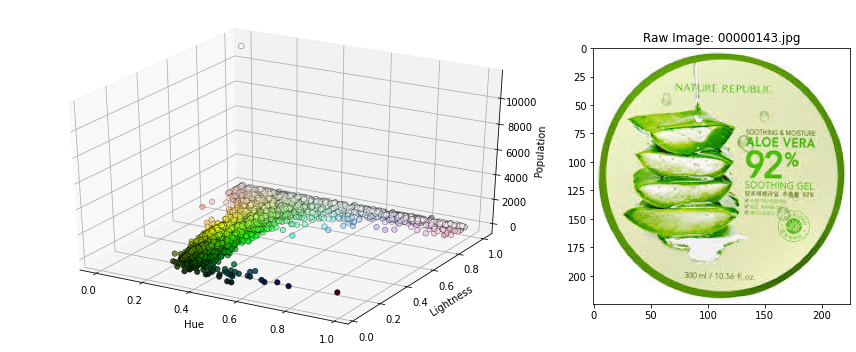

There are 19472 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 28551
This represents 56.40% of the total pixels in the image.


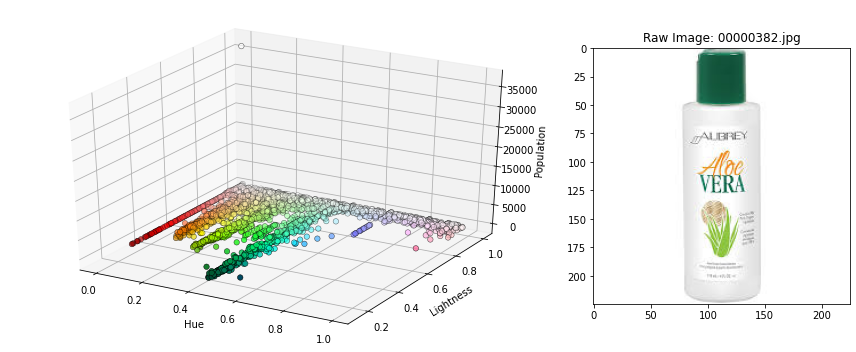

There are 3502 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 48123
This represents 95.06% of the total pixels in the image.


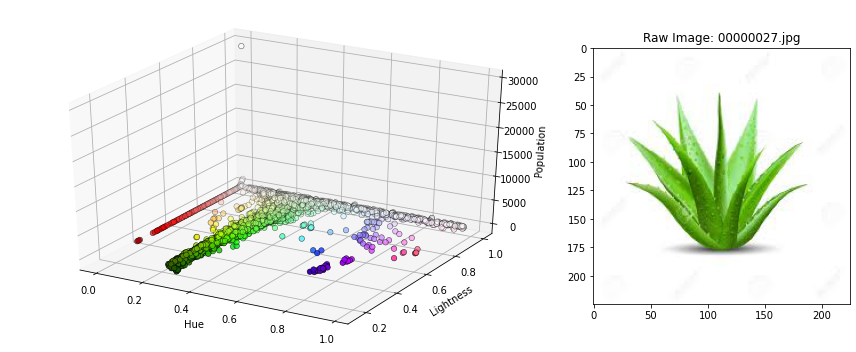

There are 9399 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 41687
This represents 82.34% of the total pixels in the image.


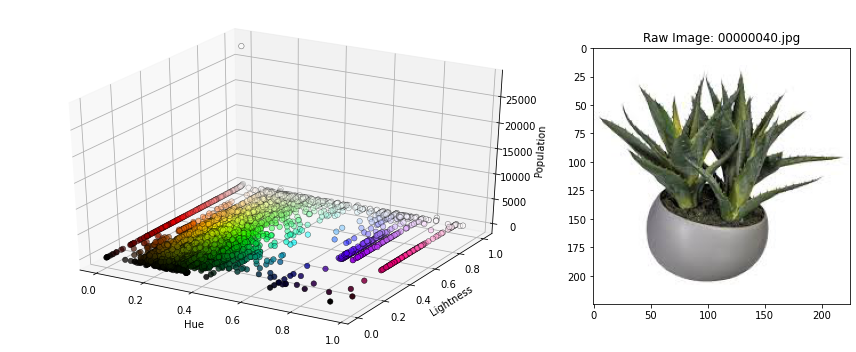

There are 9558 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 39104
This represents 77.24% of the total pixels in the image.


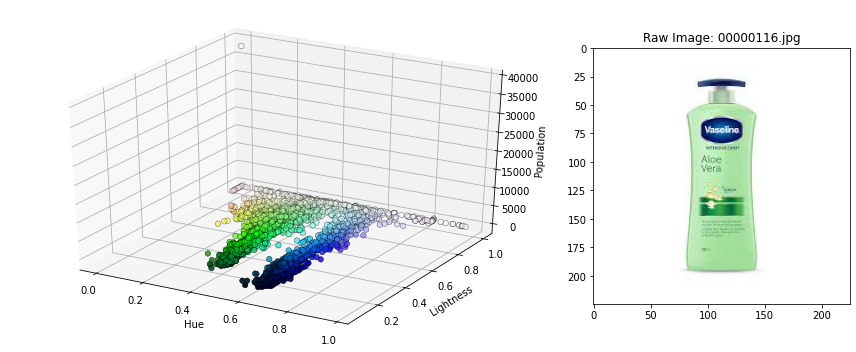

There are 5752 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 45663
This represents 90.20% of the total pixels in the image.


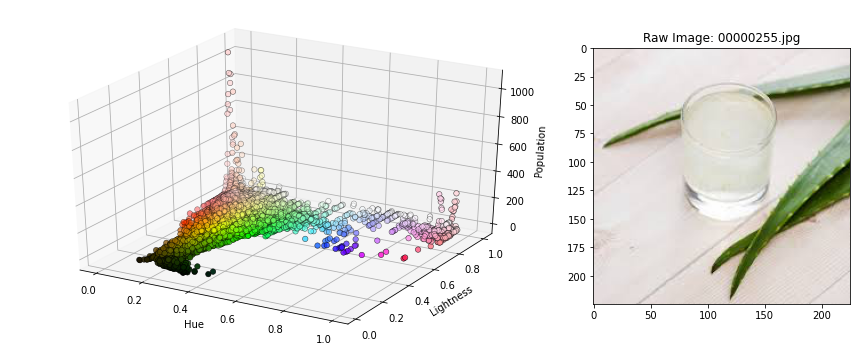

There are 11078 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 36903
This represents 72.89% of the total pixels in the image.


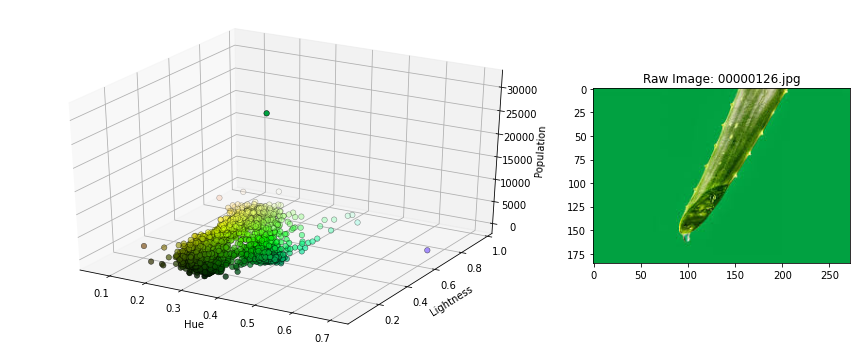

There are 6657 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 44663
This represents 88.76% of the total pixels in the image.


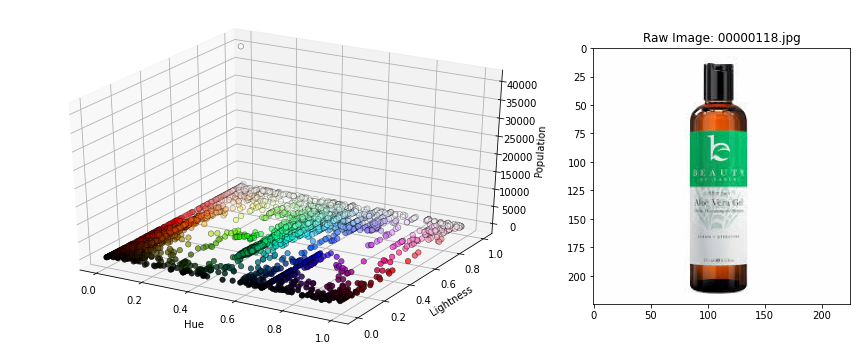

There are 5312 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 46171
This represents 91.20% of the total pixels in the image.


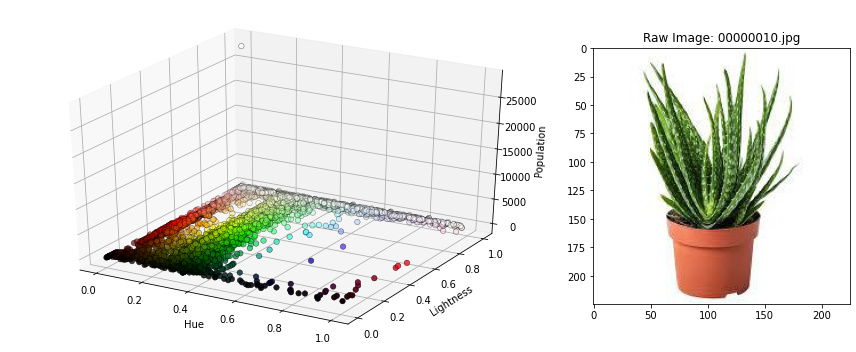

There are 13429 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 36626
This represents 72.35% of the total pixels in the image.


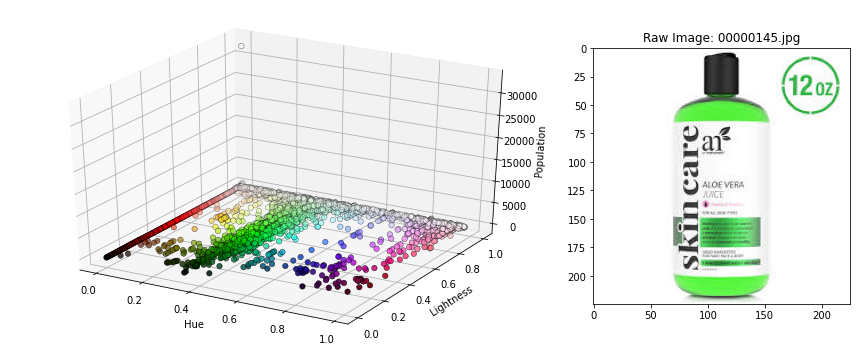

There are 6137 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 45330
This represents 89.54% of the total pixels in the image.


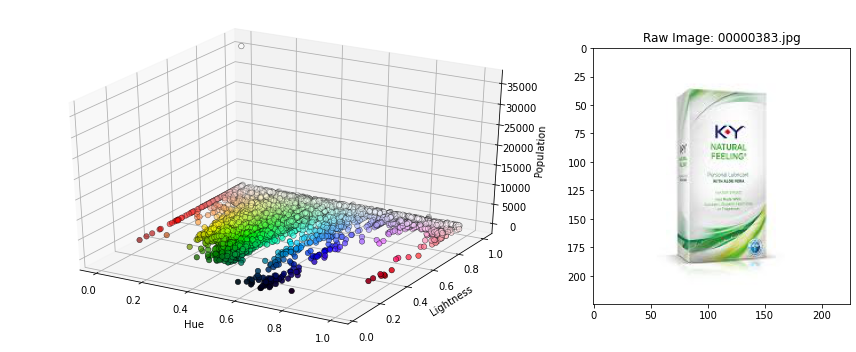

There are 6246 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 45029
This represents 88.95% of the total pixels in the image.


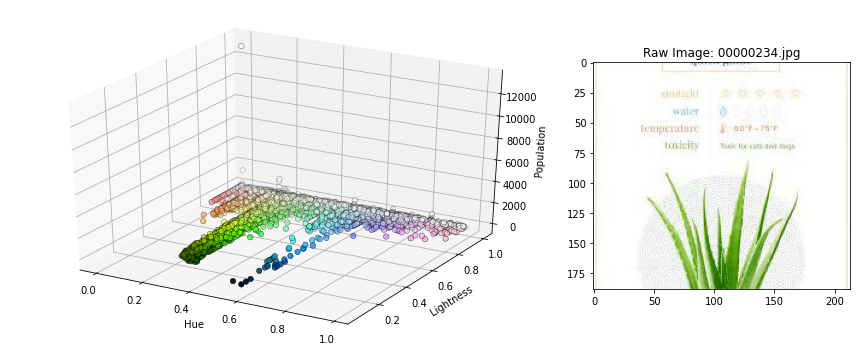

There are 8549 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 31994
This represents 79.47% of the total pixels in the image.


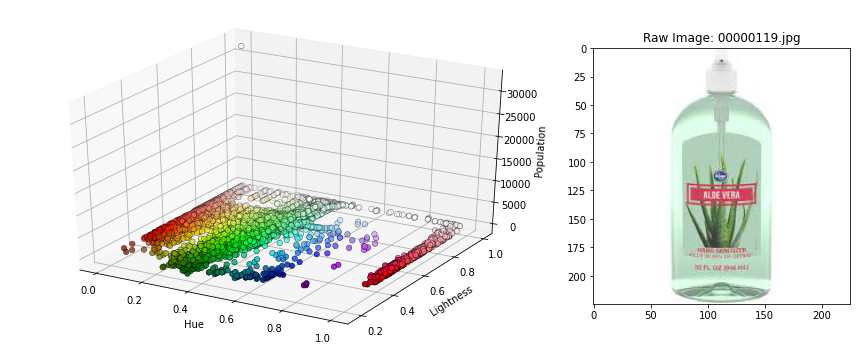

There are 7526 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 42937
This represents 84.81% of the total pixels in the image.


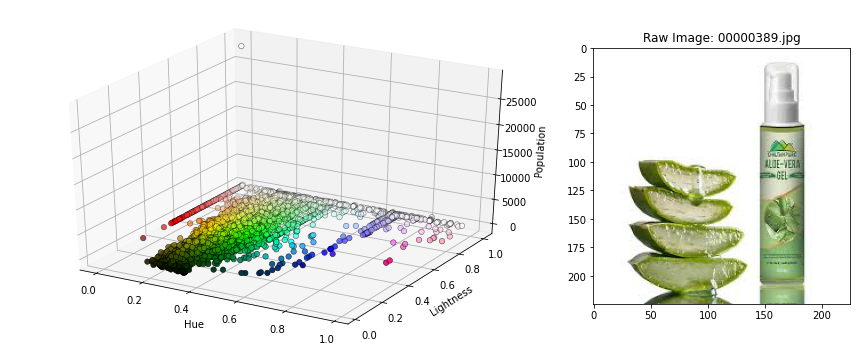

There are 14190 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 36050
This represents 71.21% of the total pixels in the image.


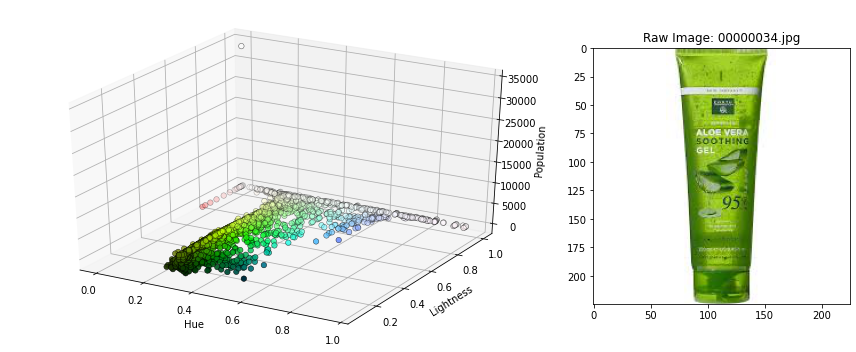

There are 11221 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 39346
This represents 77.72% of the total pixels in the image.


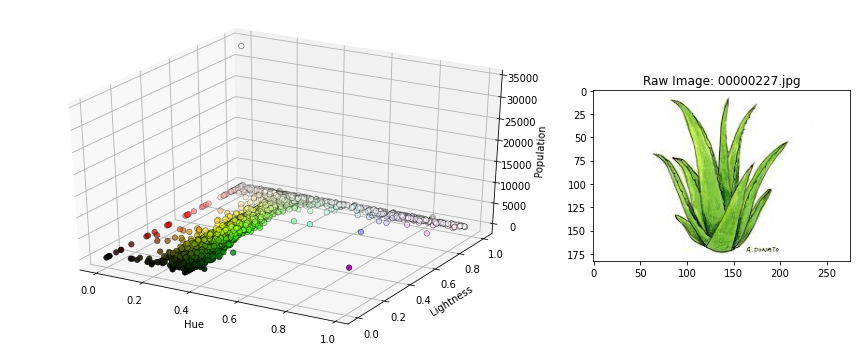

There are 10577 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 40422
This represents 80.32% of the total pixels in the image.


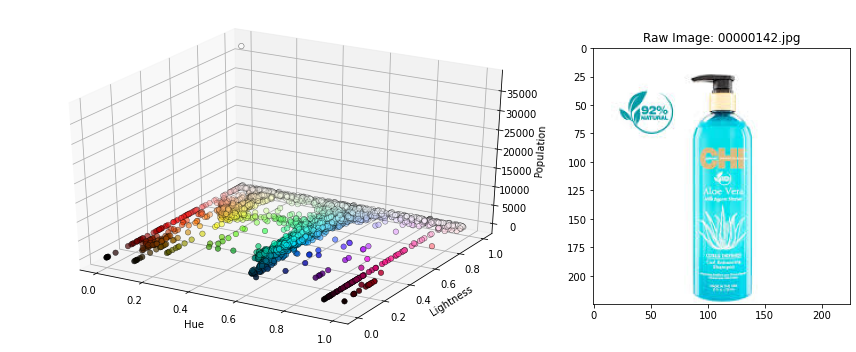

There are 8322 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 43178
This represents 85.29% of the total pixels in the image.


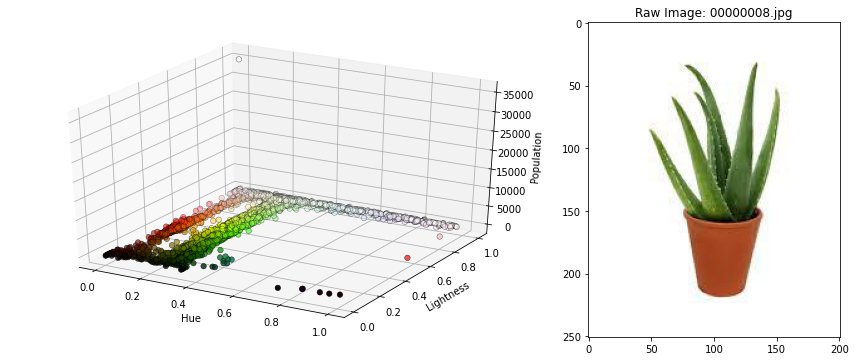

There are 7638 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 43234
This represents 85.70% of the total pixels in the image.


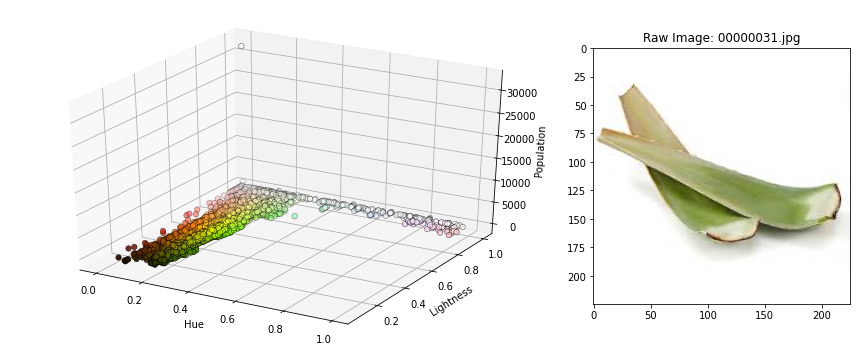

There are 9421 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 40734
This represents 80.46% of the total pixels in the image.


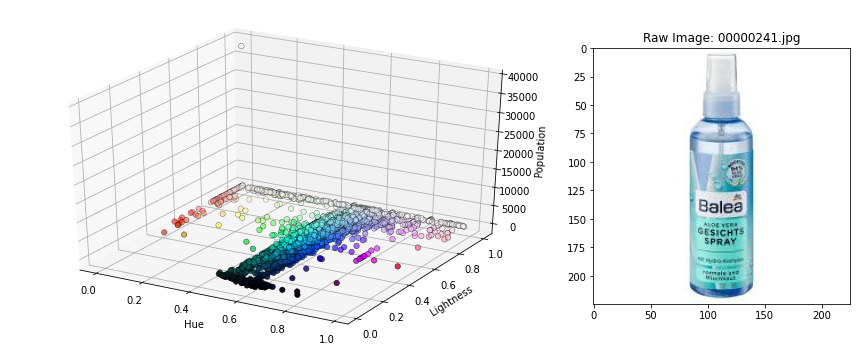

There are 8614 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 42640
This represents 84.23% of the total pixels in the image.


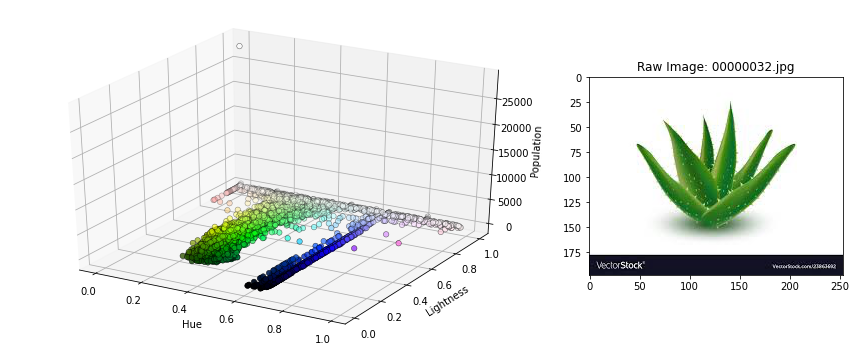

There are 9760 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 40659
This represents 80.85% of the total pixels in the image.


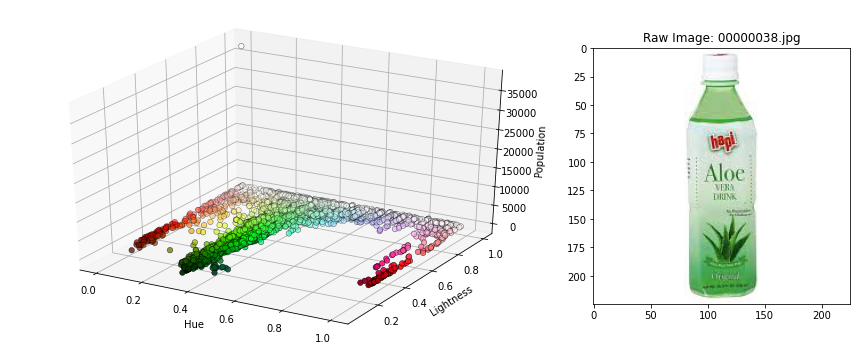

There are 8546 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 42404
This represents 83.76% of the total pixels in the image.


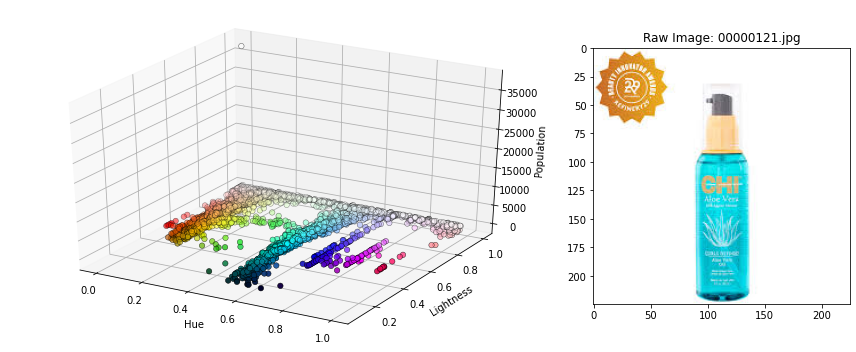

There are 9097 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 42200
This represents 83.36% of the total pixels in the image.


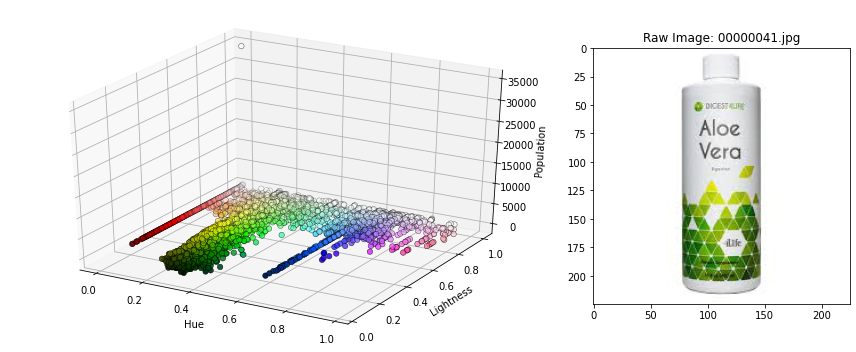

There are 7341 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 44270
This represents 87.45% of the total pixels in the image.


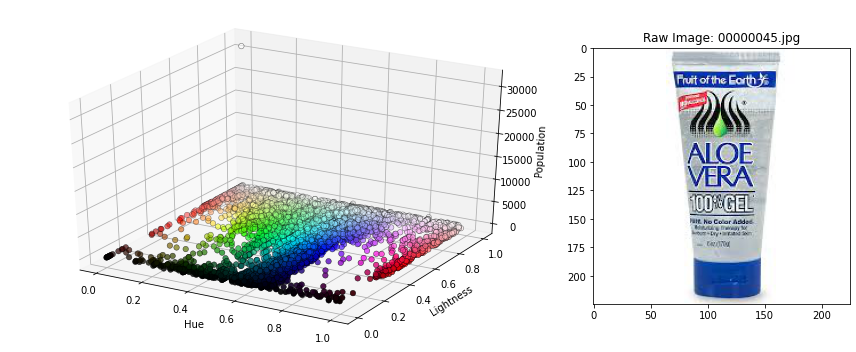

There are 11208 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 38907
This represents 76.85% of the total pixels in the image.


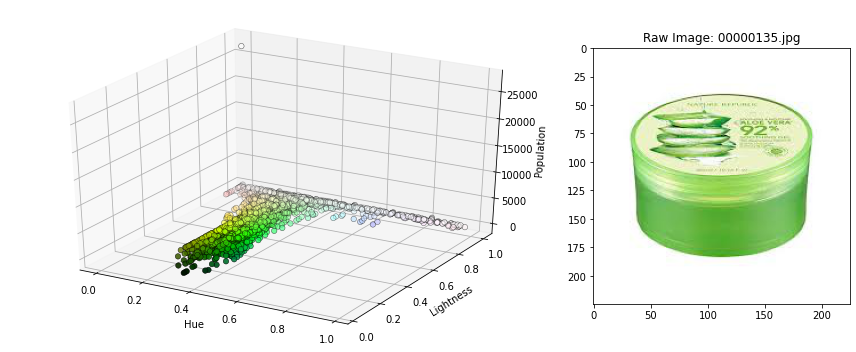

There are 13070 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 35971
This represents 71.05% of the total pixels in the image.


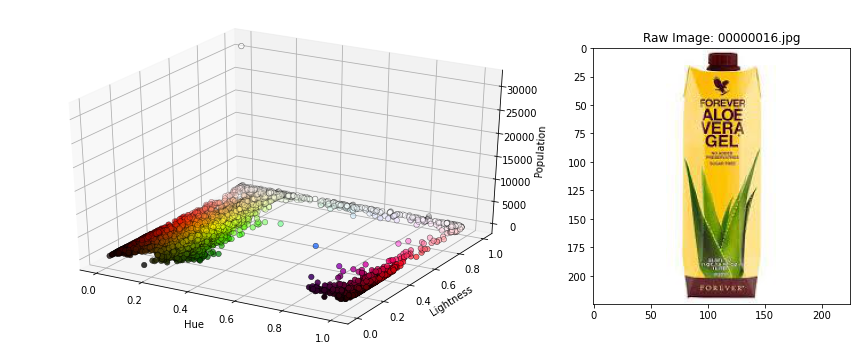

There are 11093 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 39816
This represents 78.65% of the total pixels in the image.


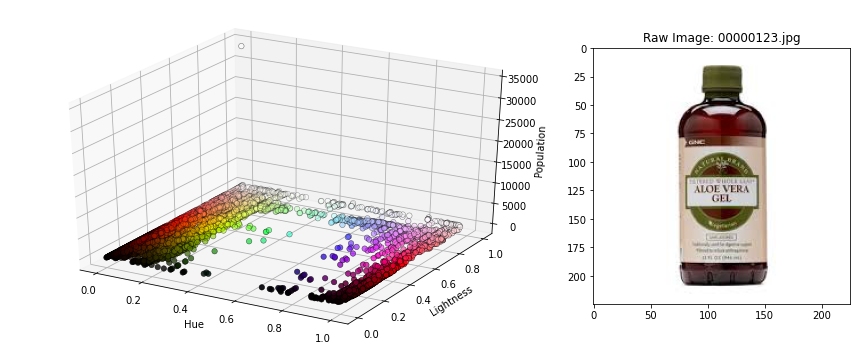

There are 9075 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 41324
This represents 81.63% of the total pixels in the image.


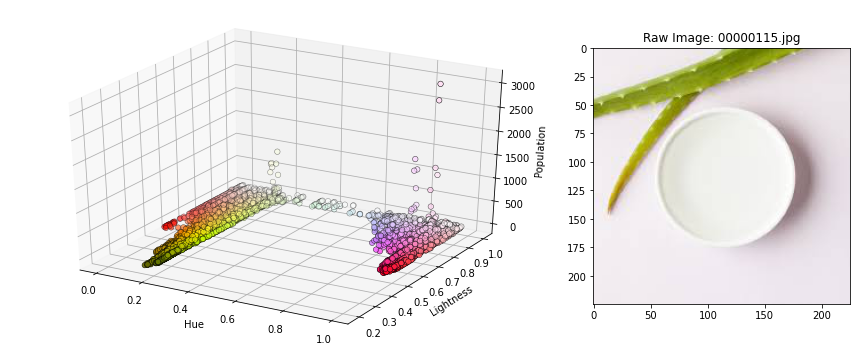

There are 8591 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 41029
This represents 81.04% of the total pixels in the image.


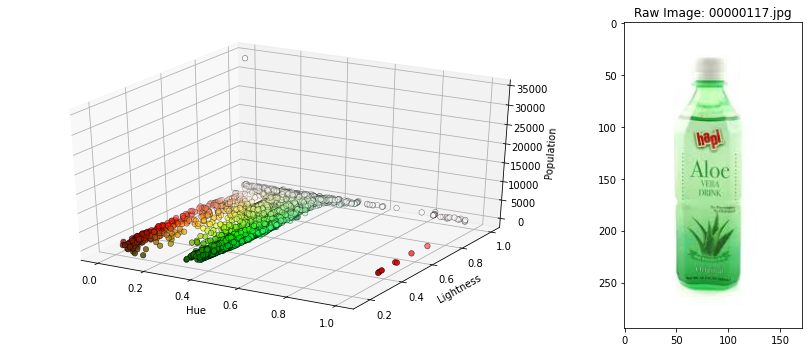

There are 9064 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 41121
This represents 81.79% of the total pixels in the image.


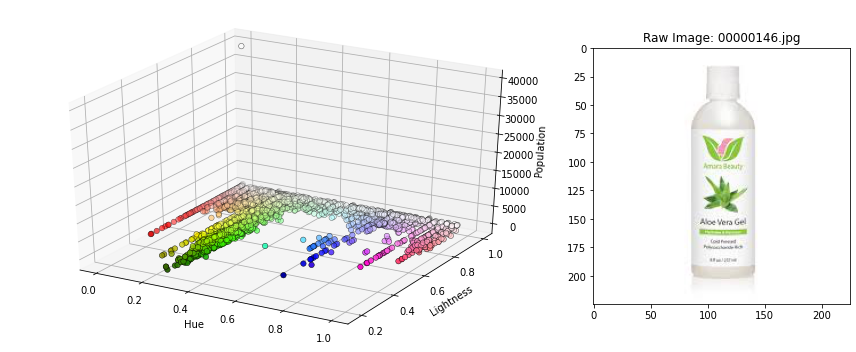

There are 3802 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 47777
This represents 94.37% of the total pixels in the image.


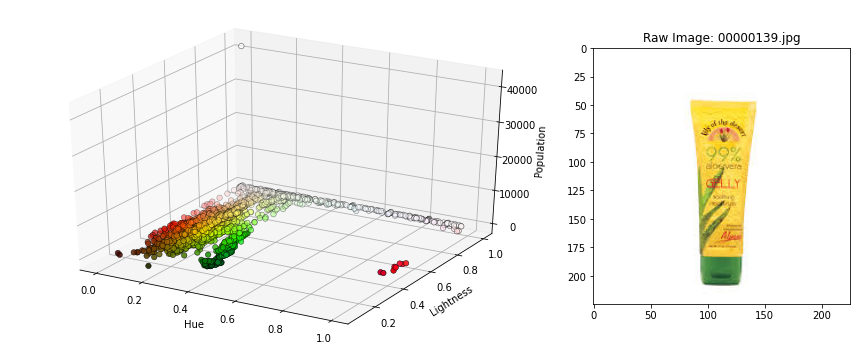

There are 6288 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 45326
This represents 89.53% of the total pixels in the image.


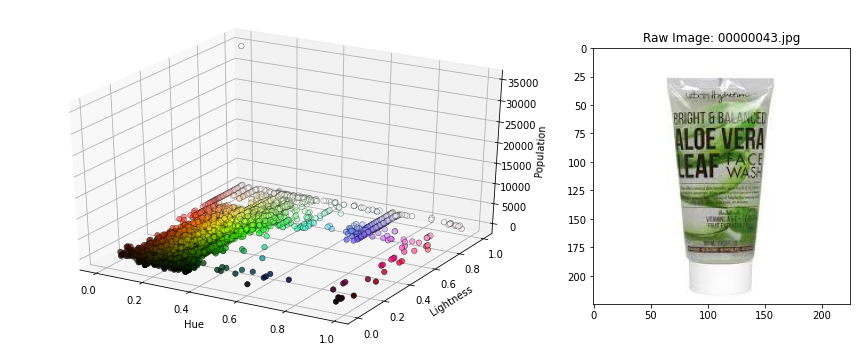

There are 9259 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 41701
This represents 82.37% of the total pixels in the image.


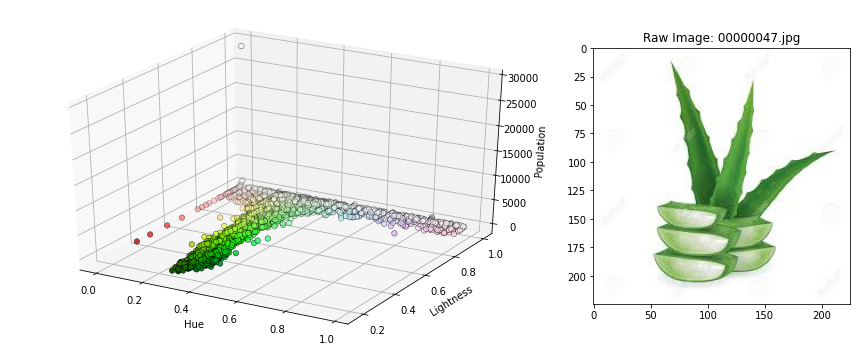

There are 10478 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 40025
This represents 79.06% of the total pixels in the image.


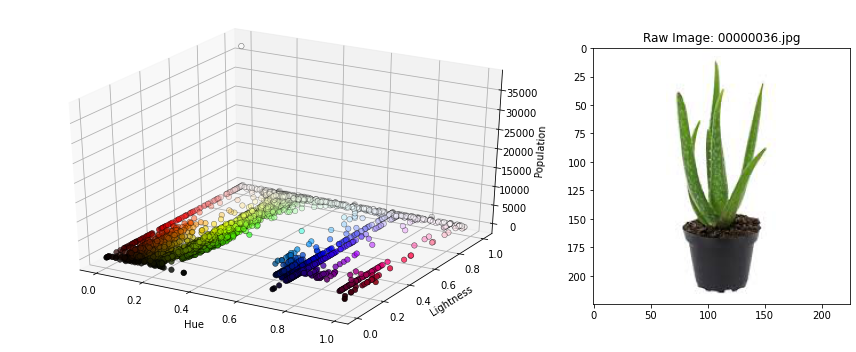

There are 5973 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 45535
This represents 89.95% of the total pixels in the image.


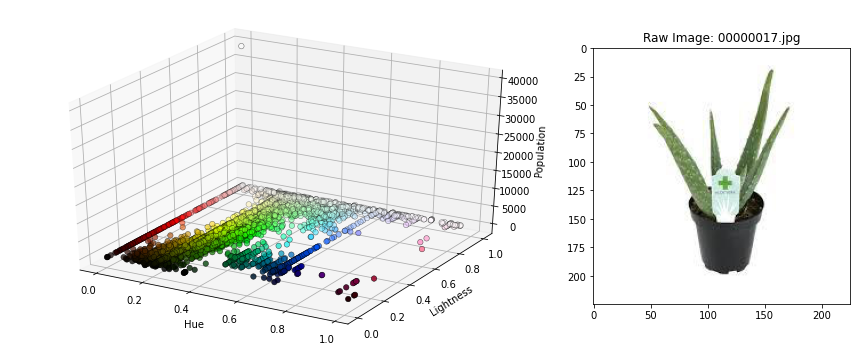

There are 5650 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 45692
This represents 90.26% of the total pixels in the image.


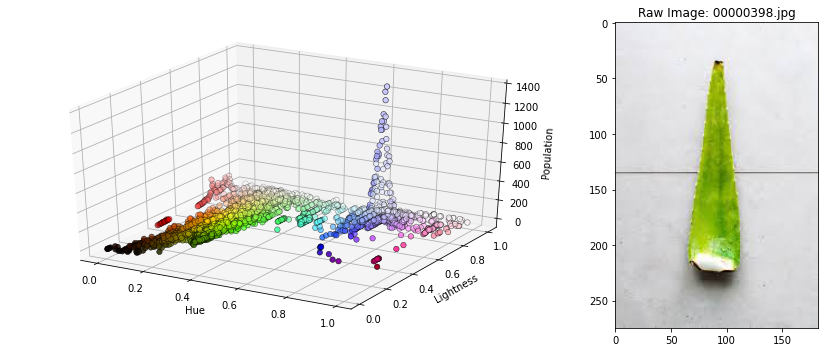

There are 7542 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 43016
This represents 85.48% of the total pixels in the image.


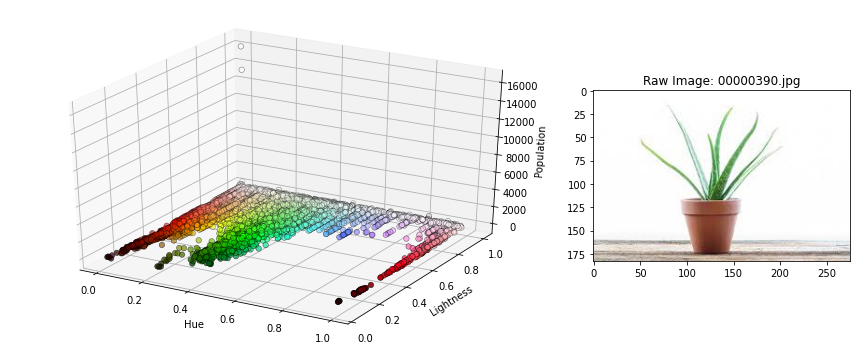

There are 9693 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 40008
This represents 79.50% of the total pixels in the image.


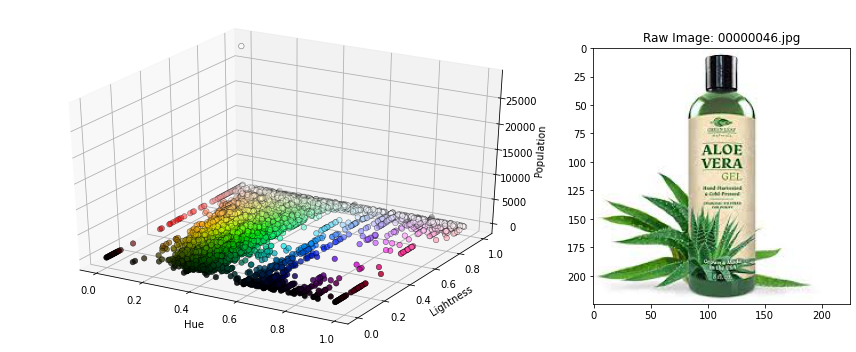

There are 13928 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 36456
This represents 72.01% of the total pixels in the image.


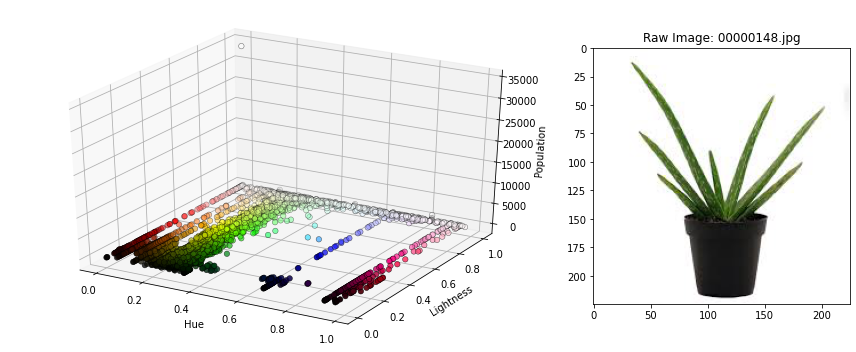

There are 6553 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 44739
This represents 88.37% of the total pixels in the image.


In [41]:
# We can visualize these images that we are confident are poor for training purposes. 
for i in range(len(df_remove)):
  image_histogram(df_remove['Artificial Images'][i], print_threshold_diagnostics = True)

Now we can scan a folder for images with text, or an excessively shallow color profile, and mark them for deletion. 

Let's clean up our database!

### Peperomia peltifolia

In [61]:
local_path = Path('/content/plant_image_database')
img_folder = local_path/'Peperomia peltifolia'

In [62]:
text_color_df = find_artificial_images(img_folder, edge_removal=True, return_diagnostics=True)

In [63]:
text_color_df

,Artificial Images,Text Found,Pixel Proportion
0,/content/plant_image_database/Peperomia peltifolia/00000026.jpg,"\n\nwil Tivcbke Wiebe I STIS\na eecaceg\n\n \n\nPeperomia Peltfolia\n\n \n\nScientific Name: Peperomia peltifolia\n\n \n\nraceac\n\nFamily:\n\n \n\nToxicity: Non-Toxic to Dogs,\nto Cats, Non-Toxic to Horses\n\n \n\nToxic Principles: Non-toxi",0.835476
1,/content/plant_image_database/Peperomia peltifolia/00000048.jpg,\n\nnee\nre Te 2,0.624653
2,/content/plant_image_database/Peperomia peltifolia/00000110.jpg,Are your\nhouseplants\npet-safe?\n\n \n\nChen the lal dd Kd\n\n,0.554875
3,/content/plant_image_database/Peperomia peltifolia/00000133.jpg,"\n\nGROW MAJESTY PALMINDOORS”\n\n/ Vy oT"" y",0.708097
4,/content/plant_image_database/Peperomia peltifolia/00000142.jpg,ShopSucculents\n\nLargest Selection of Succulents\nand Planters Online\n\nSia) sa Of\n\n~,0.791235
5,/content/plant_image_database/Peperomia peltifolia/00000146.jpg,&\nWhite € ‘Haven\n-eRek ee\nVETERINARY HOSPITA,1.000000
6,/content/plant_image_database/Peperomia peltifolia/00000252.jpg,botanical\n\nINTERES T'S.\n\na HIGH-QUALITY SEED\n\n,0.507258
7,/content/plant_image_database/Peperomia peltifolia/00000253.jpg,DAK It euseplonts\n\nEartht\nHOW TO CARE\n\nFOR\nHOUSEPLANTS\n\n,0.889424
8,/content/plant_image_database/Peperomia peltifolia/00000262.jpg,,0.873409
9,/content/plant_image_database/Peperomia peltifolia/00000272.jpg,ANIMAL POISON\nCONTROL CENTER | ASIPCA\n\n888-426-4435. Where knowledge is your lifelin,0.885131


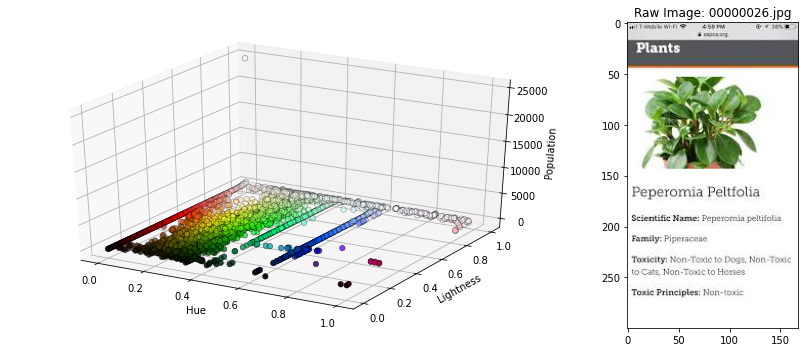

There are 8997 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 42108
This represents 83.55% of the total pixels in the image.


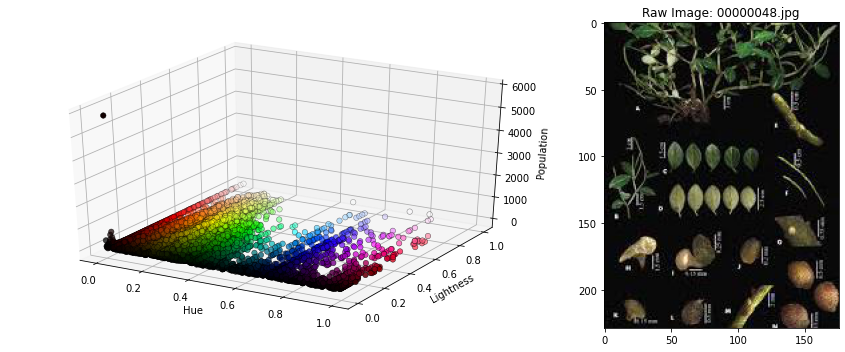

There are 13260 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 25176
This represents 62.47% of the total pixels in the image.


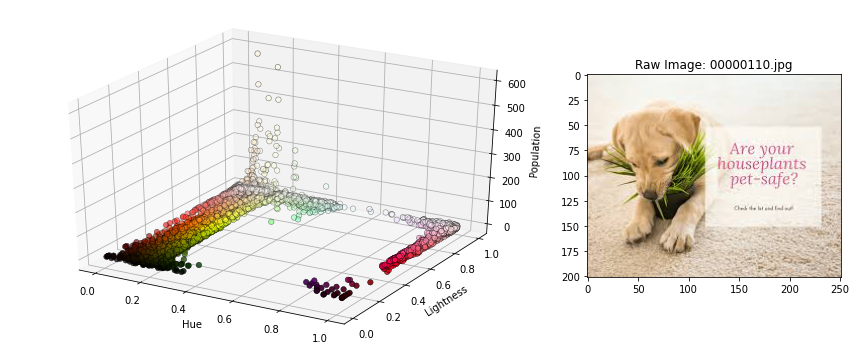

There are 15234 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 27994
This represents 55.49% of the total pixels in the image.


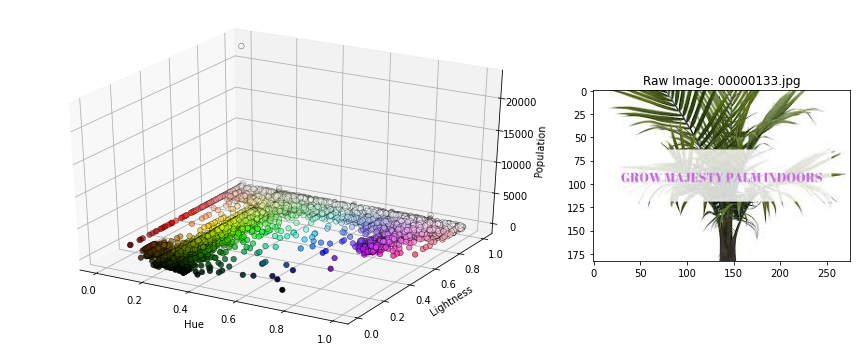

There are 12819 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 35635
This represents 70.81% of the total pixels in the image.


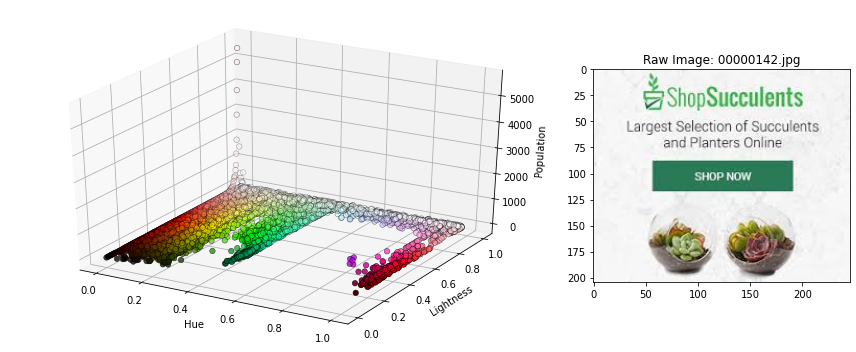

There are 10552 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 39902
This represents 79.12% of the total pixels in the image.


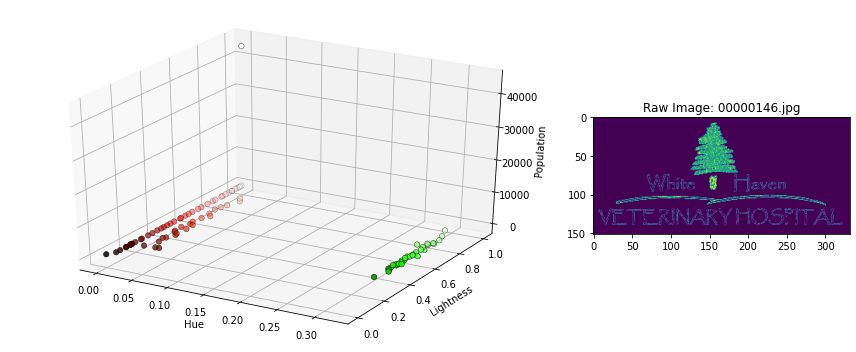

There are 98 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 50464
This represents 100.00% of the total pixels in the image.


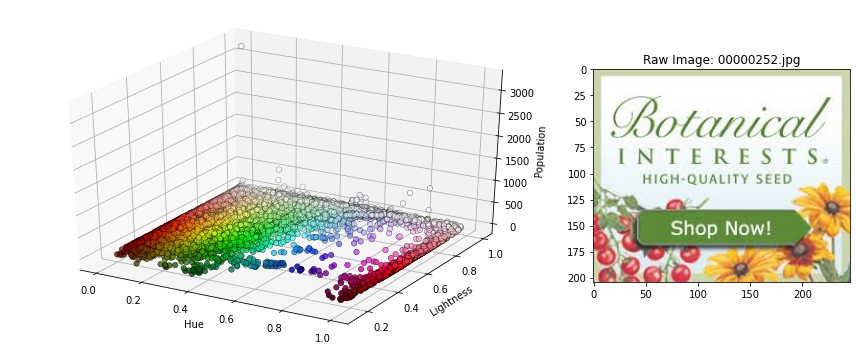

There are 21812 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 25581
This represents 50.73% of the total pixels in the image.


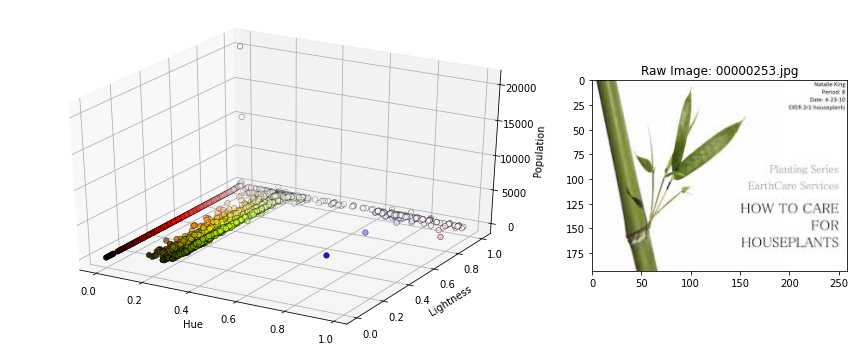

There are 5682 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 44690
This represents 88.94% of the total pixels in the image.


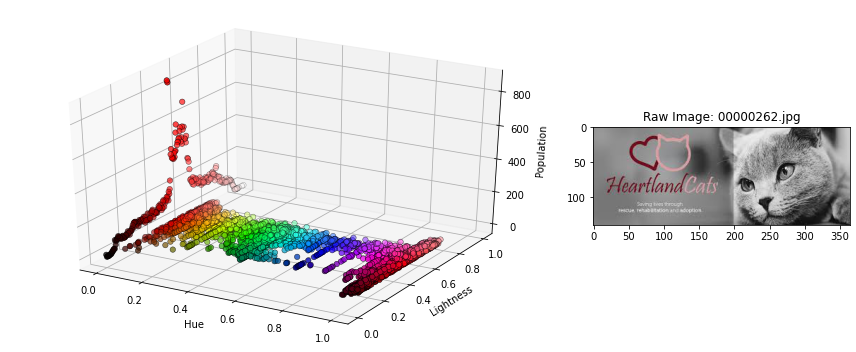

There are 6696 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 44191
This represents 87.34% of the total pixels in the image.


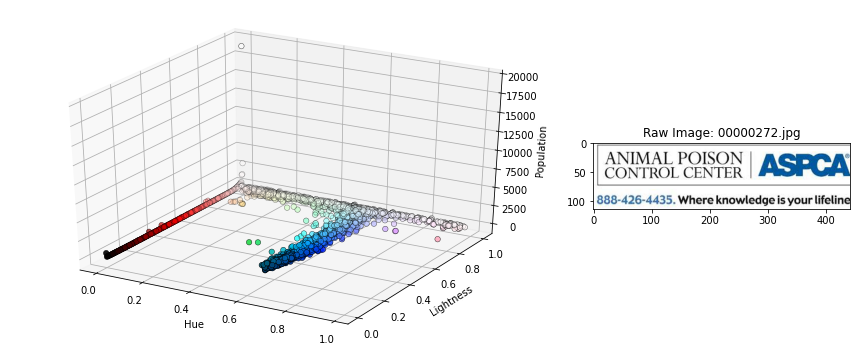

There are 6181 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 44600
This represents 88.51% of the total pixels in the image.


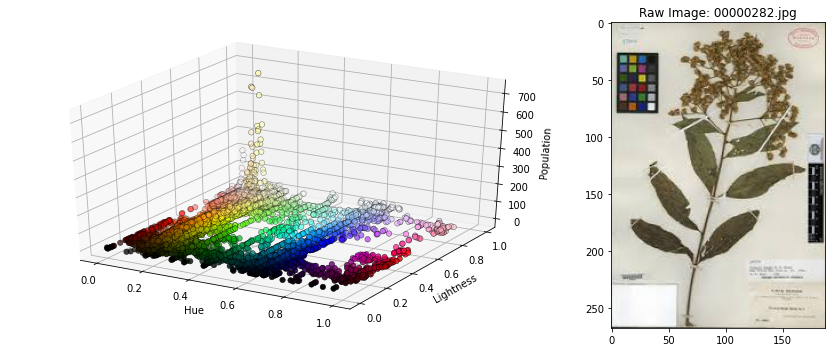

There are 13937 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 29284
This represents 58.12% of the total pixels in the image.


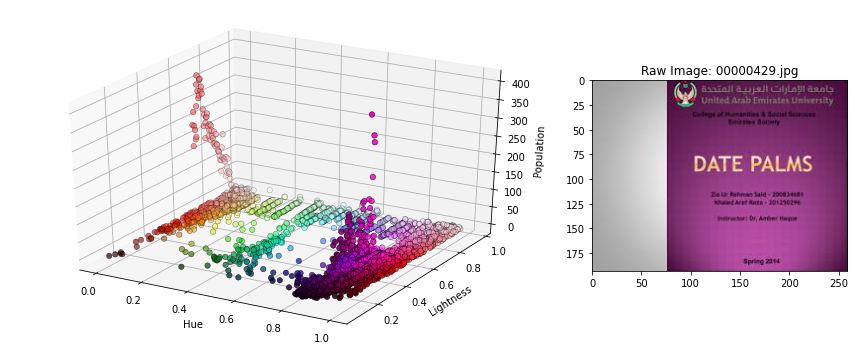

There are 10149 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 36406
This represents 72.46% of the total pixels in the image.


In [64]:
# We can visualize these images that have text detected.
for i in range(len(text_color_df)):
  image_histogram(text_color_df['Artificial Images'][i], print_threshold_diagnostics = True)

In [65]:
df_remove = find_artificial_images(img_folder)

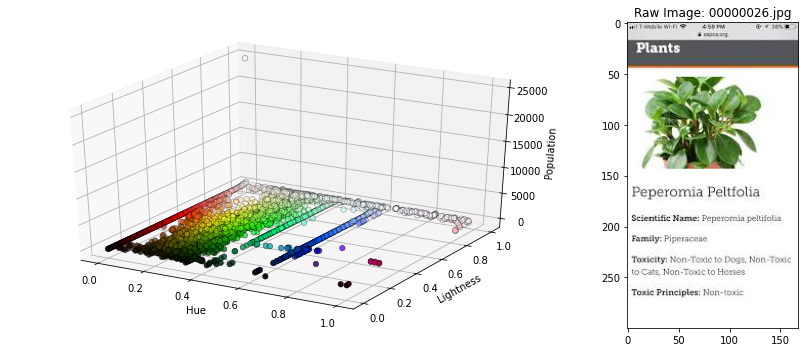

There are 8997 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 42108
This represents 83.55% of the total pixels in the image.


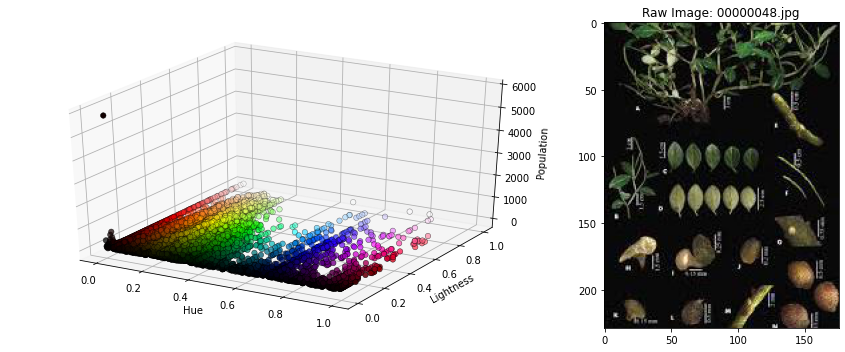

There are 13260 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 25176
This represents 62.47% of the total pixels in the image.


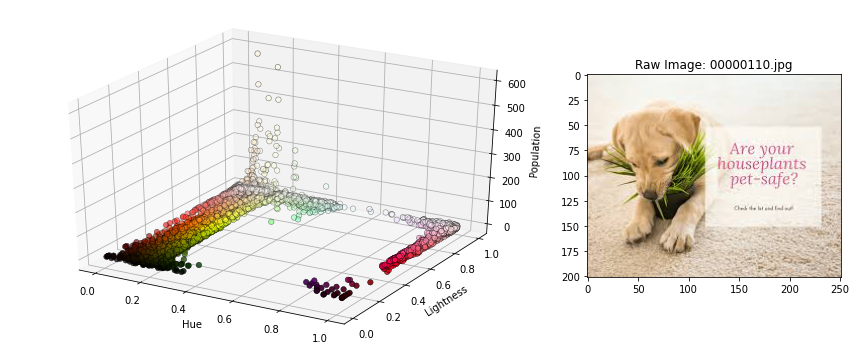

There are 15234 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 27994
This represents 55.49% of the total pixels in the image.


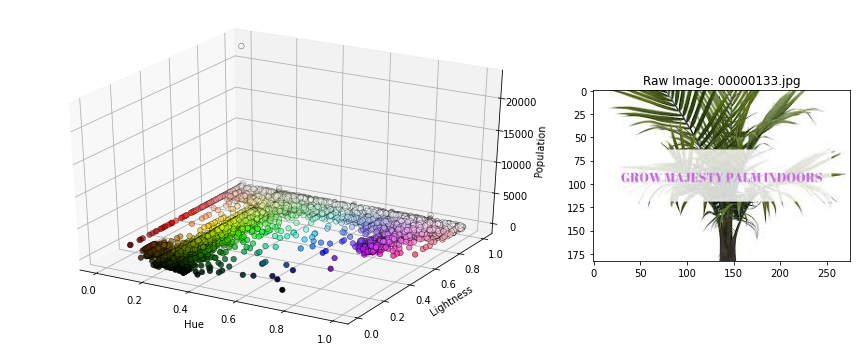

There are 12819 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 35635
This represents 70.81% of the total pixels in the image.


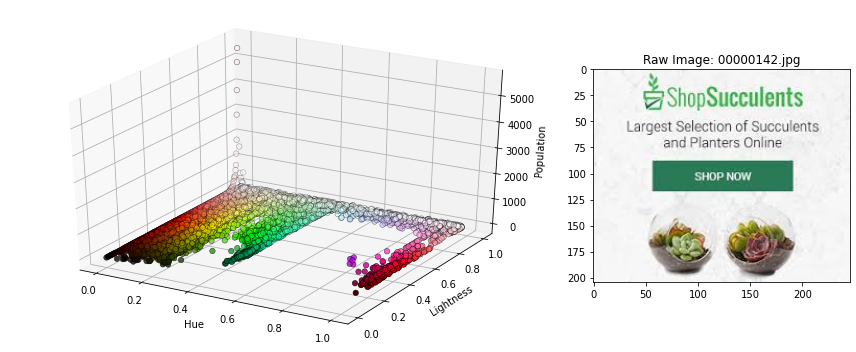

There are 10552 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 39902
This represents 79.12% of the total pixels in the image.


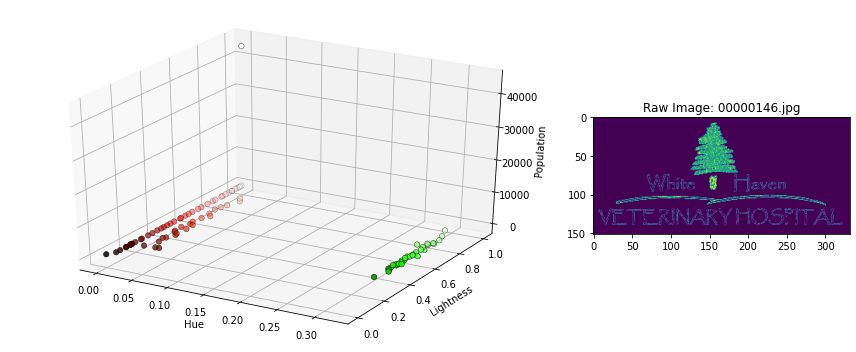

There are 98 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 50464
This represents 100.00% of the total pixels in the image.


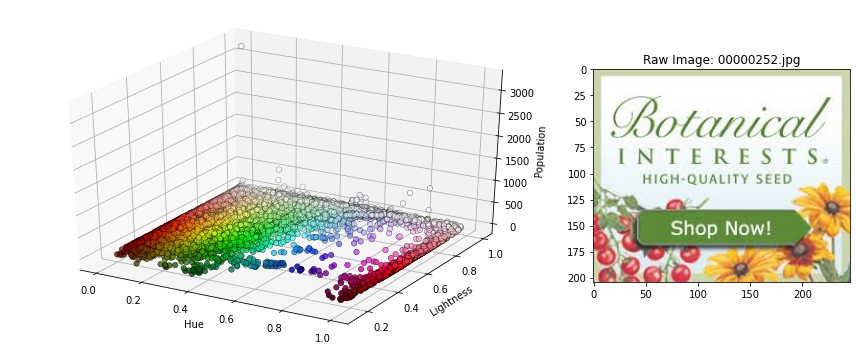

There are 21812 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 25581
This represents 50.73% of the total pixels in the image.


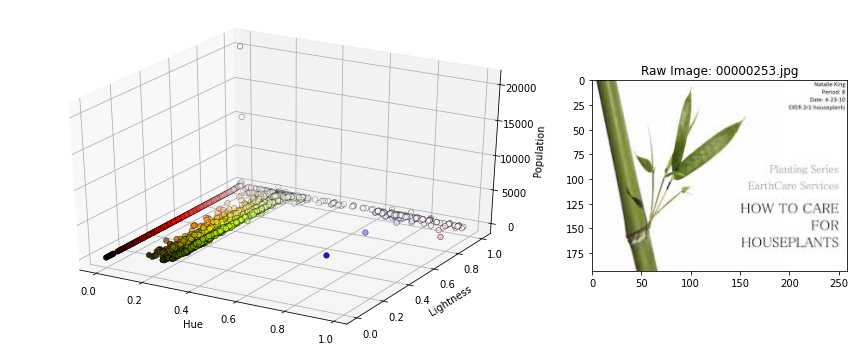

There are 5682 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 44690
This represents 88.94% of the total pixels in the image.


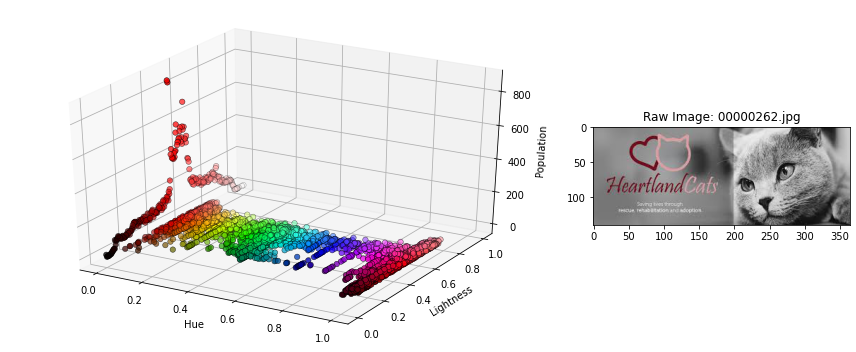

There are 6696 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 44191
This represents 87.34% of the total pixels in the image.


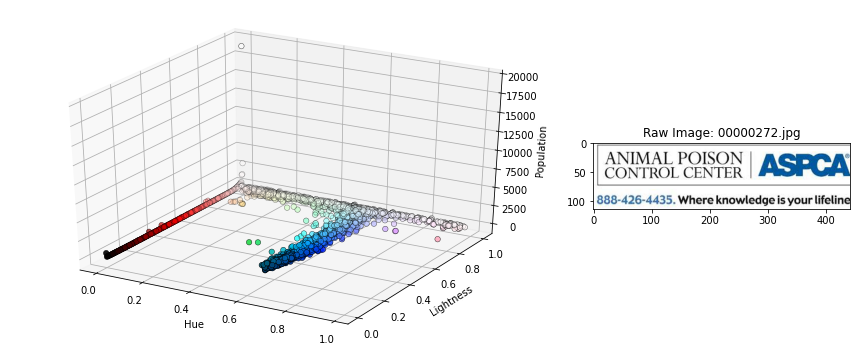

There are 6181 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 44600
This represents 88.51% of the total pixels in the image.


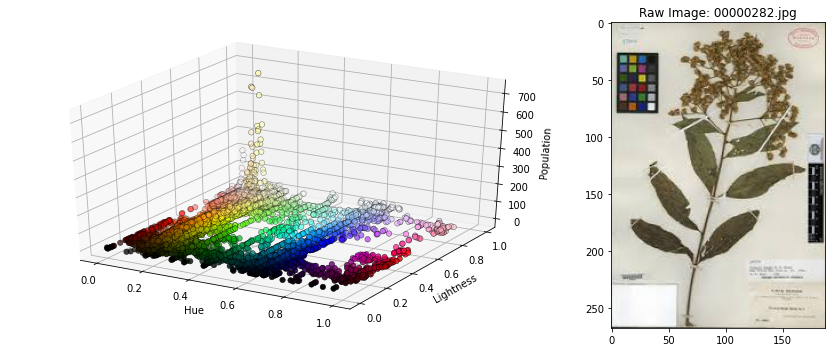

There are 13937 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 29284
This represents 58.12% of the total pixels in the image.


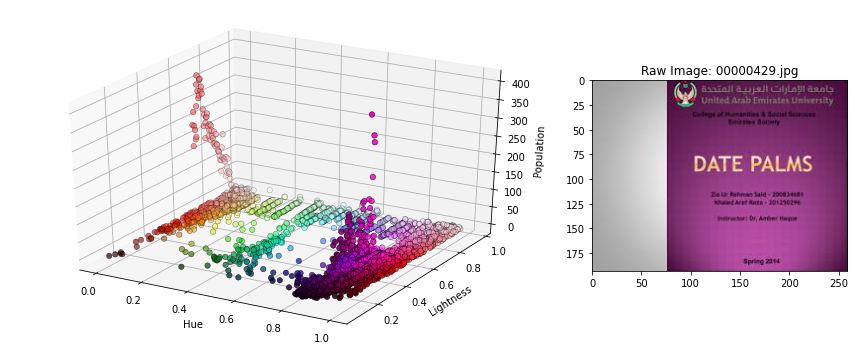

There are 10149 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 36406
This represents 72.46% of the total pixels in the image.


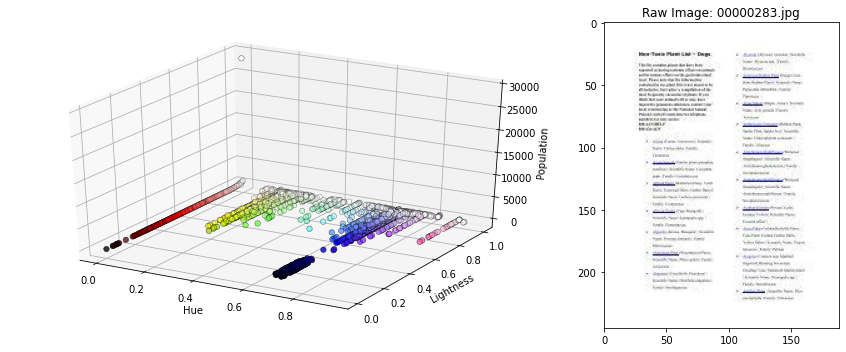

There are 2681 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 44545
This represents 96.20% of the total pixels in the image.


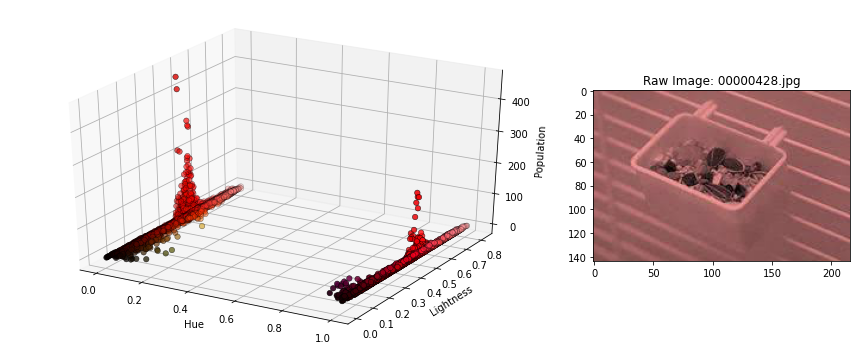

There are 6130 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 23376
This represents 75.15% of the total pixels in the image.


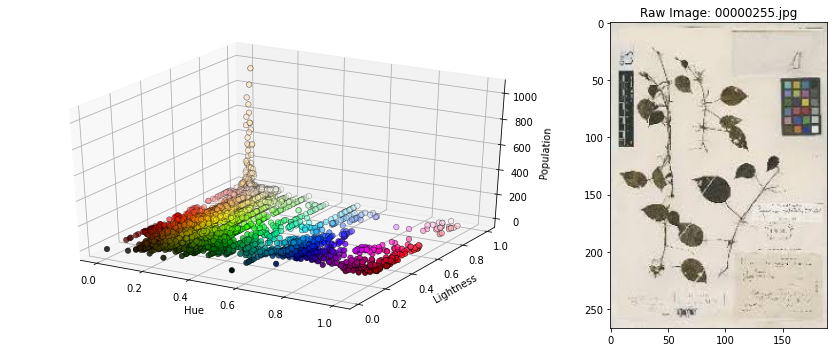

There are 7577 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 39584
This represents 78.44% of the total pixels in the image.


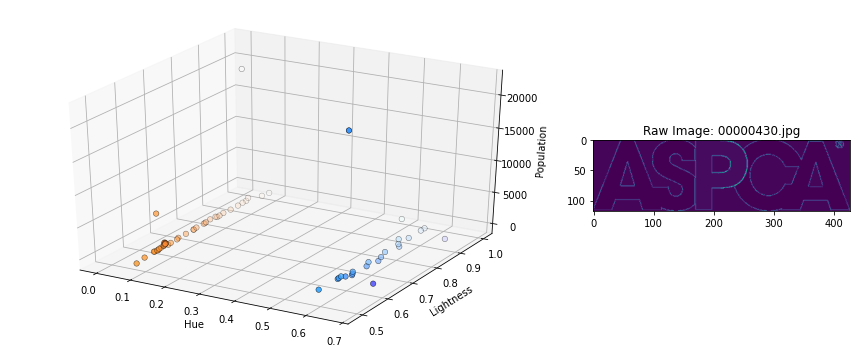

There are 66 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 50268
This represents 100.00% of the total pixels in the image.


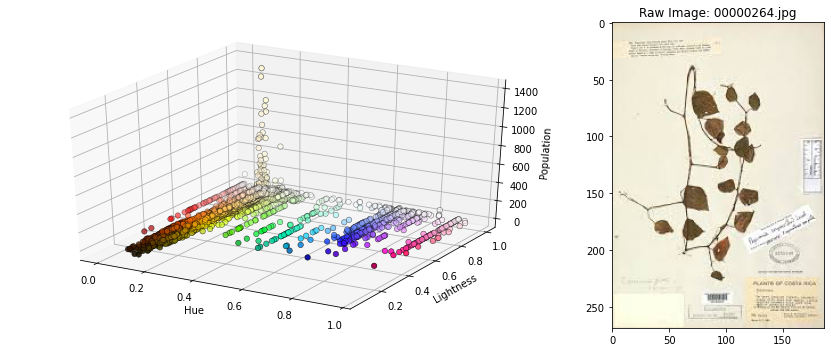

There are 8767 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 38107
This represents 75.75% of the total pixels in the image.


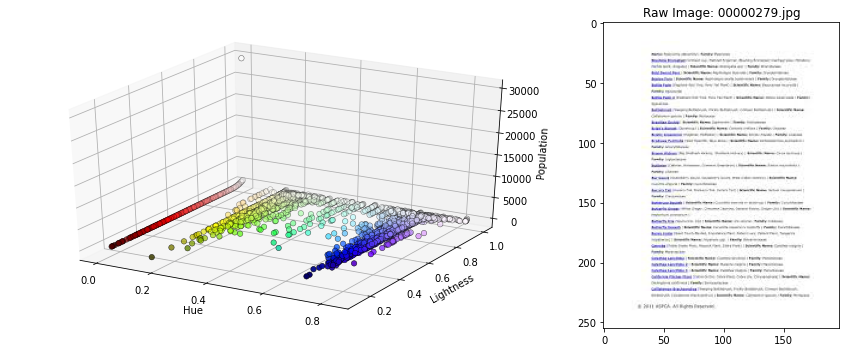

There are 3292 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 47943
This represents 95.44% of the total pixels in the image.


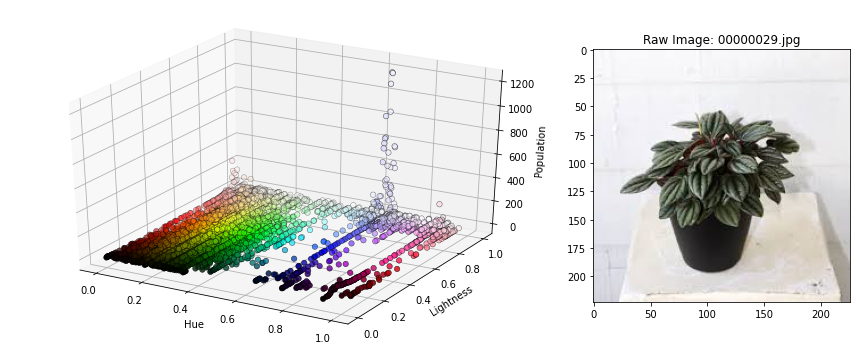

There are 9430 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 35550
This represents 70.54% of the total pixels in the image.


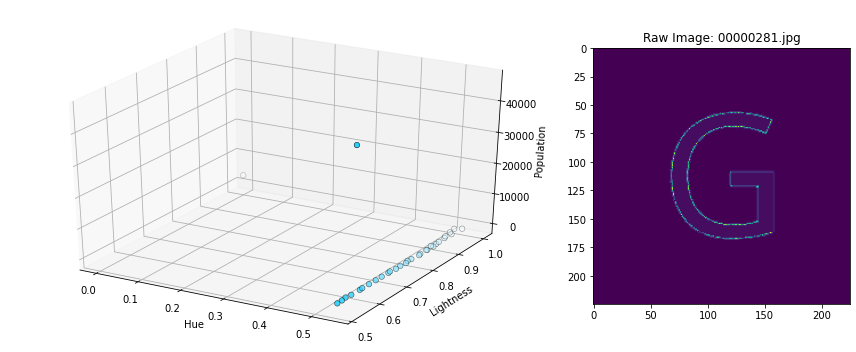

There are 32 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 50625
This represents 100.00% of the total pixels in the image.


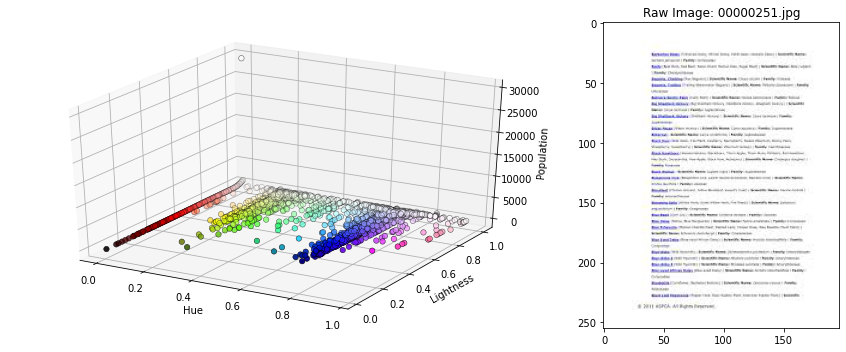

There are 3518 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 47717
This represents 94.99% of the total pixels in the image.


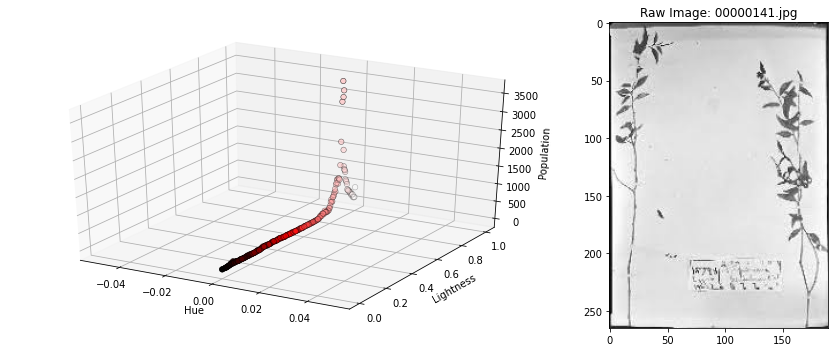

There are 253 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 50350
This represents 100.00% of the total pixels in the image.


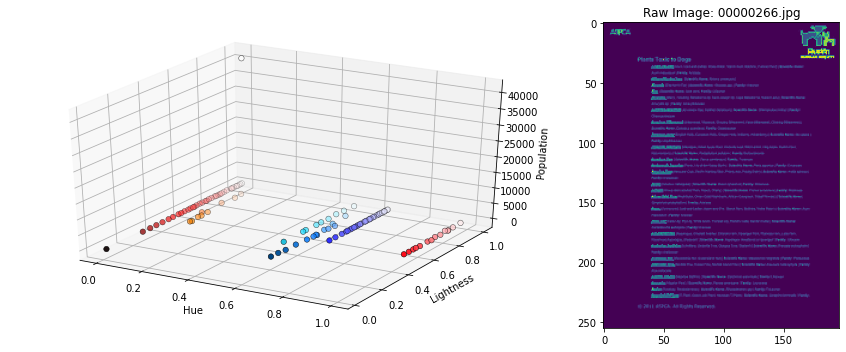

There are 113 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 50235
This represents 100.00% of the total pixels in the image.


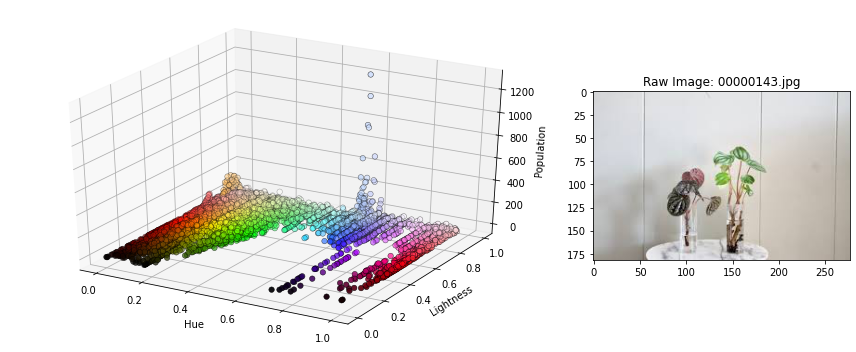

There are 8103 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 40343
This represents 80.02% of the total pixels in the image.


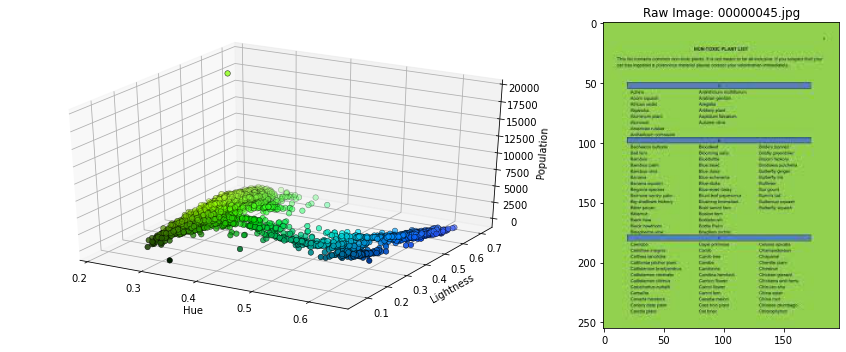

There are 10038 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 35952
This represents 71.57% of the total pixels in the image.


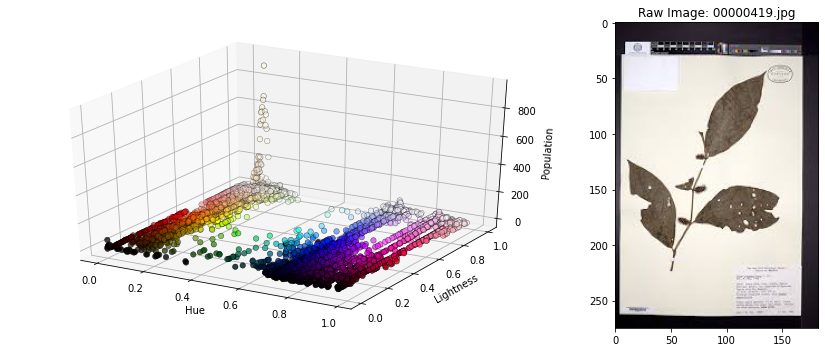

There are 7421 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 37987
This represents 75.48% of the total pixels in the image.


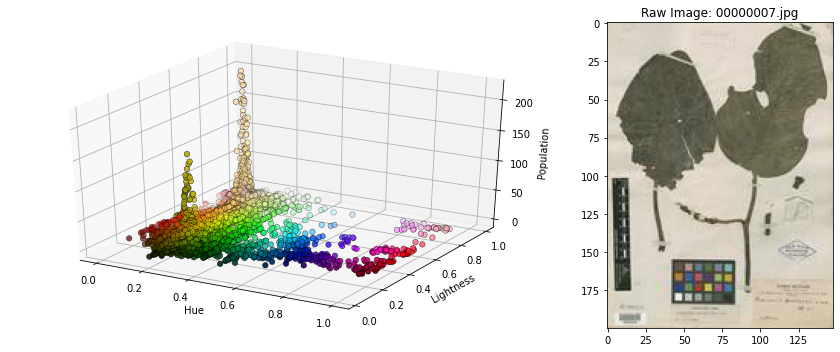

There are 5939 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 22274
This represents 75.25% of the total pixels in the image.


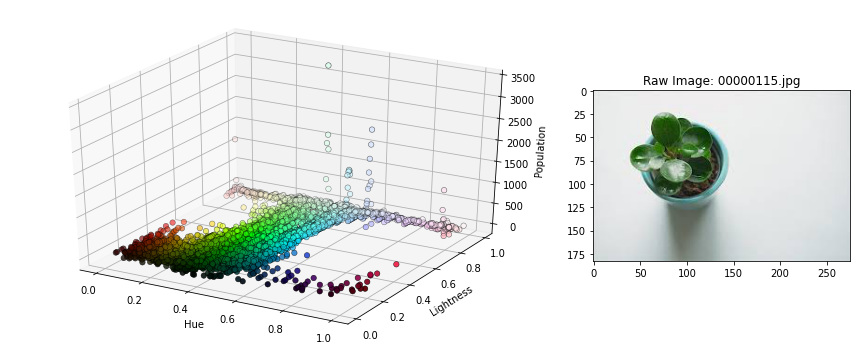

There are 8967 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 41537
This represents 82.54% of the total pixels in the image.


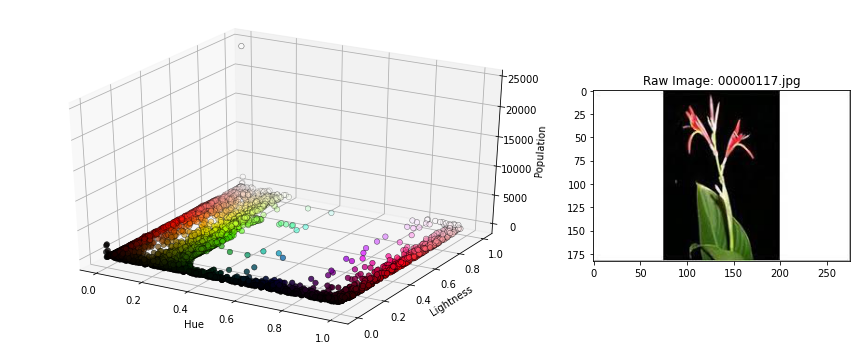

There are 6168 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 45151
This represents 89.72% of the total pixels in the image.


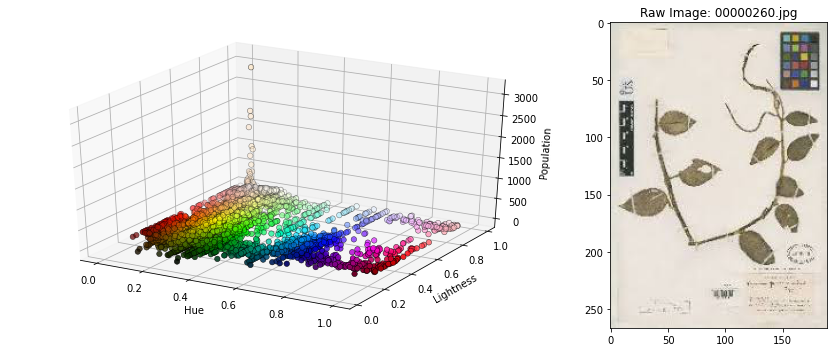

There are 8950 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 38777
This represents 76.84% of the total pixels in the image.


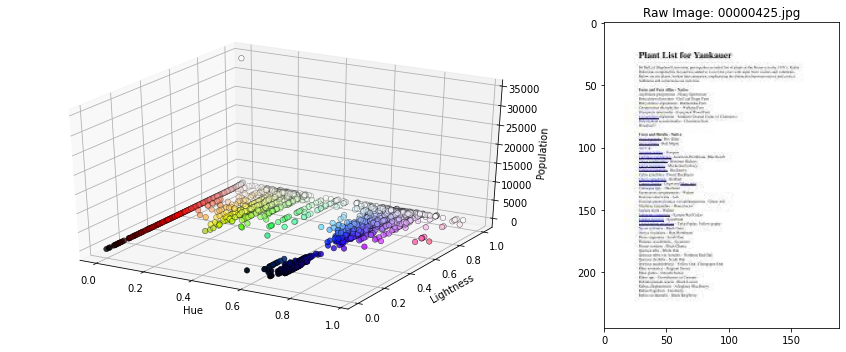

There are 2499 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 44806
This represents 96.76% of the total pixels in the image.


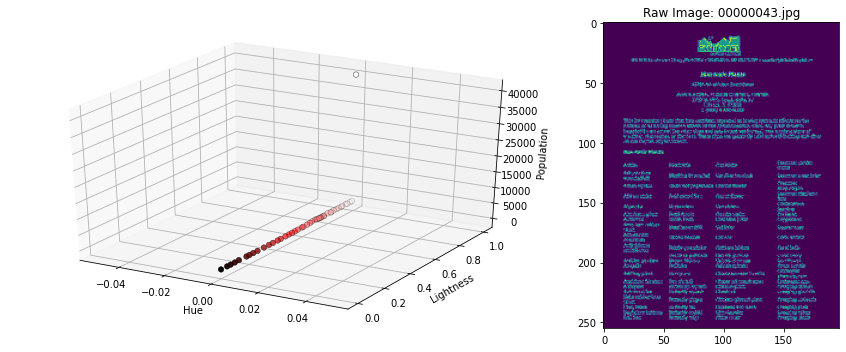

There are 46 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 50235
This represents 100.00% of the total pixels in the image.


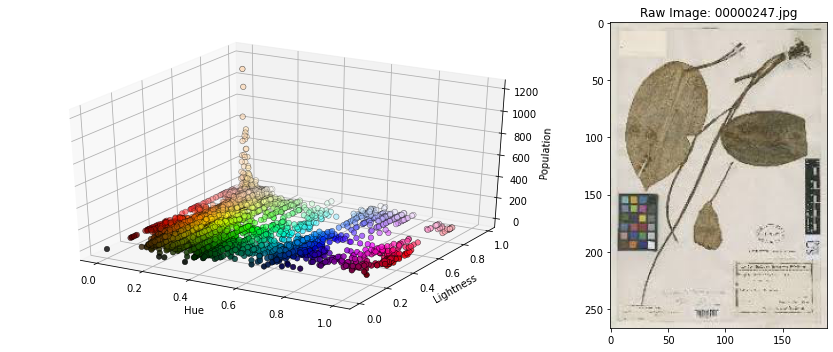

There are 9795 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 35702
This represents 70.75% of the total pixels in the image.


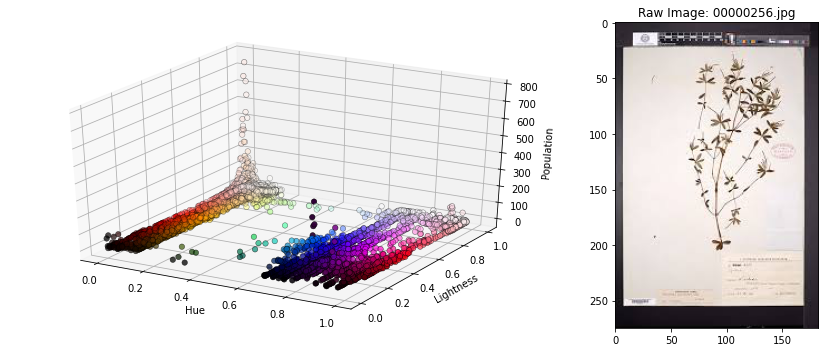

There are 7672 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 37601
This represents 74.72% of the total pixels in the image.


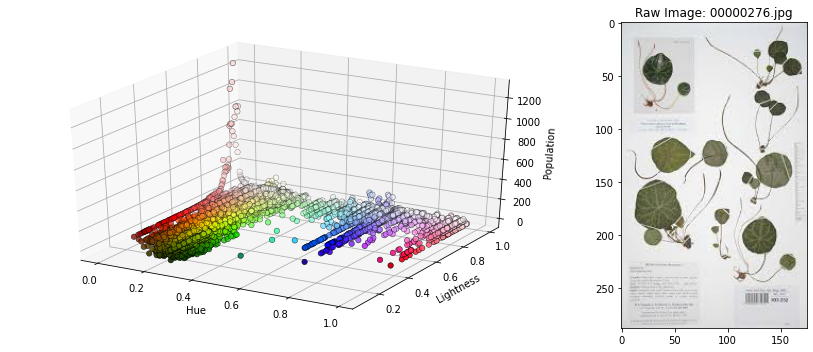

There are 8449 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 38722
This represents 76.83% of the total pixels in the image.


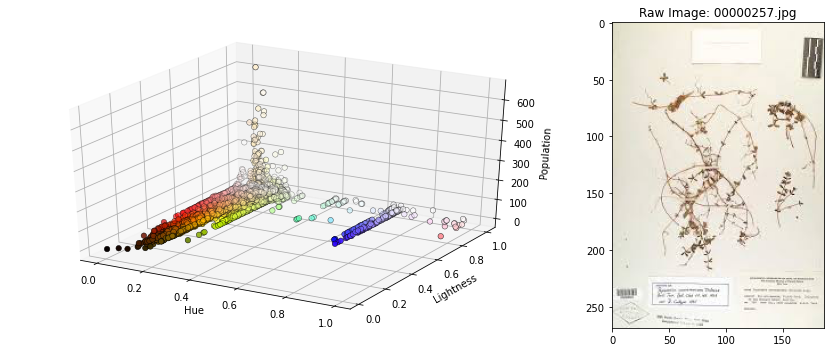

There are 7398 hue/lightness pairs in this image.
Population of 1000 hue/lightness pairs with the largest populations = 39911
This represents 79.34% of the total pixels in the image.


In [66]:
# We can visualize these images that we are confident are poor for training purposes. 
for i in range(len(df_remove)):
  image_histogram(df_remove['Artificial Images'][i], print_threshold_diagnostics = True)

## Delete the unwanted cross-section

In [ ]:
# If your zip file is on your google drive - download it into the current kernel
!cp '/content/drive/My Drive/Houseplant Classifier/plant_images_database.zip' 'plant_images_database.zip'
# This code snippet unzips a zip file to a specified destination
!unzip "/content/plant_images_database.zip" -d "/content/drive/My Drive/Houseplant Classifier/plant_images_autoclean";

In [ ]:
path = Path('/content/drive/My Drive/Houseplant Classifier/plant_images_autoclean/plant_image_database')
folder_list = sorted(np.asarray(path.ls()))

In [37]:
from tqdm.notebook import tqdm
#Sample run - only 10 folders
for img_folder in tqdm(folder_list[:10]):
  print(f'Examining {img_folder}')
  if len(img_folder.ls()) == 150:
    df_remove = find_artificial_images(img_folder, edge_removal = True)
    print(f'Removing {len(df_remove)} images from {img_folder}.')
    for i in range(len(df_remove)):
      # Path.unlink will delete these images from their directories. 
      df_remove['Artificial Images'][i].unlink()
  else:
    print(f'{img_folder} already done.')

Examining /content/drive/My Drive/Houseplant Classifier/plant_images_autoclean/plant_image_database/Abronia fragrans



Removing 17 images from /content/drive/My Drive/Houseplant Classifier/plant_images_autoclean/plant_image_database/Abronia fragrans.
Examining /content/drive/My Drive/Houseplant Classifier/plant_images_autoclean/plant_image_database/Abrus precatorius



Removing 9 images from /content/drive/My Drive/Houseplant Classifier/plant_images_autoclean/plant_image_database/Abrus precatorius.
Examining /content/drive/My Drive/Houseplant Classifier/plant_images_autoclean/plant_image_database/Acalypha hispida



Removing 4 images from /content/drive/My Drive/Houseplant Classifier/plant_images_autoclean/plant_image_database/Acalypha hispida.
Examining /content/drive/My Drive/Houseplant Classifier/plant_images_autoclean/plant_image_database/Acalypha wilkesiana



Removing 3 images from /content/drive/My Drive/Houseplant Classifier/plant_images_autoclean/plant_image_database/Acalypha wilkesiana.
Examining /content/drive/My Drive/Houseplant Classifier/plant_images_autoclean/plant_image_database/Acanthus



Removing 6 images from /content/drive/My Drive/Houseplant Classifier/plant_images_autoclean/plant_image_database/Acanthus.
Examining /content/drive/My Drive/Houseplant Classifier/plant_images_autoclean/plant_image_database/Acer rubrum



Removing 4 images from /content/drive/My Drive/Houseplant Classifier/plant_images_autoclean/plant_image_database/Acer rubrum.
Examining /content/drive/My Drive/Houseplant Classifier/plant_images_autoclean/plant_image_database/Acer tataricum subsp. ginnala



Removing 9 images from /content/drive/My Drive/Houseplant Classifier/plant_images_autoclean/plant_image_database/Acer tataricum subsp. ginnala.
Examining /content/drive/My Drive/Houseplant Classifier/plant_images_autoclean/plant_image_database/Achillea millefolium



Removing 12 images from /content/drive/My Drive/Houseplant Classifier/plant_images_autoclean/plant_image_database/Achillea millefolium.
Examining /content/drive/My Drive/Houseplant Classifier/plant_images_autoclean/plant_image_database/Adenium obesum



Removing 3 images from /content/drive/My Drive/Houseplant Classifier/plant_images_autoclean/plant_image_database/Adenium obesum.
Examining /content/drive/My Drive/Houseplant Classifier/plant_images_autoclean/plant_image_database/Adonidia merrillii



Removing 5 images from /content/drive/My Drive/Houseplant Classifier/plant_images_autoclean/plant_image_database/Adonidia merrillii.



# (Autoclean) Train Model

We now compare these results to the dataset generated by the automatic cleaning process, that removes artificial images. 

In [ ]:
# Get and unzip the automatically cleaned images
!cp '/content/drive/My Drive/Houseplant Classifier/plant_images_database_cleaned.zip' 'plant_images_database_cleaned.zip'
# This code snippet unzips a zip file to a specified destination
!unzip "/content/plant_images_database_cleaned.zip" -d "/content";

In [ ]:
learn = create_simple_cnn_learner(pct_images=1, 
                           deterministic=True, 
                           size=224,
                           img_path ='/content/plant_images_database_cleaned/',
                           split_path = '/content/plant_image_database/',
                           log_name = 'artificalcleanbaseline.csv')

Random state set:101, cuda used: True
Split Path defined, preparing pseudo stratified split.
Creating path:label dataframe from /content/plant_image_database/, using 100.00% of the images (77700 images.) Shuffle = False.
Preparing stratified 5 fold split, random state is 101. Returning fold 0.
Creating path:label dataframe from /content/plant_images_database_cleaned/, using 100.00% of the images (71186 images.) Shuffle = False.
We have 518 classes, with a training set of size 56937, and a validation set of size 14249
The main split has 80.00% training data with 518 classes, the reduced split has 79.98 % training data, with 518 classes.


In [ ]:
def baseline_fit(learn):
  print(f'Freezing model body')
  learn.freeze()
  enumerate_params(learn)
  learn.fit_one_cycle(10, 1e-02)
  learn.save('stage-1-artificalclean')
  print(f'Unfreezing model body')
  learn.unfreeze()
  enumerate_params(learn)
  learn.fit_one_cycle(10, lr_max=slice(1e-5, 1e-4))
  learn.save('stage-2-artificalclean')

Freezing model body
22,077,248 total parameters.
809,600 training parameters.


epoch,train_loss,valid_loss,accuracy,top_k_accuracy,time
0,4.066135,3.443952,0.282055,0.537792,04:35
1,3.620033,3.345946,0.288301,0.547056,04:31
2,3.385880,3.140837,0.322689,0.588603,04:29
3,3.092042,2.743086,0.396238,0.664257,04:29
4,2.933021,2.526319,0.444312,0.700821,04:27
5,2.716978,2.355608,0.473156,0.729385,04:25
6,2.475826,2.198448,0.504316,0.752193,04:26
7,2.330095,2.099297,0.527055,0.768826,04:26
8,2.132319,2.039341,0.538354,0.776405,04:25
9,2.065613,2.029980,0.539617,0.779423,04:23


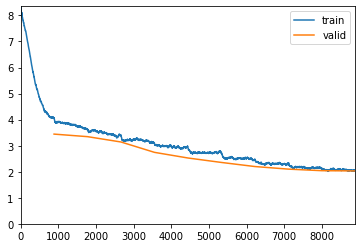

Unfreezing model body
22,077,248 total parameters.
22,077,248 training parameters.


epoch,train_loss,valid_loss,accuracy,top_k_accuracy,time
0,2.042108,2.025664,0.542775,0.778019,04:30
1,2.052168,2.003138,0.546565,0.783002,04:31
2,1.966261,1.951636,0.558846,0.792828,04:30
3,1.907252,1.902009,0.562355,0.797670,04:31
4,1.827825,1.864161,0.568882,0.804828,04:30
5,1.741223,1.829392,0.577584,0.809250,04:23
6,1.718916,1.796229,0.585655,0.814724,04:20
7,1.662207,1.778801,0.588111,0.816408,04:15
8,1.554771,1.774996,0.590989,0.817180,04:13
9,1.547600,1.769025,0.590849,0.818724,04:17


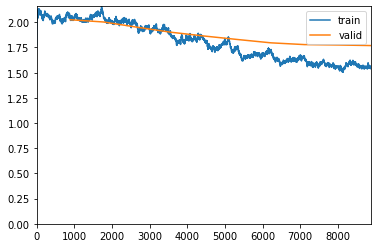

In [ ]:
baseline_fit(learn)

# Interpretation - Autocleaned

Let's re-create the learner and load in the results of training. 

In [16]:
# Get and unzip the automatically cleaned images
!cp '/content/drive/My Drive/Houseplant Classifier/plant_images_database_cleaned.zip' 'plant_images_database_cleaned.zip'
# This code snippet unzips a zip file to a specified destination
!unzip "/content/plant_images_database_cleaned.zip" -d "/content";

Archive:  /content/plant_images_database_cleaned.zip
replace /content/plant_images_database_cleaned/Abronia fragrans/00000000.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: 

In [17]:
learn = create_simple_cnn_learner(pct_images=1, 
                           deterministic=True, 
                           size=224,
                           img_path ='/content/plant_images_database_cleaned/',
                           split_path = '/content/plant_image_database/',
                           log_name = 'artificalcleanbaseline.csv')

Random state set:101, cuda used: True
Split Path defined, preparing pseudo stratified split.
Creating path:label dataframe from /content/plant_image_database/, using 100.00% of the images (77700 images.) Shuffle = False.
Preparing stratified 5 fold split, random state is 101. Returning fold 0.
Creating path:label dataframe from /content/plant_images_database_cleaned/, using 100.00% of the images (71186 images.) Shuffle = False.
We have 518 classes, with a training set of size 56937, and a validation set of size 14249
The main split has 80.00% training data with 518 classes, the reduced split has 79.98 % training data, with 518 classes.


In [18]:
learn.load('/content/drive/My Drive/Houseplant Classifier/Models/stage-2-artificalclean');

In [19]:
interp = ClassificationInterpretation.from_learner(learn)

A confusion matrix is of limited use with so many categories. Indeed, we will crash the kernel trying to plot out such a dense confusion matrix. Luckily, fast.ai has a useful plot_top_losses method that shows us some of the images that suprised the model the most (leading to the largest losses). 

In [ ]:
interp.plot_top_losses(8, figsize=(25,10))

We can see that many of these image labels are simply incorrect. 
A classification report detailing the F1 score for each class can help us identify classes that the model is struggling with. As fastai will print out the classification report, we should intercept this with a Jupyter magic command, and read that input back into a dataframe for interpretation.

In [20]:
# Use a jupyter magic command to capture the print output from the classification report
%%capture cap_out --no-stderr
interp.print_classification_report()

In [21]:
classification_report = cap_out.stdout

from itertools import groupby
class_report = pd.DataFrame([])
def split_text(s):
    for k, g in groupby(s, str.isnumeric):
        yield ''.join(g)

report = []
for item in classification_report.split('\n'):
  report.append(split_text(item))

report = pd.DataFrame(report).copy()
class_report = pd.DataFrame([])
class_report['Class'] = pd.DataFrame(report).iloc[2:learn.dl.c+2,0]
class_report['Precision'] = pd.DataFrame(report).iloc[2:learn.dl.c+2,3].apply(lambda x:int(x)/100)
class_report['Recall'] = pd.DataFrame(report).iloc[2:learn.dl.c+2,7].apply(lambda x:int(x)/100)
class_report['F1 Score'] = pd.DataFrame(report).iloc[2:learn.dl.c+2,11].apply(lambda x:int(x)/100)
class_report['Support'] = pd.DataFrame(report).iloc[2:learn.dl.c+2,13]

In [22]:
class_report.sort_values('F1 Score')

,Class,Precision,Recall,F1 Score,Support
429,Rajania hastata,0.00,0.00,0.00,10
190,Dracaena,0.00,0.00,0.00,18
376,Peperomia peltifolia,0.00,0.00,0.00,27
505,Tripogandra multiflora,0.11,0.04,0.06,27
373,Peperomia crassifolia,0.14,0.05,0.07,22
...,...,...,...,...,...
248,Gynura aurantiaca,0.90,0.93,0.91,28
316,Lilium lancifolium,0.96,0.87,0.91,30
451,Sansevieria trifasciata,0.90,0.95,0.93,20
146,Crossandra,0.91,0.97,0.94,30


With this, we can see at a glance which classes have the most problems being identified, and have a closer look at the images in their folders.

There are 19 classes with F1 scores below 0.20


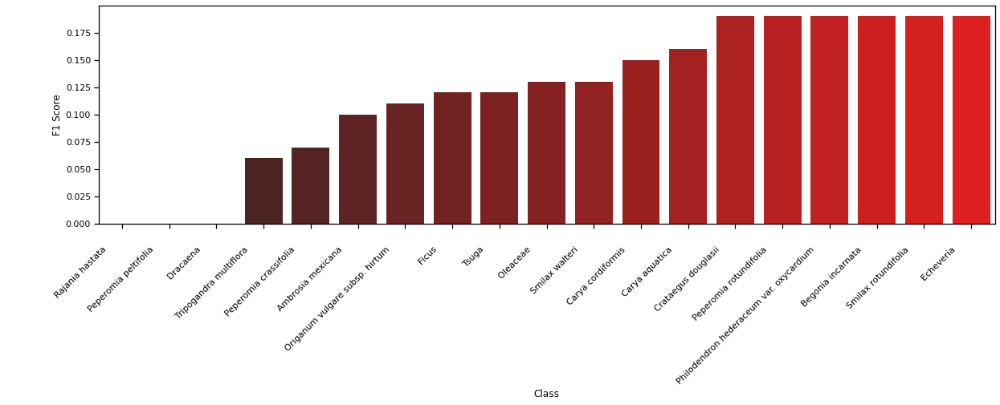

In [27]:
import seaborn as sns
sns.set_context("notebook")
ordered_fscore = class_report[class_report['F1 Score']<0.2].sort_values('F1 Score')
fig, ax = plt.subplots(figsize=(20,5))
sequential_colors = sns.dark_palette('red', len(ordered_fscore))
chart = sns.barplot(ax=ax, x=ordered_fscore['Class'], y=ordered_fscore['F1 Score'], palette = sequential_colors);
chart.set_xticklabels(chart.get_xticklabels(), rotation=45, horizontalalignment='right');
print(f'There are {len(ordered_fscore)} classes with F1 scores below 0.20')


There are 62 classes with F1 scores more than 0.80


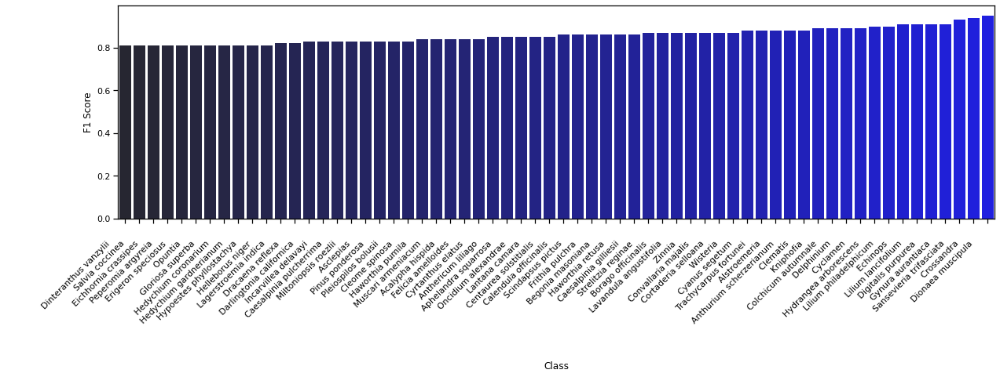

In [28]:
import seaborn as sns
ordered_fscore = class_report[class_report['F1 Score']>0.8].sort_values('F1 Score')
fig, ax = plt.subplots(figsize=(20,5))
sequential_colors = sns.dark_palette('blue', len(ordered_fscore))
chart = sns.barplot(ax=ax, x=ordered_fscore['Class'], y=ordered_fscore['F1 Score'], palette = sequential_colors);
chart.set_xticklabels(chart.get_xticklabels(), rotation=45, horizontalalignment='right');
print(f'There are {len(ordered_fscore)} classes with F1 scores more than 0.80')

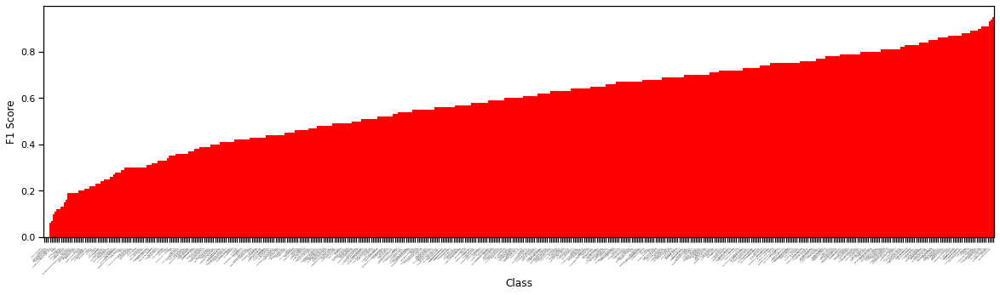

In [26]:
import seaborn as sns
sns.set_palette("dark")
ordered_fscore = class_report[class_report['F1 Score']>=0].sort_values('F1 Score')
fig, ax = plt.subplots(figsize=(20,5))
sequential_colors = sns.dark_palette('blue', len(ordered_fscore))
chart = sns.barplot(ax=ax, x=ordered_fscore['Class'], y=ordered_fscore['F1 Score']);
chart.set_xticklabels(chart.get_xticklabels(), rotation=45, horizontalalignment='right', fontsize=2);
for i, bar in enumerate(ax.patches):
    bar.set_color("red")
    
plt.savefig('all.png', dpi=1200)

In [ ]:
# This will crash the kernel
#interp.plot_confusion_matrix()

In [ ]:
# This will often crash the kernel
# What classes were confused with each other most frequently, min_val is the minimum number of times confused
# If the model fails to predict a class, this method will throw an error.
  # This can happen if you create a dataloader with insufficient data, or if significant class confusion (e.g. due to mislabelling)
interp.most_confused(min_val = 20)

# (Manual Cleaning) Train Model

## Train Model - Artificial and Manual Clean 2

Further manual cleaning will improve the model results. 
This removes obviously misclassified or useless images. 

In [ ]:
# Get and unzip the automatically cleaned images
!cp '/content/drive/My Drive/Houseplant Classifier/plant_images_database_manualcleanedlosses2.zip' 'plant_images_database_manualcleanedlosses2.zip'
# This code snippet unzips a zip file to a specified destination
!unzip "/content/plant_images_database_manualcleanedlosses2.zip" -d "/content";

In [ ]:
learn = create_cnn_learner(pct_images=1, 
                           deterministic=True, 
                           size=224, 
                           img_path ='/content/plant_images_database_manualcleanedlosses2/',
                           split_path = '/content/plant_image_database/')

Random state set:101, cuda used: True
Split Path defined, preparing pseudo stratified split.
Creating path:label dataframe from /content/plant_image_database/, using 100.00% of the images (77700 images.) Shuffle = False.
Preparing stratified 5 fold split, random state is 101. Returning fold 0.
Creating path:label dataframe from /content/plant_images_database_manualcleanedlosses2/, using 100.00% of the images (70210 images.) Shuffle = False.
We have 517 classes, with a training set of size 56187, and a validation set of size 14023
The main split has 80.00% training data with 518 classes, the reduced split has 80.03 % training data, with 517 classes.


In [ ]:
def baseline_fit(learn):
  print(f'Freezing model body')
  learn.freeze()
  enumerate_params(learn)
  learn.fit_one_cycle(10, 1e-02)
  learn.save('stage-1-manualcleanedlosses2')
  print(f'Unfreezing model body')
  learn.unfreeze()
  enumerate_params(learn)
  learn.fit_one_cycle(10, lr_max=slice(1e-5, 1e-4))
  learn.save('stage-2-manualcleanedlosses2')

Freezing model body
22,076,736 total parameters.
809,088 training parameters.


epoch,train_loss,valid_loss,accuracy,top_k_accuracy,time
0,4.026055,3.373182,0.286743,0.549169,04:12
1,3.611619,3.406957,0.280682,0.537617,04:09
2,3.327159,3.011239,0.342651,0.609641,04:06
3,3.065496,2.751984,0.393710,0.657919,04:01
4,2.903092,2.496870,0.435998,0.703416,03:59
5,2.650353,2.295778,0.476788,0.740783,03:57
6,2.429721,2.109041,0.520645,0.767168,03:58
7,2.259446,2.015200,0.532696,0.779505,03:58
8,2.093792,1.951627,0.547386,0.786565,03:56
9,2.007404,1.940921,0.551380,0.788847,03:55


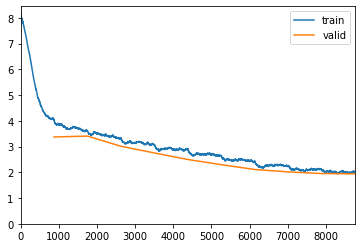

Unfreezing model body
22,076,736 total parameters.
22,076,736 training parameters.


epoch,train_loss,valid_loss,accuracy,top_k_accuracy,time
0,2.037295,1.926318,0.552022,0.791058,04:02
1,1.999933,1.918904,0.553804,0.795621,04:03
2,1.946936,1.872924,0.565999,0.800685,04:04
3,1.889844,1.814432,0.575911,0.808743,04:04
4,1.785066,1.773432,0.583613,0.813806,04:03
5,1.701807,1.741004,0.591386,0.818441,04:06
6,1.660782,1.717789,0.592812,0.824431,04:14
7,1.597394,1.698438,0.598945,0.827783,04:16
8,1.506019,1.688919,0.599800,0.828995,04:15
9,1.521411,1.686380,0.600870,0.829494,04:20


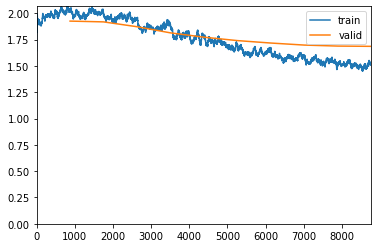

In [ ]:
baseline_fit(learn)

## Train Model - Artificial and Manual Clean 4

In [ ]:
# Get and unzip the automatically cleaned images
!cp '/content/drive/My Drive/Houseplant Classifier/plant_images_database_manualcleanedlosses4.zip' 'plant_images_database_manualcleanedlosses4.zip'
# This code snippet unzips a zip file to a specified destination
!unzip "/content/plant_images_database_manualcleanedlosses4.zip" -d "/content";

In [ ]:
learn = create_cnn_learner(pct_images=1, 
                           deterministic=True, 
                           size=224, 
                           img_path ='/content/plant_images_database_manualcleanedlosses4/',
                           split_path = '/content/plant_image_database/')

Random state set:101, cuda used: True
Split Path defined, preparing pseudo stratified split.
Creating path:label dataframe from /content/plant_image_database/, using 100.00% of the images (77700 images.) Shuffle = False.
Preparing stratified 5 fold split, random state is 101. Returning fold 0.
Creating path:label dataframe from /content/plant_images_database_manualcleanedlosses4/, using 100.00% of the images (69931 images.) Shuffle = False.
We have 517 classes, with a training set of size 55991, and a validation set of size 13940
The main split has 80.00% training data with 518 classes, the reduced split has 80.07 % training data, with 517 classes.


In [ ]:
def baseline_fit(learn):
  print(f'Freezing model body')
  learn.freeze()
  enumerate_params(learn)
  learn.fit_one_cycle(10, 1e-02)
  learn.save('stage-1-manualcleanedlosses4')
  print(f'Unfreezing model body')
  learn.unfreeze()
  enumerate_params(learn)
  learn.fit_one_cycle(10, lr_max=slice(1e-5, 1e-4))
  learn.save('stage-2-manualcleanedlosses4')

Freezing model body
22,076,736 total parameters.
809,088 training parameters.


epoch,train_loss,valid_loss,accuracy,top_k_accuracy,time
0,4.036012,3.345243,0.293042,0.542539,04:20
1,3.596850,3.291972,0.292898,0.562052,04:20
2,3.362385,3.037410,0.337733,0.603730,04:19
3,3.094763,2.649229,0.404663,0.673099,04:21
4,2.834235,2.475049,0.441105,0.701578,04:15
5,2.609147,2.267970,0.479125,0.739957,04:10
6,2.435835,2.098447,0.512052,0.766356,04:08
7,2.191096,1.979218,0.538881,0.783070,04:08
8,2.078310,1.920188,0.550287,0.792181,04:11
9,1.986310,1.908537,0.552654,0.792826,04:13


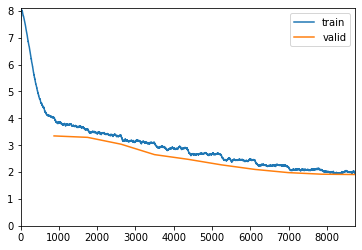

Unfreezing model body
22,076,736 total parameters.
22,076,736 training parameters.


epoch,train_loss,valid_loss,accuracy,top_k_accuracy,time
0,1.974239,1.895639,0.554232,0.797633,04:25
1,1.986597,1.881460,0.557604,0.797274,04:21
2,1.953630,1.823861,0.564491,0.806815,04:21
3,1.826664,1.803130,0.570373,0.810976,04:14
4,1.712195,1.751201,0.580129,0.818723,04:10
5,1.626427,1.714919,0.590531,0.827044,04:08
6,1.558323,1.688154,0.595481,0.826327,04:07
7,1.533838,1.667679,0.600000,0.828981,04:05
8,1.528843,1.661027,0.601650,0.830918,04:06
9,1.528209,1.662016,0.602009,0.831636,04:04


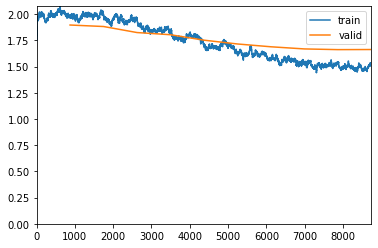

In [ ]:
baseline_fit(learn)

## Train Model - Artificial and Manual Clean 6


In [ ]:
# Get and unzip the automatically cleaned images
!cp '/content/drive/My Drive/Houseplant Classifier/plant_images_database_manualcleanedlosses6.zip' 'plant_images_database_manualcleanedlosses6.zip'
# This code snippet unzips a zip file to a specified destination
!unzip "/content/plant_images_database_manualcleanedlosses6.zip" -d "/content";

In [ ]:
learn = create_cnn_learner(pct_images=1, 
                           deterministic=True, 
                           size=224, 
                           img_path ='/content/plant_images_database_manualcleanedlosses6/',
                           split_path = '/content/plant_image_database/')

Random state set:101, cuda used: True
Split Path defined, preparing pseudo stratified split.
Creating path:label dataframe from /content/plant_image_database/, using 100.00% of the images (77700 images.) Shuffle = False.
Preparing stratified 5 fold split, random state is 101. Returning fold 0.
Creating path:label dataframe from /content/plant_images_database_manualcleanedlosses6/, using 100.00% of the images (69603 images.) Shuffle = False.
We have 517 classes, with a training set of size 55756, and a validation set of size 13847
The main split has 80.00% training data with 518 classes, the reduced split has 80.11 % training data, with 517 classes.


Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /root/.cache/torch/hub/checkpoints/resnet34-333f7ec4.pth


In [ ]:
def baseline_fit(learn):
  print(f'Freezing model body')
  learn.freeze()
  enumerate_params(learn)
  learn.fit_one_cycle(10, 1e-02)
  learn.save('stage-1-manualcleanedlosses6')
  print(f'Unfreezing model body')
  learn.unfreeze()
  enumerate_params(learn)
  learn.fit_one_cycle(10, lr_max=slice(1e-5, 1e-4))
  learn.save('stage-2-manualcleanedlosses6')

Freezing model body
22,076,736 total parameters.
809,088 training parameters.


epoch,train_loss,valid_loss,accuracy,top_k_accuracy,time
0,3.987871,3.369848,0.289305,0.545533,04:21
1,3.589658,3.192003,0.299054,0.571821,04:15
2,3.341056,3.033460,0.336029,0.599624,04:17
3,3.077536,2.658723,0.404420,0.671481,04:15
4,2.782145,2.413351,0.443345,0.714379,04:07
5,2.600695,2.220211,0.478226,0.745721,04:06
6,2.409856,2.050357,0.520040,0.769120,04:07
7,2.167060,1.935085,0.543295,0.789268,04:12
8,2.061061,1.883325,0.553694,0.797501,04:10
9,1.999448,1.870822,0.556655,0.798151,04:07


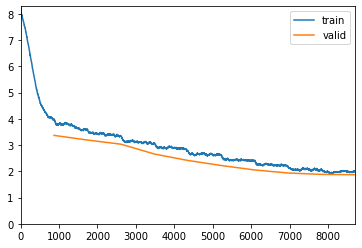

Unfreezing model body
22,076,736 total parameters.
22,076,736 training parameters.


epoch,train_loss,valid_loss,accuracy,top_k_accuracy,time
0,2.000196,1.859387,0.558460,0.799596,04:20
1,1.955445,1.836876,0.567126,0.803062,04:21
2,1.920209,1.792345,0.572543,0.811006,04:20
3,1.833383,1.748010,0.579692,0.816206,04:24
4,1.694593,1.703926,0.587636,0.823789,04:27
5,1.667950,1.677120,0.591825,0.827977,04:26
6,1.609368,1.645813,0.599191,0.831805,04:26
7,1.510118,1.628198,0.603308,0.834188,04:28
8,1.533763,1.616975,0.607280,0.835560,04:25
9,1.466995,1.615100,0.606557,0.837077,04:26


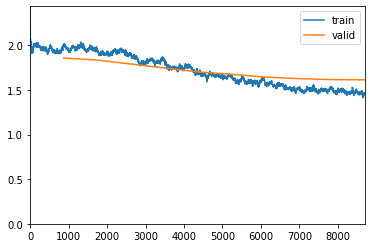

In [ ]:
baseline_fit(learn)

## Train Model - Artificial and Manual Clean 8

In [ ]:
# Get and unzip the automatically cleaned images
!cp '/content/drive/My Drive/Houseplant Classifier/plant_images_database_manualcleanedlosses8.zip' 'plant_images_database_manualcleanedlosses8.zip'
# This code snippet unzips a zip file to a specified destination
!unzip "/content/plant_images_database_manualcleanedlosses8.zip" -d "/content";

In [ ]:
learn = create_cnn_learner(pct_images=1, 
                           deterministic=True, 
                           size=224, 
                           img_path ='/content/plant_images_database_manualcleanedlosses8/',
                           split_path = '/content/plant_image_database/')

Random state set:101, cuda used: True
Split Path defined, preparing pseudo stratified split.
Creating path:label dataframe from /content/plant_image_database/, using 100.00% of the images (77700 images.) Shuffle = False.
Preparing stratified 5 fold split, random state is 101. Returning fold 0.
Creating path:label dataframe from /content/plant_images_database_manualcleanedlosses8/, using 100.00% of the images (69326 images.) Shuffle = False.
We have 517 classes, with a training set of size 55564, and a validation set of size 13762
The main split has 80.00% training data with 518 classes, the reduced split has 80.15 % training data, with 517 classes.


In [ ]:
def baseline_fit(learn):
  print(f'Freezing model body')
  learn.freeze()
  enumerate_params(learn)
  learn.fit_one_cycle(10, 1e-02)
  learn.save('stage-1-manualcleanedlosses8')
  print(f'Unfreezing model body')
  learn.unfreeze()
  enumerate_params(learn)
  learn.fit_one_cycle(10, lr_max=slice(1e-5, 1e-4))
  learn.save('stage-2-manualcleanedlosses8')

Freezing model body
22,076,736 total parameters.
809,088 training parameters.


epoch,train_loss,valid_loss,accuracy,top_k_accuracy,time
0,3.951772,3.336933,0.286950,0.547595,04:19
1,3.583165,3.376127,0.276631,0.540910,04:21
2,3.264878,2.900957,0.351984,0.632321,04:22
3,3.037148,2.625173,0.404302,0.673376,04:23
4,2.828193,2.392529,0.445284,0.715884,04:22
5,2.601599,2.185130,0.491789,0.750109,04:16
6,2.389837,2.032205,0.522598,0.775687,04:20
7,2.168129,1.909225,0.544180,0.795669,04:24
8,2.072107,1.850870,0.557332,0.803590,04:28
9,1.998533,1.840993,0.558785,0.803154,04:26


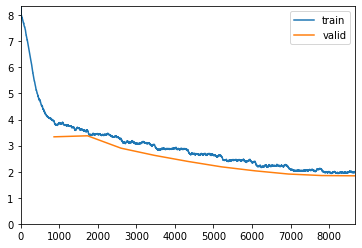

Unfreezing model body
22,076,736 total parameters.
22,076,736 training parameters.


epoch,train_loss,valid_loss,accuracy,top_k_accuracy,time
0,1.983170,1.824301,0.561764,0.806351,04:31
1,1.973816,1.806539,0.567141,0.807659,04:31
2,1.941580,1.767854,0.570847,0.812963,04:32
3,1.826840,1.712065,0.583345,0.821538,04:35
4,1.741341,1.668774,0.592719,0.829022,04:36
5,1.612502,1.635221,0.598387,0.831129,04:37
6,1.535726,1.607600,0.603328,0.836652,04:34
7,1.519574,1.593666,0.604563,0.839631,04:33
8,1.504851,1.582687,0.607688,0.840576,04:33
9,1.483206,1.585147,0.606017,0.840357,04:32


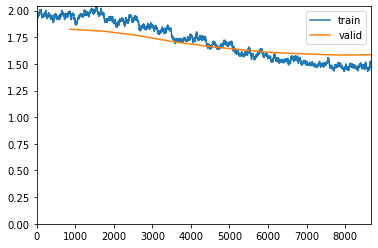

In [ ]:
baseline_fit(learn)

## Train Model - Artificial and Manual Clean 10

In [ ]:
learn = create_cnn_learner(pct_images=1, 
                           deterministic=True, 
                           size=224, 
                           img_path ='/content/plant_images_database_manualcleanedlosses10/',
                           split_path = '/content/plant_image_database/')

Random state set:101, cuda used: True
Split Path defined, preparing pseudo stratified split.
Creating path:label dataframe from /content/plant_image_database/, using 100.00% of the images (77700 images.) Shuffle = False.
Preparing stratified 5 fold split, random state is 101. Returning fold 0.
Creating path:label dataframe from /content/plant_images_database_manualcleanedlosses10/, using 100.00% of the images (68519 images.) Shuffle = False.
We have 517 classes, with a training set of size 54962, and a validation set of size 13557
The main split has 80.00% training data with 518 classes, the reduced split has 80.21 % training data, with 517 classes.


In [ ]:
def baseline_fit(learn):
  print(f'Freezing model body')
  learn.freeze()
  enumerate_params(learn)
  learn.fit_one_cycle(10, 1e-02)
  learn.save('stage-1-manualcleanedlosses10')
  print(f'Unfreezing model body')
  learn.unfreeze()
  enumerate_params(learn)
  learn.fit_one_cycle(10, lr_max=slice(1e-5, 1e-4))
  learn.save('stage-2-manualcleanedlosses10')

Freezing model body
22,076,736 total parameters.
809,088 training parameters.


epoch,train_loss,valid_loss,accuracy,top_k_accuracy,time
0,3.914296,3.239108,0.298075,0.568267,04:32
1,3.569604,3.176010,0.303681,0.575422,04:21
2,3.273059,2.877254,0.358265,0.631334,04:21
3,2.987981,2.572585,0.412628,0.679575,04:21
4,2.815928,2.323342,0.460943,0.728406,04:19
5,2.558580,2.164549,0.486612,0.755551,04:23
6,2.365153,1.987619,0.524895,0.780704,04:24
7,2.159635,1.859439,0.547319,0.797890,04:26
8,1.999158,1.799232,0.564948,0.806742,04:26
9,1.934553,1.787862,0.563620,0.807184,04:24


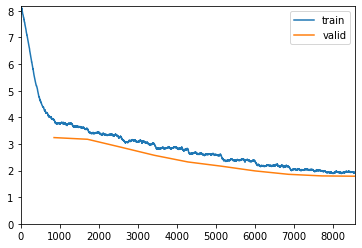

Unfreezing model body
22,076,736 total parameters.
22,076,736 training parameters.


epoch,train_loss,valid_loss,accuracy,top_k_accuracy,time
0,1.909827,1.777982,0.570111,0.809545,04:25
1,1.918491,1.762907,0.569743,0.813454,04:22
2,1.840726,1.704385,0.584200,0.821052,04:22
3,1.809839,1.663139,0.590322,0.828649,04:24
4,1.679505,1.619658,0.601903,0.835067,04:26
5,1.585200,1.574320,0.607140,0.842222,04:29
6,1.561981,1.558650,0.614443,0.844508,04:29
7,1.481416,1.540559,0.616139,0.846279,04:29
8,1.430968,1.532613,0.618795,0.845836,04:31
9,1.445145,1.529709,0.617910,0.845467,04:27


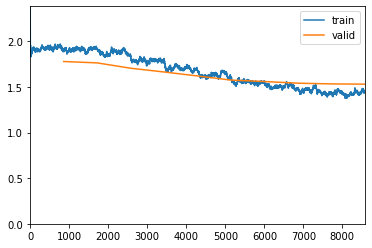

In [ ]:
baseline_fit(learn)

# Interpretation - Manual Clean

Let's re-create the learner and load in the results of training. 

In [12]:
learn = create_cnn_learner(pct_images=1, 
                           deterministic=True, 
                           size=224, 
                           img_path ='/content/plant_images_database_manualcleanedlosses10/',
                           split_path = '/content/plant_image_database/')

Random state set:101, cuda used: True
Split Path defined, preparing pseudo stratified split.
Creating path:label dataframe from /content/plant_image_database/, using 100.00% of the images (77700 images.) Shuffle = False.
Preparing stratified 5 fold split, random state is 101. Returning fold 0.
Creating path:label dataframe from /content/plant_images_database_manualcleanedlosses10/, using 100.00% of the images (68519 images.) Shuffle = False.
We have 517 classes, with a training set of size 54962, and a validation set of size 13557
The main split has 80.00% training data with 518 classes, the reduced split has 80.21 % training data, with 517 classes.


In [13]:
learn.load('/content/drive/My Drive/Houseplant Classifier/Models/stage-2-manualcleanedlosses10');

In [14]:
interp = ClassificationInterpretation.from_learner(learn)

A confusion matrix is of limited use with so many categories. Indeed, we will crash the kernel trying to plot out such a dense confusion matrix. Luckily, fast.ai has a useful plot_top_losses method that shows us some of the images that suprised the model the most (leading to the largest losses). 

In [ ]:
interp.plot_top_losses(8, figsize=(25,10))

We can see that many of these image labels are simply incorrect. 
A classification report detailing the F1 score for each class can help us identify classes that the model is struggling with. As fastai will print out the classification report, we should intercept this with a Jupyter magic command, and read that input back into a dataframe for interpretation.

In [15]:
# Use a jupyter magic command to capture the print output from the classification report
%%capture cap_out --no-stderr
interp.print_classification_report()

In [16]:
classification_report = cap_out.stdout

from itertools import groupby
class_report = pd.DataFrame([])
def split_text(s):
    for k, g in groupby(s, str.isnumeric):
        yield ''.join(g)

report = []
for item in classification_report.split('\n'):
  report.append(split_text(item))

report = pd.DataFrame(report).copy()
class_report = pd.DataFrame([])
class_report['Class'] = pd.DataFrame(report).iloc[2:learn.dl.c+2,0]
class_report['Precision'] = pd.DataFrame(report).iloc[2:learn.dl.c+2,3].apply(lambda x:int(x)/100)
class_report['Recall'] = pd.DataFrame(report).iloc[2:learn.dl.c+2,7].apply(lambda x:int(x)/100)
class_report['F1 Score'] = pd.DataFrame(report).iloc[2:learn.dl.c+2,11].apply(lambda x:int(x)/100)
class_report['Support'] = pd.DataFrame(report).iloc[2:learn.dl.c+2,13]

In [17]:
class_report.sort_values('F1 Score')

,Class,Precision,Recall,F1 Score,Support
190,Dracaena,0.00,0.00,0.00,18
504,Tripogandra multiflora,0.00,0.00,0.00,12
376,Peperomia peltifolia,0.00,0.00,0.00,20
506,Tsuga,0.06,0.04,0.05,25
229,Ficus,0.12,0.05,0.07,20
...,...,...,...,...,...
258,Helianthus angustifolius,0.84,0.00,0.92,27
67,Caesalpinia gilliesii,0.96,0.90,0.93,29
303,Lantana camara,0.00,0.87,0.93,30
130,Colchicum autumnale,0.96,0.93,0.94,27


With this, we can see at a glance which classes have the most problems being identified, and have a closer look at the images in their folders.

There are 14 classes with F1 scores below 0.20


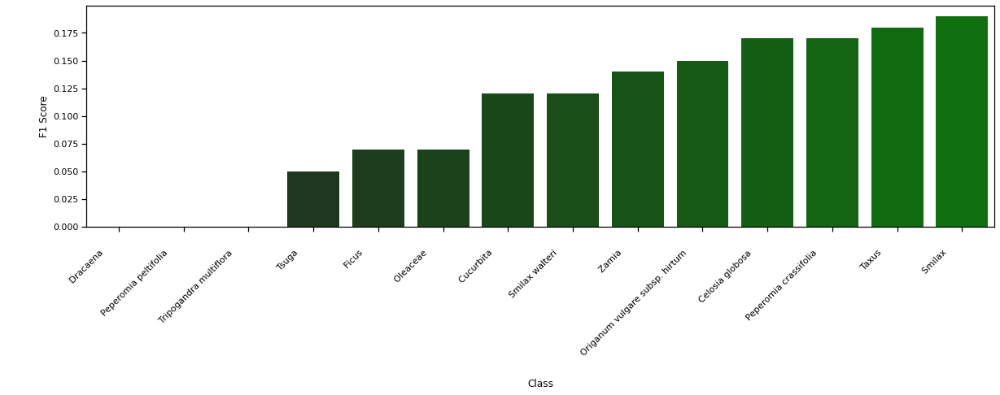

In [22]:
import seaborn as sns
sns.set_context("notebook")
ordered_fscore = class_report[class_report['F1 Score']<0.2].sort_values('F1 Score')
fig, ax = plt.subplots(figsize=(20,5))
sequential_colors = sns.dark_palette('green', len(ordered_fscore))
chart = sns.barplot(ax=ax, x=ordered_fscore['Class'], y=ordered_fscore['F1 Score'], palette = sequential_colors);
chart.set_xticklabels(chart.get_xticklabels(), rotation=45, horizontalalignment='right');
print(f'There are {len(ordered_fscore)} classes with F1 scores below 0.20')


There are 89 classes with F1 scores more than 0.80


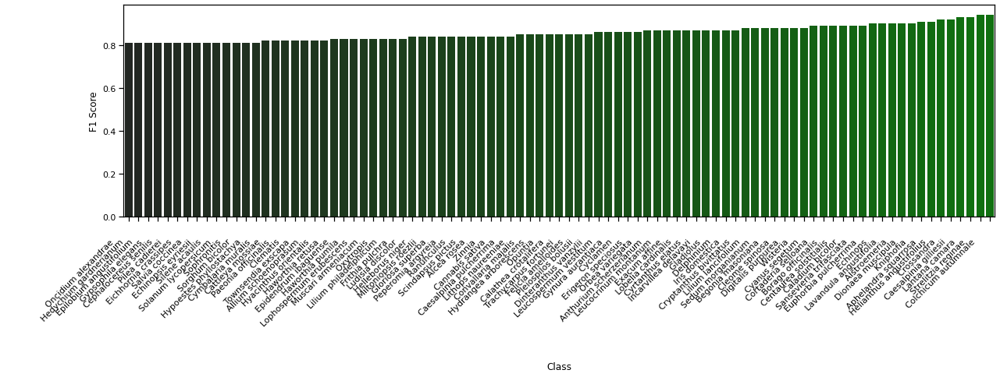

In [23]:
import seaborn as sns
ordered_fscore = class_report[class_report['F1 Score']>0.8].sort_values('F1 Score')
fig, ax = plt.subplots(figsize=(20,5))
sequential_colors = sns.dark_palette('green', len(ordered_fscore))
chart = sns.barplot(ax=ax, x=ordered_fscore['Class'], y=ordered_fscore['F1 Score'], palette = sequential_colors);
chart.set_xticklabels(chart.get_xticklabels(), rotation=45, horizontalalignment='right');
print(f'There are {len(ordered_fscore)} classes with F1 scores more than 0.80')

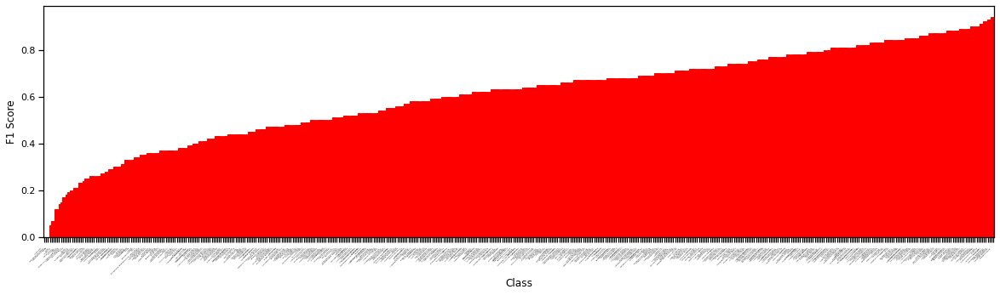

In [20]:
import seaborn as sns
sns.set_palette("dark")
ordered_fscore = class_report[class_report['F1 Score']>=0].sort_values('F1 Score')
fig, ax = plt.subplots(figsize=(20,5))
sequential_colors = sns.dark_palette('blue', len(ordered_fscore))
chart = sns.barplot(ax=ax, x=ordered_fscore['Class'], y=ordered_fscore['F1 Score']);
chart.set_xticklabels(chart.get_xticklabels(), rotation=45, horizontalalignment='right', fontsize=2);
for i, bar in enumerate(ax.patches):
    bar.set_color("red")
    
plt.savefig('all.png', dpi=1200)

In [21]:
# This will crash the kernel
#interp.plot_confusion_matrix()

In [ ]:
# This will often crash the kernel
# What classes were confused with each other most frequently, min_val is the minimum number of times confused
# If the model fails to predict a class, this method will throw an error.
  # This can happen if you create a dataloader with insufficient data, or if significant class confusion (e.g. due to mislabelling)
interp.most_confused(min_val = 20)